# Importar as bibliotecas

In [1]:
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestRegressor
import optuna
from optuna.samplers import TPESampler
import numpy as np
import pandas as pd
import sklearn
import matplotlib.pyplot as plt
from sklearn.metrics import mean_squared_error as mse
import hydroeval as he
import xgboost as xgb
import seaborn

/Users/fernandosaraiva/anaconda3/envs/tamanduatei/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
# Parâmetros para reprodutibilidade
np.random.seed(42)

# Obtenção dos Dados

In [3]:
df_2018 = pd.read_csv ('data/series_temporais_tratadas_2018.csv').drop(['Unnamed: 0'],axis=1)
df_2019 = pd.read_csv ('data/series_temporais_tratadas_2019.csv').drop(['Unnamed: 0'],axis=1)
df_2020 = pd.read_csv ('data/series_temporais_tratadas_2020.csv').drop(['Unnamed: 0'],axis=1)
df_2021 = pd.read_csv ('data/series_temporais_tratadas_2021.csv').drop(['Unnamed: 0'],axis=1)
df_2022 = pd.read_csv ('data/series_temporais_tratadas_2022.csv').drop(['Unnamed: 0'],axis=1)
df_2023 = pd.read_csv ('data/series_temporais_tratadas_2023.csv').drop(['Unnamed: 0'],axis=1)

# Funções auxiliares

## Objective function of Random Forest for Optuna

In [6]:
#Define an objective function to be minimized
def objective(trial):
  # Setup values for the hyperparameters:
  n_estimators = trial.suggest_int("n_estimators", low = 50, high = 200, step = 50)
  max_depth = trial.suggest_int("max_depth", low = 2, high = 20, step = 1)
  min_samples_split = trial.suggest_int("min_samples_split", low = 2, high = 20, step = 1)
  min_samples_leaf = trial.suggest_int("min_samples_leaf", low = 2, high = 20, step = 1)

  regressor = RandomForestRegressor(n_jobs=-1,verbose=0,max_depth=max_depth, n_estimators=n_estimators,min_samples_split=min_samples_split,min_samples_leaf = min_samples_leaf, random_state = 42)

  #Scoring method:
  regressor.fit(X_train, y_train)
  from sklearn.metrics import mean_squared_error as mse
  # getting forecasts for the test set
  predictions = regressor.predict(X_val)
  # computing MSE error
  mse = mse(predictions, y_val)
  rmse = np.sqrt(mse)
  score = rmse
  return score

def run_optuna(n_trials=50):
  # Run Optuna
  sampler = TPESampler(seed=10)  # Make the sampler behave in a deterministic way.
  study = optuna.create_study(direction="minimize",sampler=sampler)
  #optuna.logging.set_verbosity(optuna.logging.INFO)
  optuna.logging.set_verbosity(optuna.logging.WARNING) #essa linha suprime o print das infos
  study.optimize(objective, n_trials=n_trials)
  trial = study.best_trial
  #print('RMSE: {}'.format(trial.value))
  #print("Best hyperparameters: {}".format(trial.params))
  #optuna.visualization.plot_optimization_history(study)
  #optuna.visualization.plot_slice(study)
  n_estimators = trial.params['n_estimators']
  max_depth = trial.params['max_depth']
  min_samples_split = trial.params['min_samples_split']
  min_samples_leaf = trial.params['min_samples_leaf']
  return trial, n_estimators, max_depth, min_samples_split, min_samples_leaf

## Objective Function of XGBoost for Optuna

In [7]:
#Define an objective function to be minimized
def objective_xgb(trial):
  # Setup values for the hyperparameters:
  # Adapted from https://practicaldatascience.co.uk/machine-learning/how-to-use-optuna-for-xgboost-hyperparameter-tuning
  params = {
        'max_depth': trial.suggest_int('max_depth', 1, 9),
        'learning_rate': trial.suggest_float('learning_rate', 0.01, 1.0,log=True),
        'n_estimators': trial.suggest_int('n_estimators', 50, 500),
        'min_child_weight': trial.suggest_int('min_child_weight', 1, 10),
        'gamma': trial.suggest_float('gamma', 1e-8, 1.0,log=True),
        'subsample': trial.suggest_float('subsample', 0.01, 1.0,log=True),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.01, 1.0,log=True),
        'reg_alpha': trial.suggest_float('reg_alpha', 1e-8, 1.0,log=True),
        'reg_lambda': trial.suggest_float('reg_lambda', 1e-8, 1.0,log=True),
        'eval_metric': 'rmse'
    }

  regressor = xgb.XGBRegressor(objective = "reg:squarederror",random_state = 42,**params)
  regressor.fit(X_train, y_train)
  #Scoring method:
  from sklearn.metrics import mean_squared_error as mse
  # getting forecasts for the test set
  predictions = regressor.predict(X_val)
  # computing MSE error
  mse = mse(predictions, y_val)
  rmse = np.sqrt(mse)
  score = rmse
  return score

def run_optuna_xgb(n_trials=50):
  # Run Optuna
  sampler = TPESampler(seed=10)  # Make the sampler behave in a deterministic way.
  study = optuna.create_study(direction="minimize",sampler=sampler)
  optuna.logging.set_verbosity(optuna.logging.INFO)
  #optuna.logging.set_verbosity(optuna.logging.WARNING) #essa linha suprime o print das infos
  study.optimize(objective_xgb, n_trials=n_trials)
  trial = study.best_trial
  #print('RMSE: {}'.format(trial.value))
  #print("Best hyperparameters: {}".format(trial.params))
  #optuna.visualization.plot_optimization_history(study)
  #optuna.visualization.plot_slice(study)
  max_depth = trial.params['max_depth']
  learning_rate = trial.params['learning_rate']
  n_estimators = trial.params['n_estimators']
  min_child_weight = trial.params['min_child_weight']
  gamma = trial.params['gamma']
  subsample = trial.params['subsample']
  colsample_bytree = trial.params['colsample_bytree']
  reg_alpha = trial.params['reg_alpha']
  reg_lambda = trial.params['reg_lambda']
  return trial, max_depth, learning_rate , n_estimators, min_child_weight, gamma,subsample, colsample_bytree, reg_alpha, reg_lambda

## Fit e evaluate

In [8]:
def fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators=100, max_depth = None, min_samples_split = 2, min_samples_leaf =1, return_plot = 0):
  # Os argumentos acima definidos como padrão são os argumentos padrão do RandomForestRegressor do Scikitlearn
  rmse_train_list = []
  nse_train_list = []
  rmse_list = []
  nse_list = []
  for i in range(1):
    model = RandomForestRegressor(n_jobs=-1, verbose=0,n_estimators=n_estimators,max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf,random_state=42)  #n_jobs = -1 --> to use all processors to run jobs in parallel
    model.fit(X_train, y_train)
    from sklearn.metrics import mean_squared_error as mse
    predictions = model.predict(X_val)
    mse = mse(predictions, y_val)
    rmse_list.append(np.sqrt(mse))
    nse = he.evaluator(he.nse, predictions, y_val)
    nse_list.append(nse[0])
    from sklearn.metrics import mean_squared_error as mse
    predictions_train = model.predict(X_train)
    mse_train = mse(predictions_train, y_train)
    rmse_train_list.append(np.sqrt(mse_train))
    nse_train = he.evaluator(he.nse, predictions_train, y_train)
    nse_train_list.append(nse_train[0])

  #print(f"Lista de RMSE: {rmse_list}")
  #print(f"Lista de NSE: {nse_list}")
  print("The average of the root mean squared error (RMSE) on train set: {:.4f}".format(sum(rmse_train_list)/len(rmse_train_list)))
  print(f"The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: {sum(nse_train_list)/len(nse_train_list)}")

  print("The average of the root mean squared error (RMSE) on test set: {:.4f}".format(sum(rmse_list)/len(rmse_list)))
  print(f"The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: {sum(nse_list)/len(nse_list)}")

  plt.figure(figsize=(20, 10))
  plt.plot(predictions,color='orange',label='predicted')
  plt.plot(y_val,label='actual')
  plt.title(f'Actual and predicted river level at station 413 for the test set, NSE = {nse[0]}',fontsize=18)
  plt.ylabel('River level (cm)',fontsize=14)
  plt.xlabel('Time stamp',fontsize=14)
  plt.legend()
  plt.show()

  plt.figure(figsize=(6,6))
  plt.scatter(y_val, predictions, c='r',s=5)
  p1 = max(max(predictions), max(y_val))
  p2 = min(min(predictions), min(y_val))
  plt.plot([p1, p2], [p1, p2], 'b-')
  plt.xlabel('Actual', fontsize=15)
  plt.ylabel('Predicted', fontsize=15)
  plt.axis('equal')
  plt.show()

  importances = model.feature_importances_

  if(return_plot==0):
    return rmse_train_list, nse_train_list, rmse_list, nse_list, importances
  if(return_plot==1):
    return rmse_train_list, nse_train_list, rmse_list, nse_list, importances, y_val, predictions

In [9]:
def fit_and_evaluate_xgboost(X_train,y_train,X_val,y_val, X_test,y_test, max_depth = 6, learning_rate = 0.3, n_estimators = 100, min_child_weight = 1, gamma = 0,subsample = 1, colsample_bytree = 1, reg_alpha = 0, reg_lambda = 0, eval_metric = 'rmse', return_plot=0):
  # Os argumentos acima definidos como padrão são os argumentos padrão do RandomForestRegressor do Scikitlearn
  rmse_train_list = []
  nse_train_list = []
  rmse_list = []
  nse_list = []
  for i in range(1):
    model = xgb.XGBRegressor(objective="reg:squarederror",random_state=42, max_depth = max_depth, learning_rate = learning_rate, n_estimators = n_estimators, min_child_weight = min_child_weight, gamma = gamma,subsample = subsample, colsample_bytree = colsample_bytree, reg_alpha = reg_alpha, reg_lambda = reg_lambda, eval_metric = eval_metric)
    model.fit(X_train, y_train)
    from sklearn.metrics import mean_squared_error as mse
    predictions = model.predict(X_val)
    mse = mse(predictions, y_val)
    rmse_list.append(np.sqrt(mse))
    nse = he.evaluator(he.nse, predictions, y_val)
    nse_list.append(nse[0])
    from sklearn.metrics import mean_squared_error as mse
    predictions_train = model.predict(X_train)
    mse_train = mse(predictions_train, y_train)
    rmse_train_list.append(np.sqrt(mse_train))
    nse_train = he.evaluator(he.nse, predictions_train, y_train)
    nse_train_list.append(nse_train[0])

  #print(f"Lista de RMSE: {rmse_list}")
  #print(f"Lista de NSE: {nse_list}")
  print("The average of the root mean squared error (RMSE) on train set: {:.4f}".format(sum(rmse_train_list)/len(rmse_train_list)))
  print(f"The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: {sum(nse_train_list)/len(nse_train_list)}")

  print("The average of the root mean squared error (RMSE) on test set: {:.4f}".format(sum(rmse_list)/len(rmse_list)))
  print(f"The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: {sum(nse_list)/len(nse_list)}")

  plt.figure(figsize=(20, 10))
  plt.plot(predictions,color='orange',label='predicted')
  plt.plot(y_val,label='actual')
  plt.title(f'Actual and predicted river level at station 413 from Jan/20 to Mar/20, NSE = {nse[0]}',fontsize=18)
  plt.ylabel('River level (cm)',fontsize=14)
  plt.xlabel('Time stamp',fontsize=14)
  plt.legend()
  plt.show()

  plt.figure(figsize=(6,6))
  plt.scatter(y_val, predictions, c='r',s=5)
  p1 = max(max(predictions), max(y_val))
  p2 = min(min(predictions), min(y_val))
  plt.plot([p1, p2], [p1, p2], 'b-')
  plt.xlabel('Actual', fontsize=15)
  plt.ylabel('Predicted', fontsize=15)
  plt.axis('equal')
  plt.show()

  importances = model.feature_importances_
  if(return_plot==0):
    return rmse_train_list, nse_train_list, rmse_list, nse_list, importances
  if(return_plot==1):
    return rmse_train_list, nse_train_list, rmse_list, nse_list, importances, y_val, predictions

## Time Delay Embedding

In [10]:
def time_delay_embedding(series: pd.Series, n_lags: int, horizon: int):
    """
    Time delay embedding
    Time series for supervised learning
    :param series: time series as pd.Series
    :param n_lags: number of past values to used as explanatory variables
    :param horizon: how many values to forecast
    :return: pd.DataFrame with reconstructed time series
    """
    assert isinstance(series, pd.Series)

    if series.name is None:
        name = 'Series'
    else:
        name = series.name

    n_lags_iter = list(range(n_lags, -horizon, -1))

    X = [series.shift(i) for i in n_lags_iter]
    X = pd.concat(X, axis=1).dropna()
    X.columns = [f'{name}(t-{j - 1})'
                 if j > 0 else f'{name}(t+{np.abs(j) + 1})'
                 for j in n_lags_iter]

    return X

## Preparação dos Conjuntos de Treinament/Validação/Teste

In [11]:
def preparar_dataframes(dataframes_treinamento, dataframes_validacao, dataframes_teste,horizon=12):
  # Conjunto de treinamento
  df_treinamento = pd.DataFrame()
  dataframes = dataframes_treinamento

  for df in dataframes:
    train = df
    train = train.set_index(['intervalo'])

    # create data set with lagged features using time delay embedding
    train_ds = []
    for col in train:
      col_df = time_delay_embedding(train[col], n_lags=12, horizon=horizon)
      train_ds.append(col_df)

    # Concatenating all variables
    train_df = pd.concat(train_ds, axis=1)

    df_treinamento = pd.concat([df_treinamento, train_df])
  train_df = df_treinamento

  # Conjunto de validação
  df_validacao = pd.DataFrame()
  dataframes = dataframes_validacao

  for df in dataframes:
    val = df
    val = val.set_index(['intervalo'])
    # create data set with lagged features using time delay embedding
    val_ds = []
    for col in val:
      col_df = time_delay_embedding(val[col], n_lags=12, horizon=horizon)
      val_ds.append(col_df)

    # Concatenating all variables
    val_df = pd.concat(val_ds, axis=1)

    df_validacao = pd.concat([df_validacao, val_df])
  val_df = df_validacao

  # Conjunto de teste
  test = df_2023
  test = test.set_index(['intervalo'])

  # create data set with lagged features using time delay embedding
  test_ds = []
  for col in test:
    col_df = time_delay_embedding(test[col], n_lags=12, horizon=horizon)
    test_ds.append(col_df)

  # Concatenating all variables
  test_df = pd.concat(test_ds, axis=1)

  return train_df, val_df, test_df

In [12]:
def gerar_conjuntos(train_df,val_df,test_df,horizon=12):
  # Treinamento - defining target (Y) and explanatory variables (X)
  predictor_variables = train_df.columns.str.contains('-')
  target_variables = train_df.columns.str.contains(f'valor_leitura_flu_413(t+{horizon}',regex=False)

  X_train = train_df.iloc[:, predictor_variables]
  y_train = train_df.iloc[:, target_variables]
  # Validação - defining target (Y) and explanatory variables (X)
  predictor_variables = val_df.columns.str.contains('-')
  target_variables = val_df.columns.str.contains(f'valor_leitura_flu_413(t+{horizon}',regex=False)

  X_val = val_df.iloc[:, predictor_variables]
  y_val = val_df.iloc[:, target_variables]
  # Teste - defining target (Y) and explanatory variables (X)
  predictor_variables = test_df.columns.str.contains('-')
  target_variables = train_df.columns.str.contains(f'valor_leitura_flu_413(t+{horizon}',regex=False)

  X_test = test_df.iloc[:, predictor_variables]
  y_test = test_df.iloc[:, target_variables]

  return X_train,y_train,X_val,y_val,X_test,y_test

# Parte 1: Experimentos Markovianos

## Experimentos Markovianos com Random Forest (Validando em 2020)

In [13]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023])
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df)

## Exp. 1: Só Pluviômetro Exutório

/Users/fernandosaraiva/anaconda3/envs/tamanduatei/lib/python3.10/site-packages/sklearn/base.py:1474: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


The average of the root mean squared error (RMSE) on train set: 84.8662
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.24714405548847573
The average of the root mean squared error (RMSE) on test set: 86.4769
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.28460549305181637


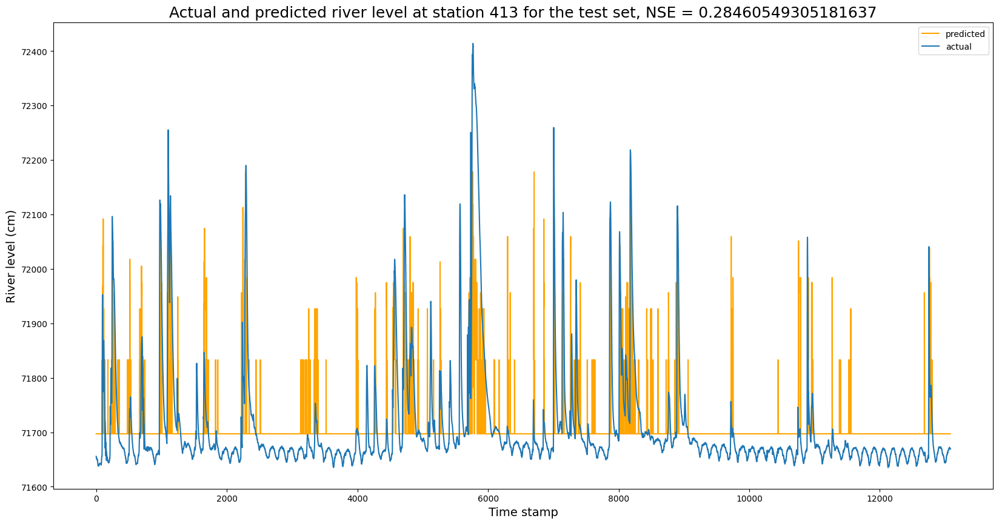

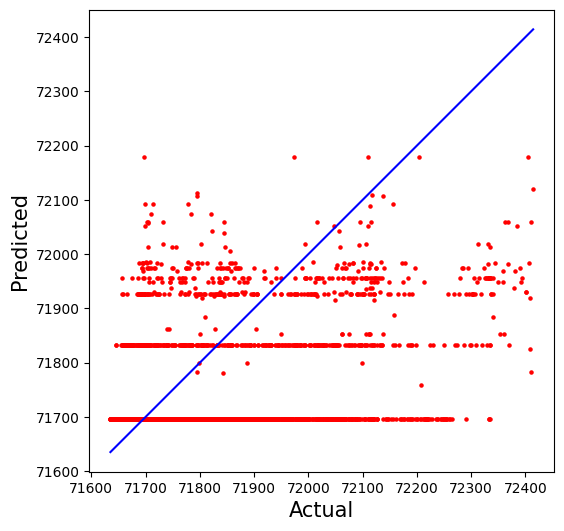

In [14]:
X_train = np.array(X_train_general['valor_leitura_plu_413(t-0)'])
X_val = np.array(X_val_general['valor_leitura_plu_413(t-0)'])
X_test = np.array(X_test_general['valor_leitura_plu_413(t-0)'])
y_train = np.array(y_train_general.values)
y_val = np.array(y_val_general.values)
y_test = np.array(y_test_general.values)

#Reshaping
X_train = X_train.reshape(-1,1)
X_val = X_val.reshape(-1,1)
X_test = X_test.reshape(-1,1)

rmse_train_list_1, nse_train_list_1, rmse_list_1, nse_list_1, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

## Exp. 2: Todos os pluviômetros da bacia

/Users/fernandosaraiva/anaconda3/envs/tamanduatei/lib/python3.10/site-packages/sklearn/base.py:1474: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


The average of the root mean squared error (RMSE) on train set: 61.5063
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.6045588741918467
The average of the root mean squared error (RMSE) on test set: 75.7579
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.45096366648169617


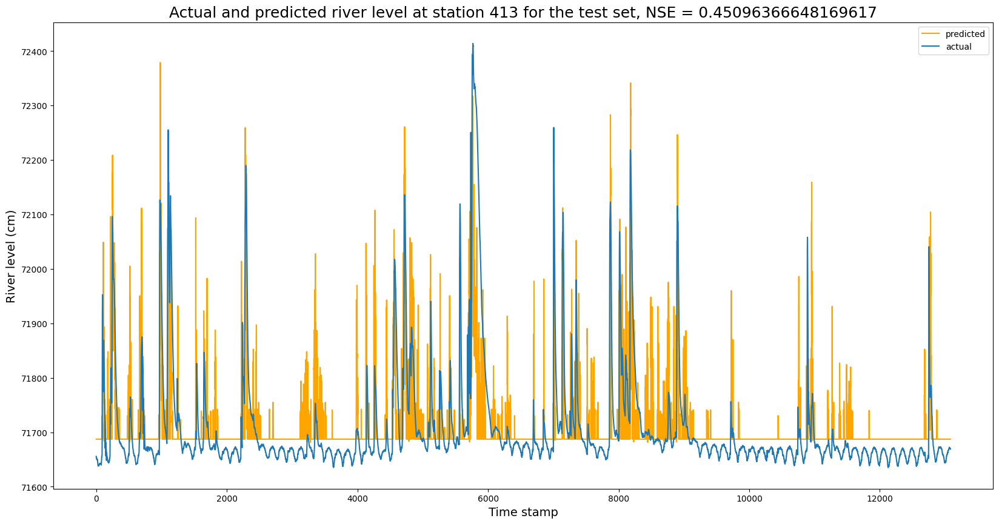

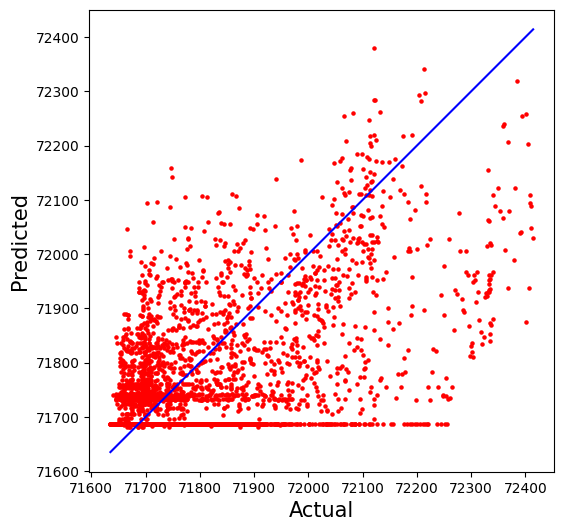

In [15]:
pluviometros = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    pluviometros.append(nome)

X_train = np.array(X_train_general[pluviometros])
X_val = np.array(X_val_general[pluviometros])
X_test = np.array(X_test_general[pluviometros])
y_train = np.array(y_train_general.values)
y_val = np.array(y_val_general.values)
y_test = np.array(y_test_general.values)

rmse_train_list_2, nse_train_list_2, rmse_list_2, nse_list_2, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

## Exp. 3: Nível no exutório

<ipython-input-10-cfe69e747f8f>:9: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().


The average of the root mean squared error (RMSE) on train set: 47.9020
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.7601444470525508
The average of the root mean squared error (RMSE) on test set: 59.1452
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.6653554828669572


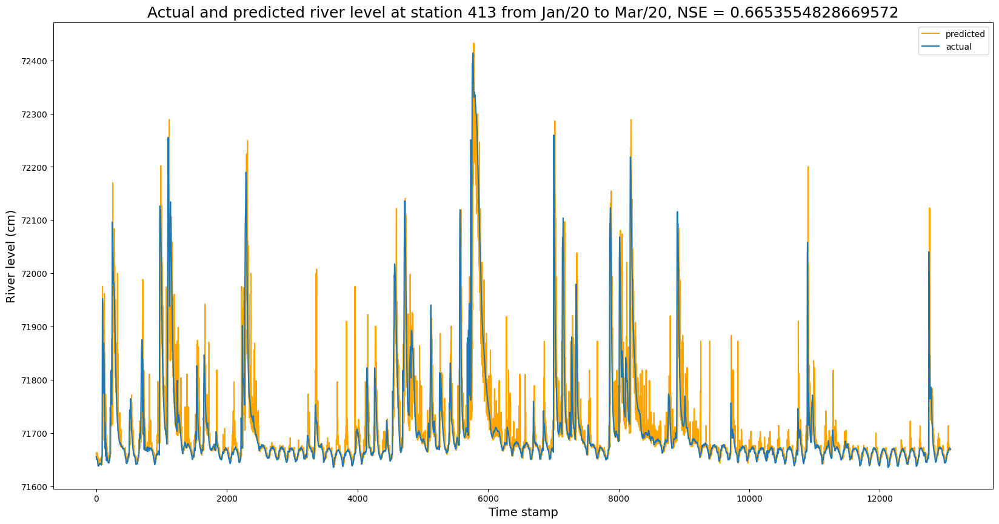

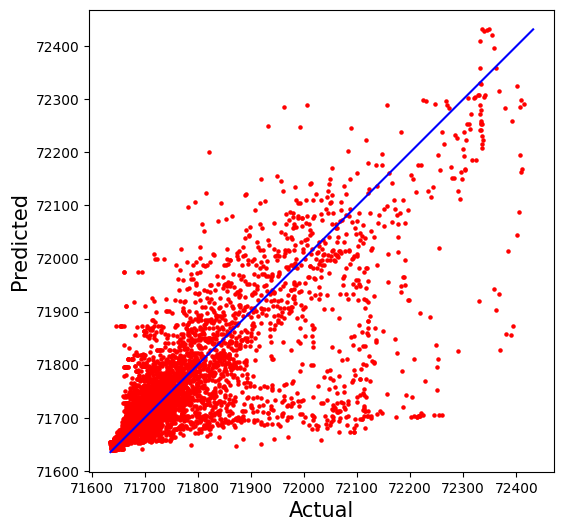

In [ ]:
X_train = np.array(X_train_general['valor_leitura_flu_413(t-0)'])
X_val = np.array(X_val_general['valor_leitura_flu_413(t-0)'])
X_test = np.array(X_test_general['valor_leitura_flu_413(t-0)'])
y_train = np.array(y_train_general.values)
y_val = np.array(y_val_general.values)
y_test = np.array(y_test_general.values)

#Reshaping
X_train = X_train.reshape(-1,1)
X_val = X_val.reshape(-1,1)
X_test = X_test.reshape(-1,1)

rmse_train_list_3, nse_train_list_3, rmse_list_3, nse_list_3, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

## Exp. 4: Nível no exutório e pluviômetro no exutório

<ipython-input-10-cfe69e747f8f>:9: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().


The average of the root mean squared error (RMSE) on train set: 40.3981
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.8294056878064218
The average of the root mean squared error (RMSE) on test set: 54.7457
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.7132887046649228


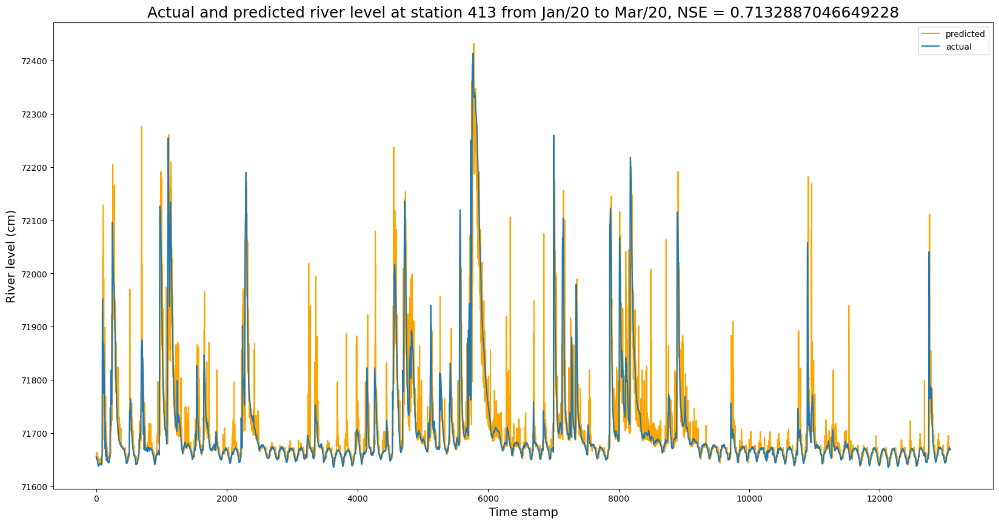

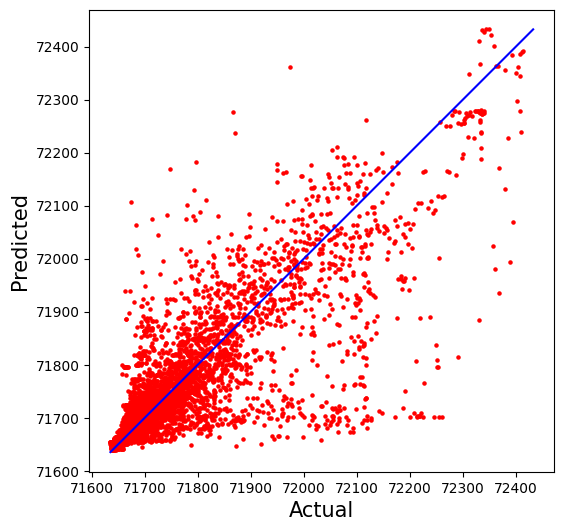

In [ ]:
X_train = np.array(X_train_general[['valor_leitura_flu_413(t-0)','valor_leitura_plu_413(t-0)']])
X_val = np.array(X_val_general[['valor_leitura_flu_413(t-0)','valor_leitura_plu_413(t-0)']])
X_test = np.array(X_test_general[['valor_leitura_flu_413(t-0)','valor_leitura_plu_413(t-0)']])
y_train = np.array(y_train_general.values)
y_val = np.array(y_val_general.values)
y_test = np.array(y_test_general.values)

rmse_train_list_4, nse_train_list_4, rmse_list_4, nse_list_4, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

## Exp. 5: Nível exutório e todos os pluviômetros da bacia

<ipython-input-10-cfe69e747f8f>:9: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().


The average of the root mean squared error (RMSE) on train set: 27.2275
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.922507900954279
The average of the root mean squared error (RMSE) on test set: 44.5921
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.809777693608101


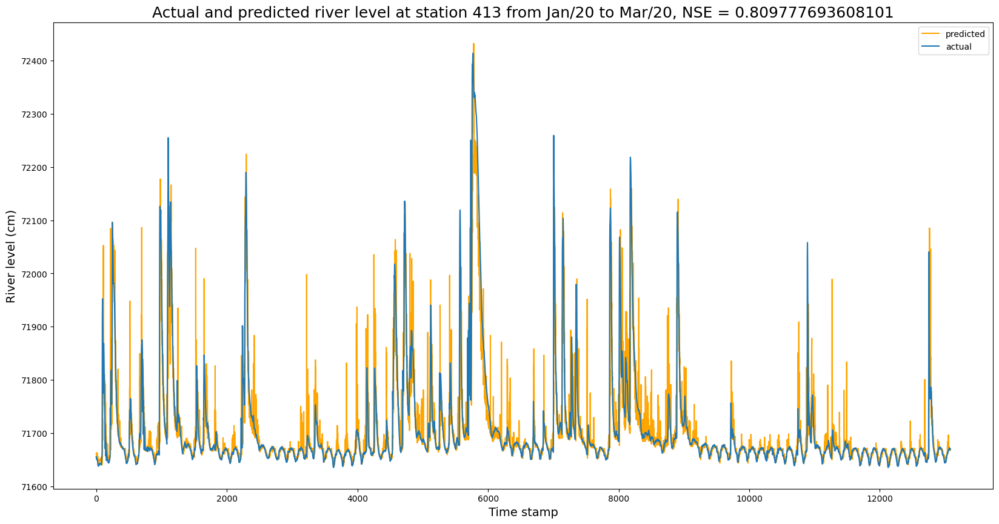

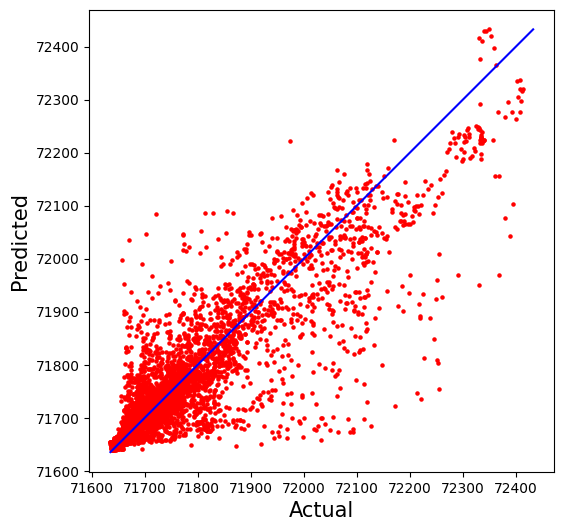

In [ ]:
entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)


X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values)
y_val = np.array(y_val_general.values)
y_test = np.array(y_test_general.values)

rmse_train_list_5, nse_train_list_5, rmse_list_5, nse_list_5, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

The average of the root mean squared error (RMSE) on train set: 29.3292
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.9100824940620669
The average of the root mean squared error (RMSE) on test set: 44.6211
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.8095300981414195


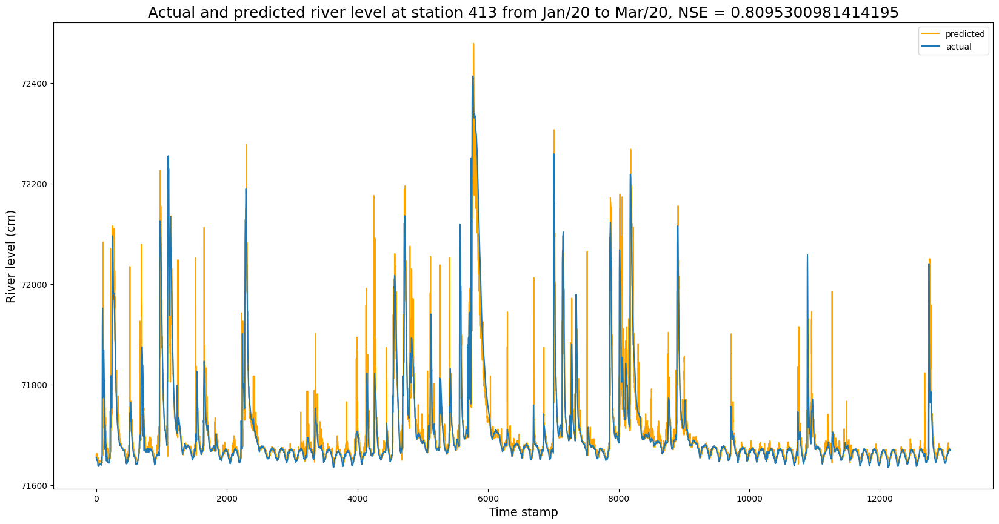

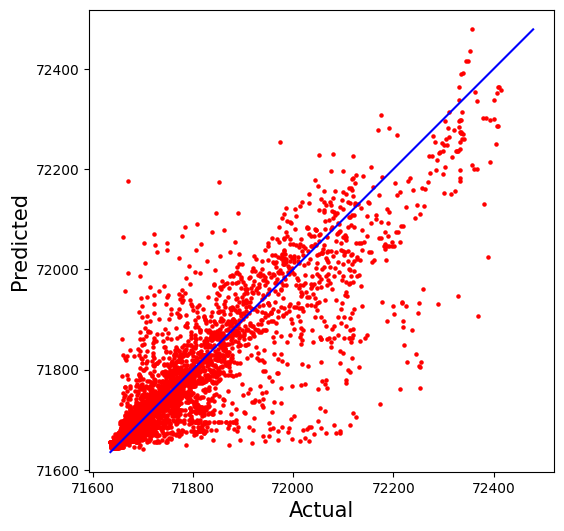

In [ ]:
# Bônus
# Testando XGBoost
#rmse_train_list_5, nse_train_list_5, rmse_list_5, nse_list_5, importances = fit_and_evaluate_xgboost(X_train,y_train,X_val,y_val, X_test,y_test)

## Exp. 6: Nível exutório e níveis a montante

<ipython-input-10-cfe69e747f8f>:9: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().


The average of the root mean squared error (RMSE) on train set: 12.5437
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.9835526613587422
The average of the root mean squared error (RMSE) on test set: 49.5497
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.7651304200029805


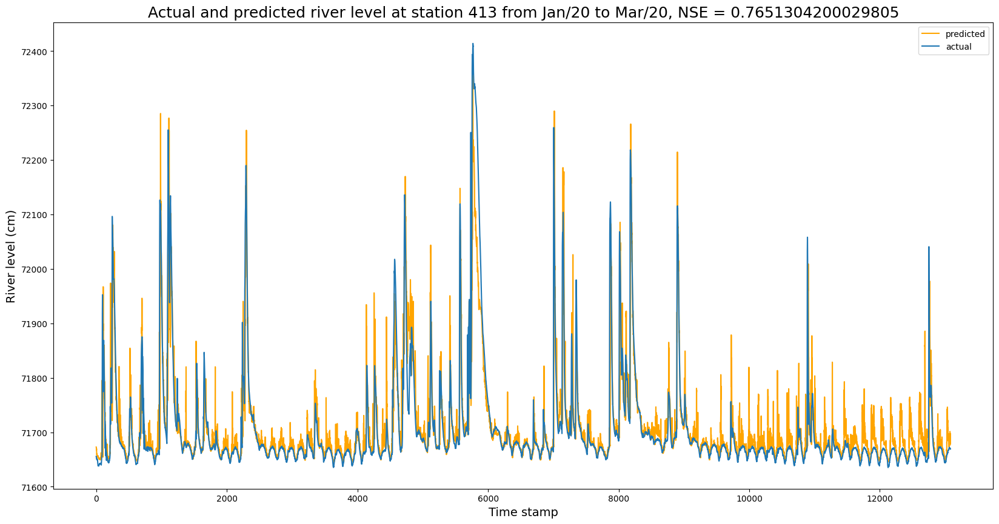

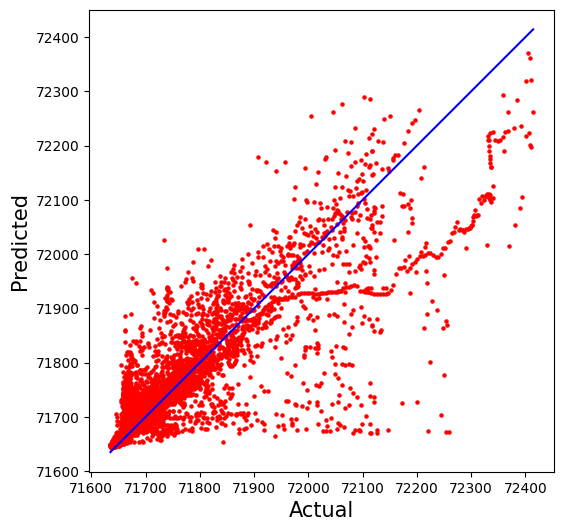

In [ ]:
entradas = []
for nome in X_train_general.columns:
  if ('flu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values)
y_val = np.array(y_val_general.values)
y_test = np.array(y_test_general.values)

rmse_train_list_6, nse_train_list_6, rmse_list_6, nse_list_6, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

## Exp. 7: Nível exutório, níveis a montante e todos os pluviômetros da bacia

<ipython-input-10-cfe69e747f8f>:9: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().


The average of the root mean squared error (RMSE) on train set: 11.3822
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.9864575926522943
The average of the root mean squared error (RMSE) on test set: 44.4575
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.8109246497157578


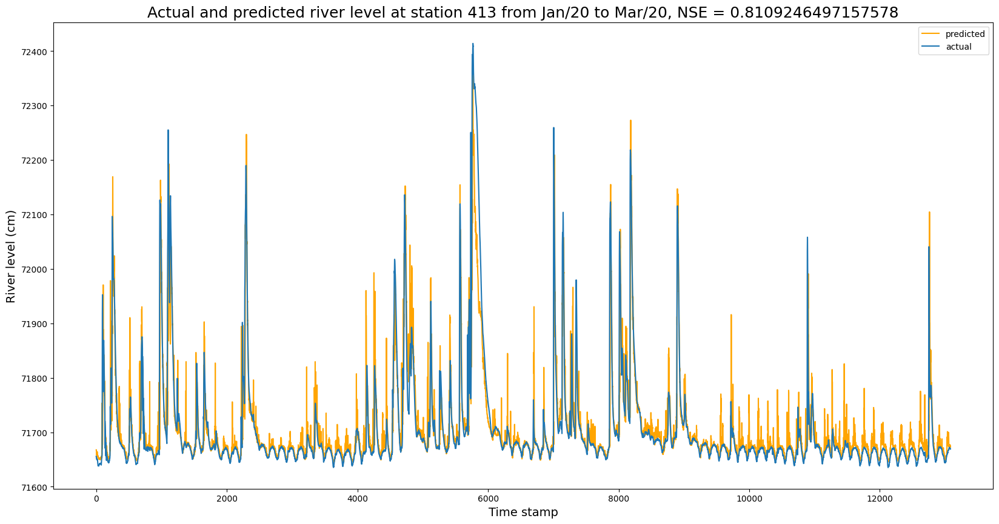

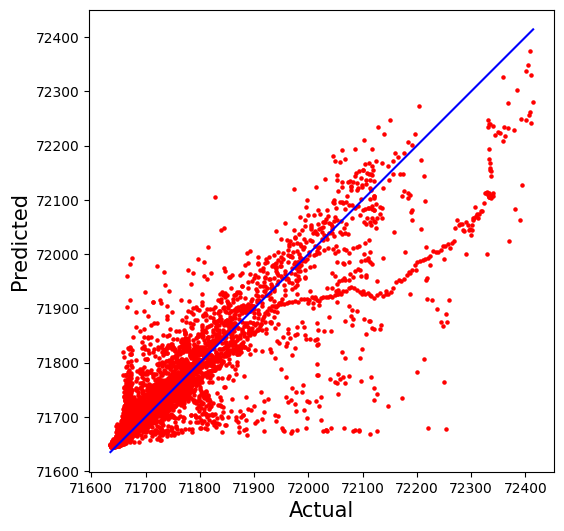

In [ ]:
entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values)
y_val = np.array(y_val_general.values)
y_test = np.array(y_test_general.values)

rmse_train_list_7, nse_train_list_7, rmse_list_7, nse_list_7, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

## Comparação de Performances

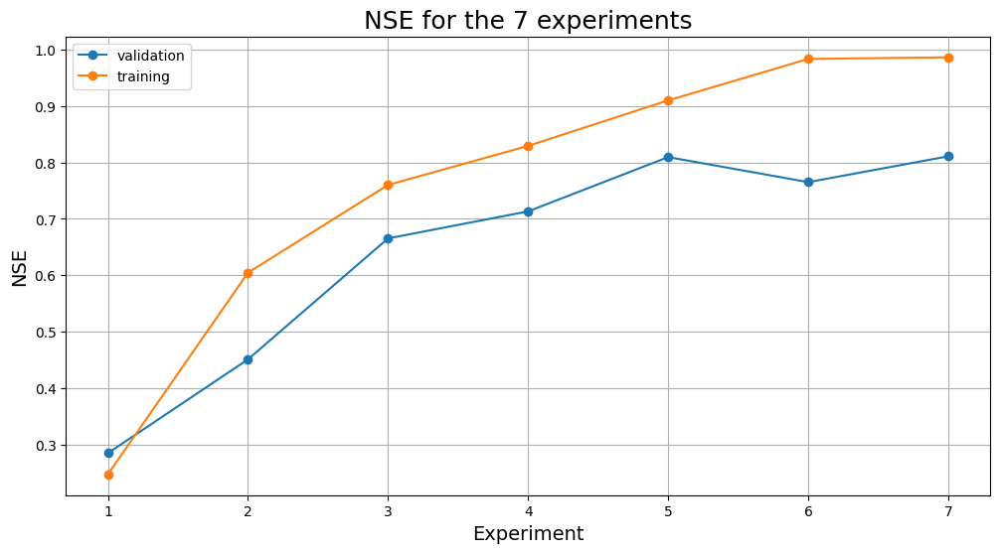

In [ ]:
plt.figure(figsize=(12, 6))
plt.plot([1,2,3,4,5,6,7], [nse_list_1,nse_list_2,nse_list_3,nse_list_4,nse_list_5,nse_list_6,nse_list_7], marker = 'o', label = 'validation')
plt.plot([1,2,3,4,5,6,7], [nse_train_list_1,nse_train_list_2,nse_train_list_3,nse_train_list_4,nse_train_list_5,nse_train_list_6,nse_train_list_7], marker = 'o', label = 'training')
plt.title(f'NSE for the 7 experiments',fontsize=18)
plt.ylabel('NSE',fontsize=14)
plt.xlabel('Experiment',fontsize=14)
plt.grid(linestyle='-')
#plt.xticks([0, 1, 2, 3, 4, 5, 6, 7], ['e1', 'e2', 'e3', 'e4','e5','e6','e7'],rotation=20)  # Set text labels and properties
plt.legend()
plt.show()

## Experimentos Markovianos com Random Forest Otimizados com Optuna (Validando em 2020)

## Exp.1: Pluviômetro exutório

In [ ]:
X_train = np.array(X_train_general['valor_leitura_plu_413(t-0)'])
X_val = np.array(X_val_general['valor_leitura_plu_413(t-0)'])
X_test = np.array(X_test_general['valor_leitura_plu_413(t-0)'])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

#Reshaping
X_train = X_train.reshape(-1,1)
X_val = X_val.reshape(-1,1)
X_test = X_test.reshape(-1,1)

[I 2023-08-15 02:56:51,236] A new study created in memory with name: no-name-1e002998-07e2-45a1-8962-d2ac598c9e1d


N_estimators: 150, max_depth: 4, min_samples_split: 9, min_samples_leaf: 14
The average of the root mean squared error (RMSE) on train set: 85.2570
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.24019526780484313
The average of the root mean squared error (RMSE) on test set: 85.7912
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.29590678377877655


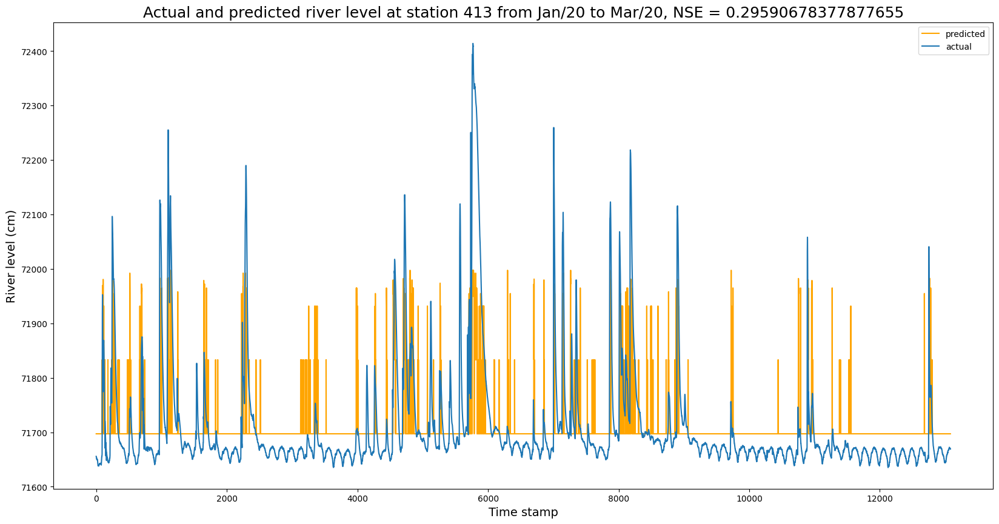

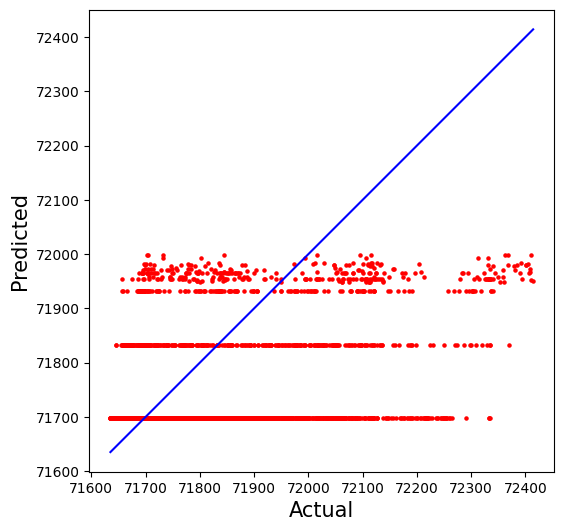

In [ ]:
# Otimizando com Optunas
trial, n_estimators_1, max_depth_1, min_samples_split_1, min_samples_leaf_1 = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators_1}, max_depth: {max_depth_1}, min_samples_split: {min_samples_split_1}, min_samples_leaf: {min_samples_leaf_1}")

The average of the root mean squared error (RMSE) on train set: 85.2570
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.24019526780484268
The average of the root mean squared error (RMSE) on test set: 85.7912
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.295906783778775


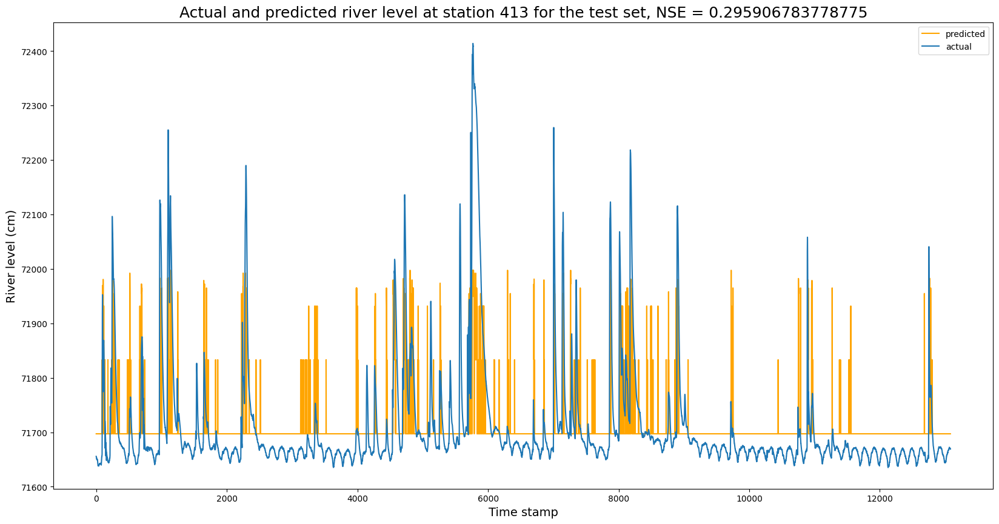

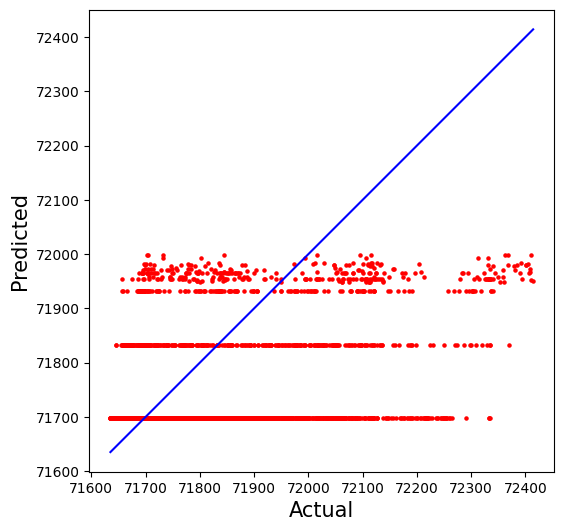

In [ ]:
n_estimators_1 = 150
max_depth_1 = 4
min_samples_split_1 = 9
min_samples_leaf_1 = 14
rmse_train_list_1_optuna, nse_train_list_1_optuna, rmse_list_1_optuna, nse_list_1_optuna, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators_1, max_depth = max_depth_1, min_samples_split = min_samples_split_1, min_samples_leaf = min_samples_leaf_1)

## Exp. 2: Todos os pluviômetros da bacia

In [ ]:
pluviometros = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    pluviometros.append(nome)

X_train = np.array(X_train_general[pluviometros])
X_val = np.array(X_val_general[pluviometros])
X_test = np.array(X_test_general[pluviometros])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()


N_estimators: 200, max_depth: 16, min_samples_split: 19, min_samples_leaf: 18
The average of the root mean squared error (RMSE) on train set: 70.4970
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.4805030414173319
The average of the root mean squared error (RMSE) on test set: 74.3710
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.47088223572915444


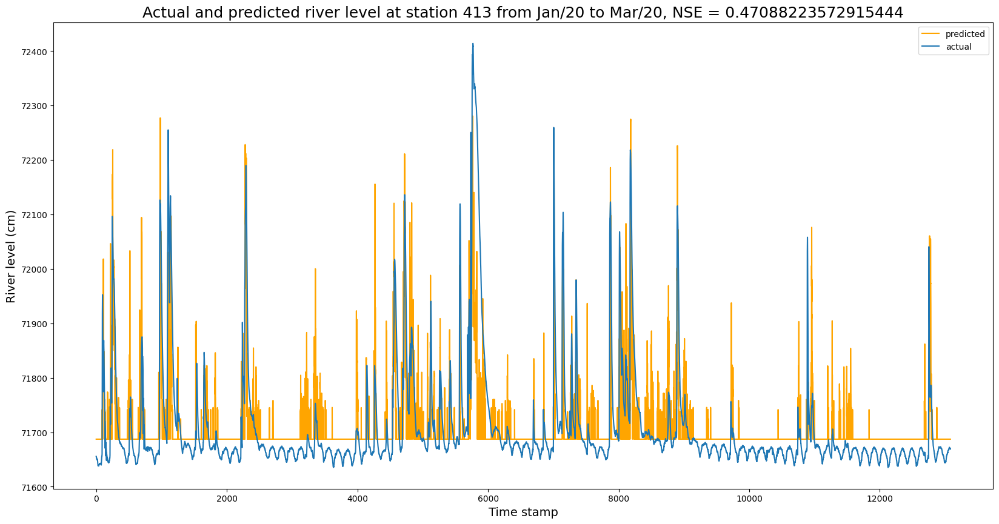

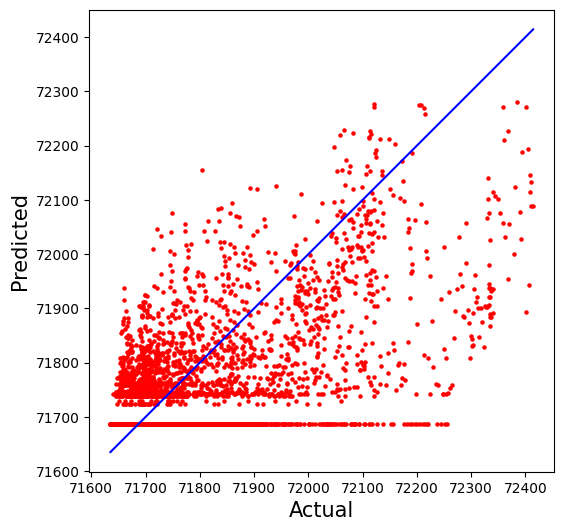

In [ ]:
trial, n_estimators_2, max_depth_2, min_samples_split_2, min_samples_leaf_2 = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators_2}, max_depth: {max_depth_2}, min_samples_split: {min_samples_split_2}, min_samples_leaf: {min_samples_leaf_2}")

The average of the root mean squared error (RMSE) on train set: 70.4970
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.4805030414173318
The average of the root mean squared error (RMSE) on test set: 74.3710
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.47088223572915466


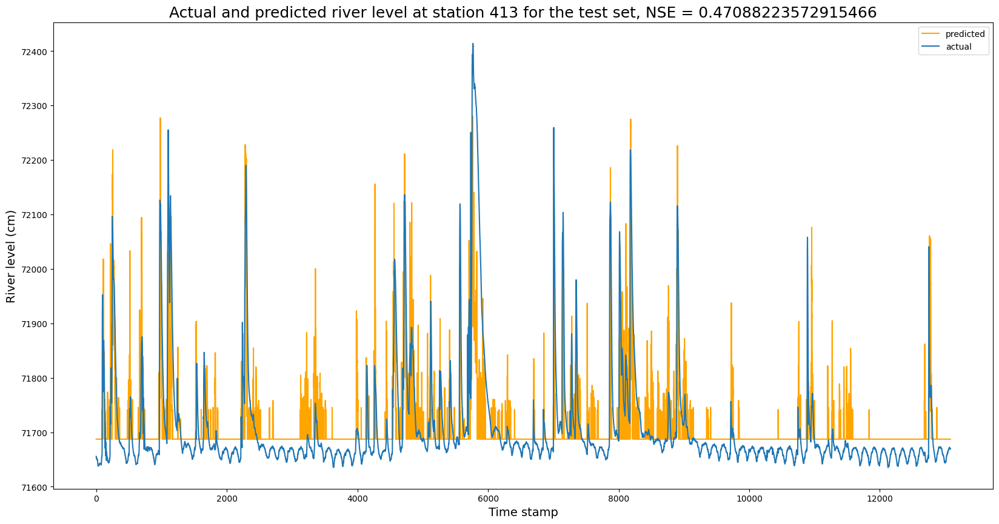

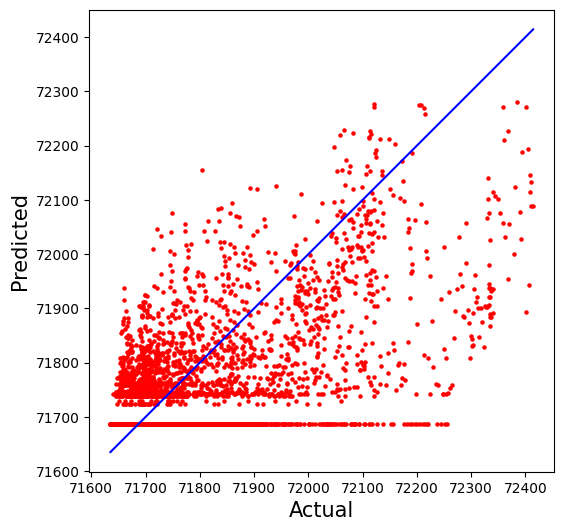

In [ ]:
n_estimators_2 = 200
max_depth_2 = 16
min_samples_split_2 = 19
min_samples_leaf_2 = 18
rmse_train_list_2_optuna, nse_train_list_2_optuna, rmse_list_2_optuna, nse_list_2_optuna, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators_2, max_depth = max_depth_2, min_samples_split = min_samples_split_2, min_samples_leaf = min_samples_leaf_2)

## Exp. 3: Nível no exutório

In [ ]:
X_train = np.array(X_train_general['valor_leitura_flu_413(t-0)'])
X_val = np.array(X_val_general['valor_leitura_flu_413(t-0)'])
X_test = np.array(X_test_general['valor_leitura_flu_413(t-0)'])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

#Reshaping
X_train = X_train.reshape(-1,1)
X_val = X_val.reshape(-1,1)
X_test = X_test.reshape(-1,1)

N_estimators: 50, max_depth: 19, min_samples_split: 16, min_samples_leaf: 20
The average of the root mean squared error (RMSE) on train set: 54.2232
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.6926650734828472
The average of the root mean squared error (RMSE) on test set: 54.5730
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.7150942774706287


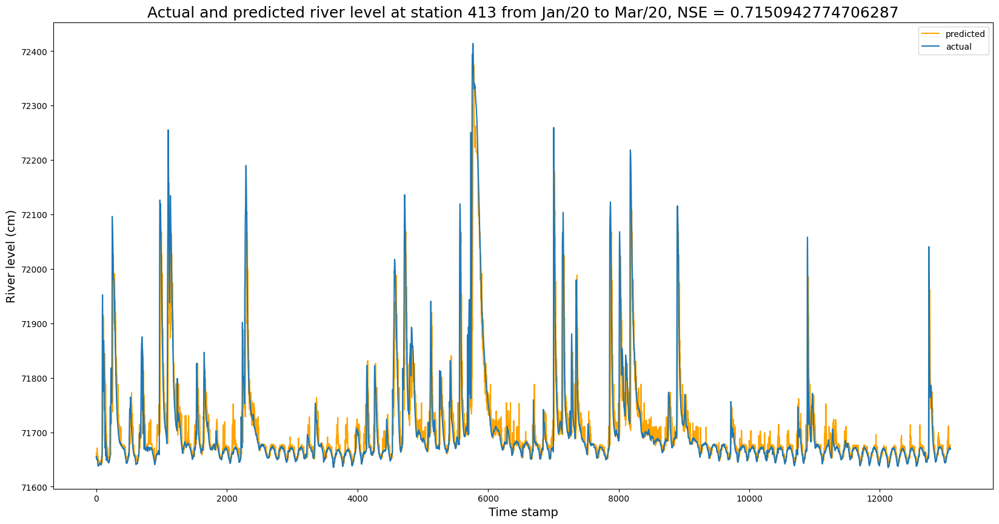

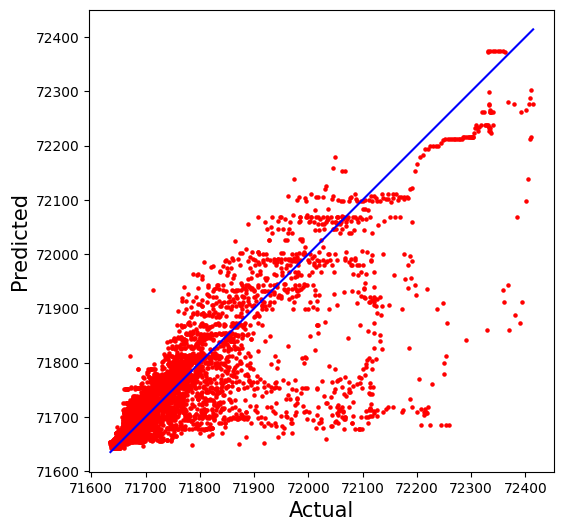

In [ ]:
trial, n_estimators_3, max_depth_3, min_samples_split_3, min_samples_leaf_3 = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators_3}, max_depth: {max_depth_3}, min_samples_split: {min_samples_split_3}, min_samples_leaf: {min_samples_leaf_3}")

The average of the root mean squared error (RMSE) on train set: 54.2232
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.6926650734828474
The average of the root mean squared error (RMSE) on test set: 54.5730
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.7150942774706279


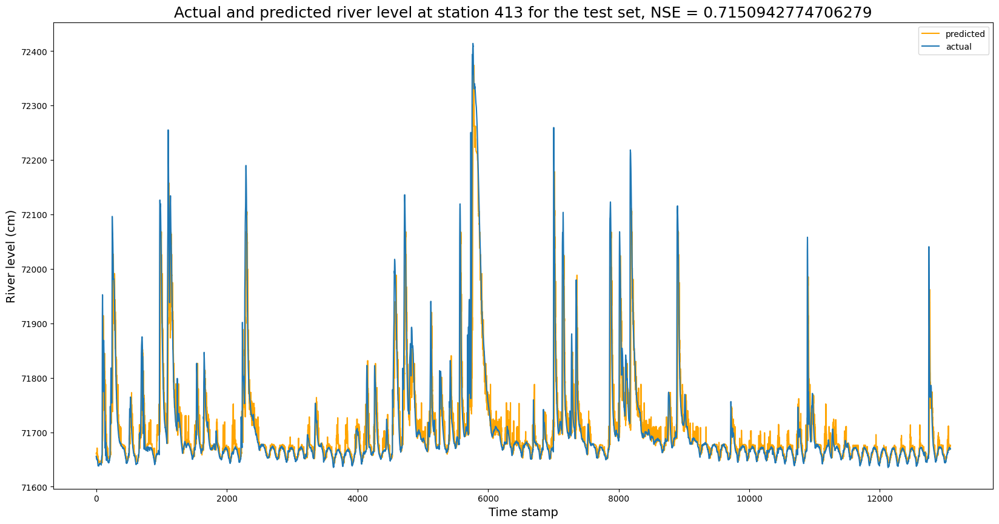

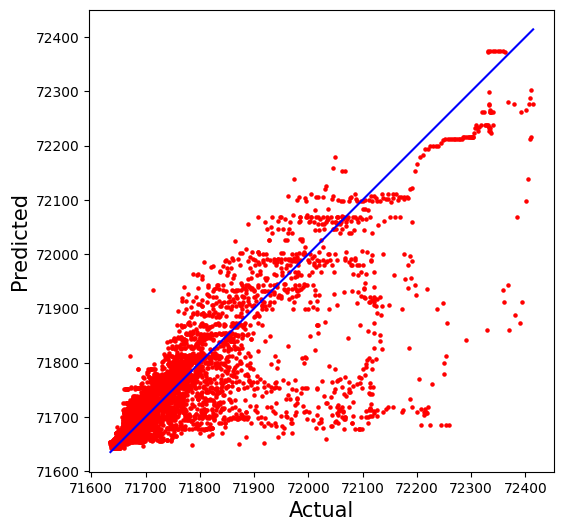

In [ ]:
n_estimators_3 = 50
max_depth_3 = 19
min_samples_split_3 = 16
min_samples_leaf_3 = 20
rmse_train_list_3_optuna, nse_train_list_3_optuna, rmse_list_3_optuna, nse_list_3_optuna, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators_3, max_depth = max_depth_3, min_samples_split = min_samples_split_3, min_samples_leaf = min_samples_leaf_3)

## Exp. 4: Nível no exutório e pluviômetro no exutório

In [ ]:
X_train = np.array(X_train_general[['valor_leitura_flu_413(t-0)','valor_leitura_plu_413(t-0)']])
X_val = np.array(X_val_general[['valor_leitura_flu_413(t-0)','valor_leitura_plu_413(t-0)']])
X_test = np.array(X_test_general[['valor_leitura_flu_413(t-0)','valor_leitura_plu_413(t-0)']])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

N_estimators: 200, max_depth: 20, min_samples_split: 11, min_samples_leaf: 20
The average of the root mean squared error (RMSE) on train set: 49.5548
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.7433070349755235
The average of the root mean squared error (RMSE) on test set: 50.6497
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.7545858556326915


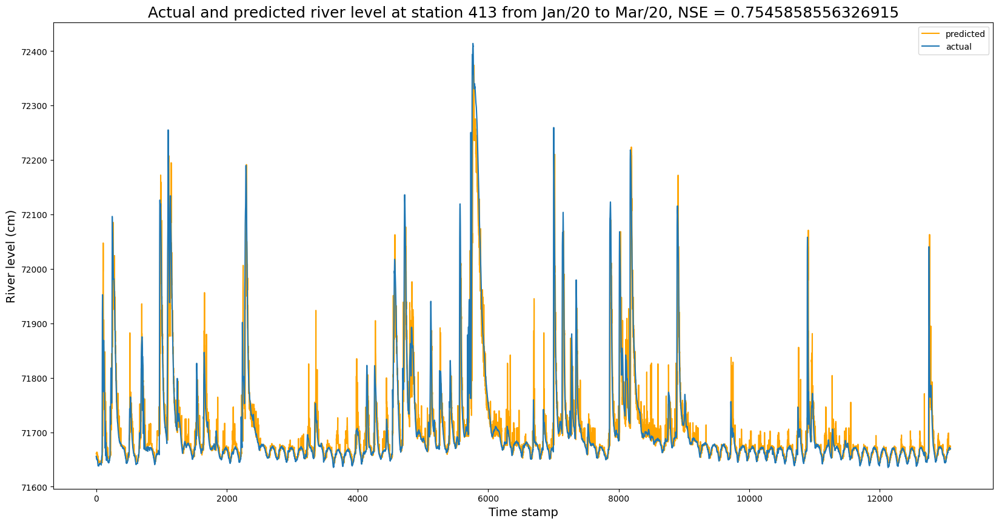

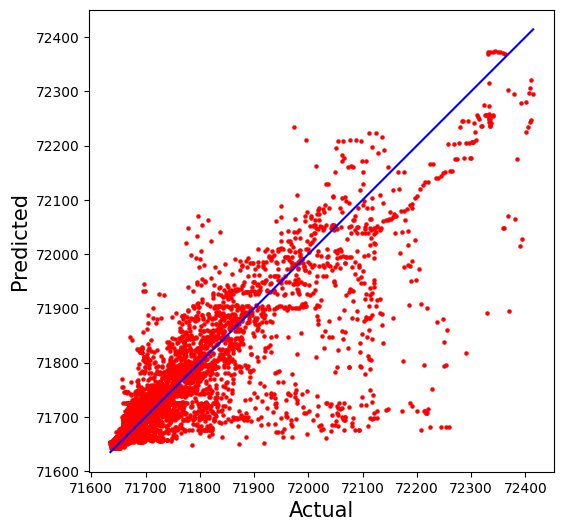

In [ ]:
trial, n_estimators_4, max_depth_4, min_samples_split_4, min_samples_leaf_4 = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators_4}, max_depth: {max_depth_4}, min_samples_split: {min_samples_split_4}, min_samples_leaf: {min_samples_leaf_4}")

The average of the root mean squared error (RMSE) on train set: 49.5548
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.7433070349755231
The average of the root mean squared error (RMSE) on test set: 50.6497
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.7545858556326914


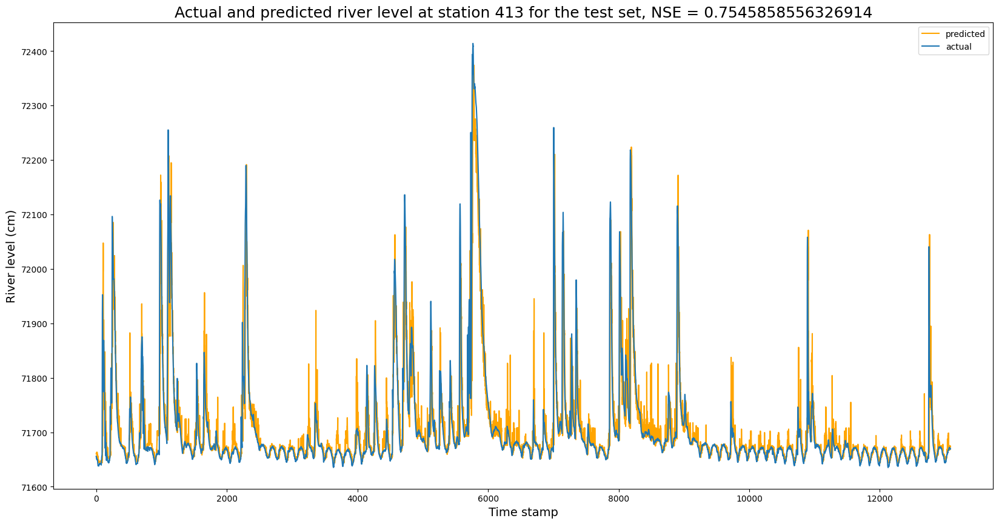

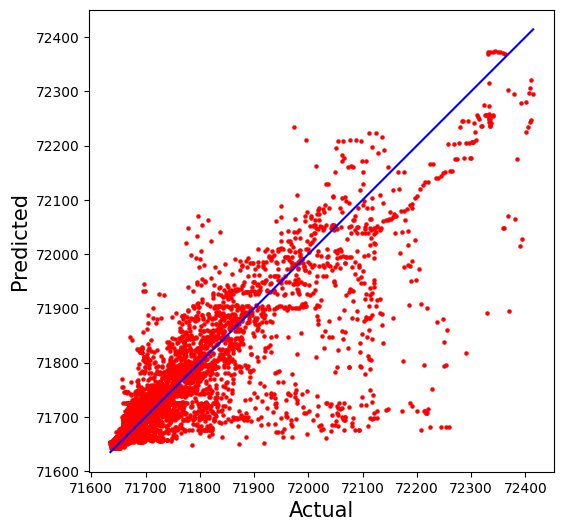

In [ ]:
n_estimators_4 = 200
max_depth_4 = 20
min_samples_split_4 = 11
min_samples_leaf_4 =  20
rmse_train_list_4_optuna, nse_train_list_4_optuna, rmse_list_4_optuna, nse_list_4_optuna, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators_4, max_depth = max_depth_4, min_samples_split = min_samples_split_4, min_samples_leaf = min_samples_leaf_4)

## Exp. 5: Nível exutório e todos os pluviômetros da bacia

In [ ]:
entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

N_estimators: 200, max_depth: 18, min_samples_split: 20, min_samples_leaf: 4
The average of the root mean squared error (RMSE) on train set: 36.9951
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.8569355053384653
The average of the root mean squared error (RMSE) on test set: 42.6544
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.8259505231535897


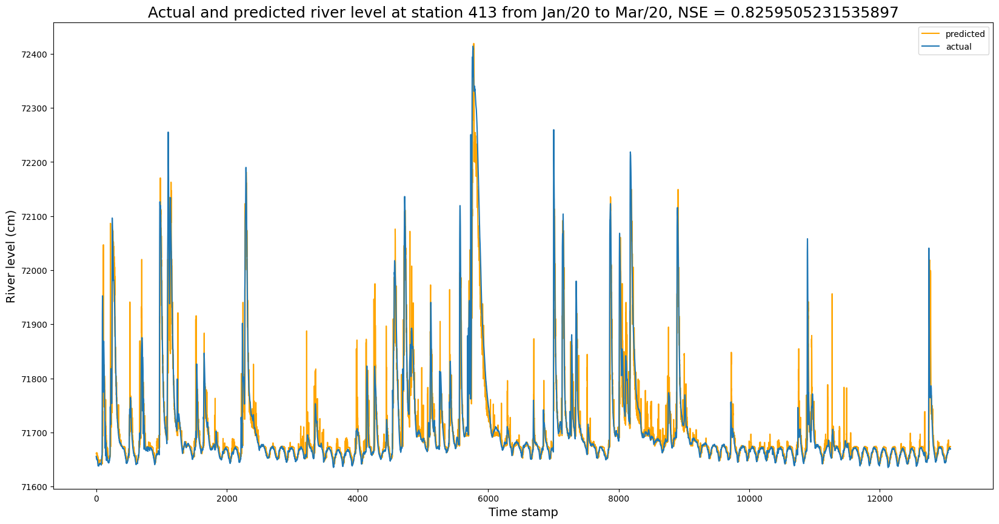

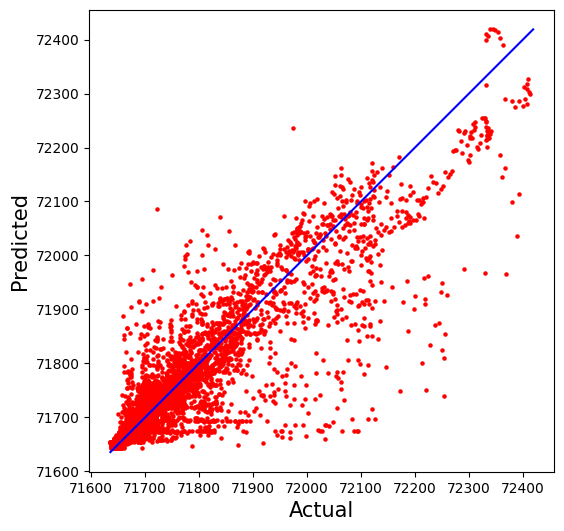

In [ ]:
trial, n_estimators_5, max_depth_5, min_samples_split_5, min_samples_leaf_5 = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators_5}, max_depth: {max_depth_5}, min_samples_split: {min_samples_split_5}, min_samples_leaf: {min_samples_leaf_5}")

The average of the root mean squared error (RMSE) on train set: 36.9951
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.8569355053384649
The average of the root mean squared error (RMSE) on test set: 42.6544
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.8259505231535903


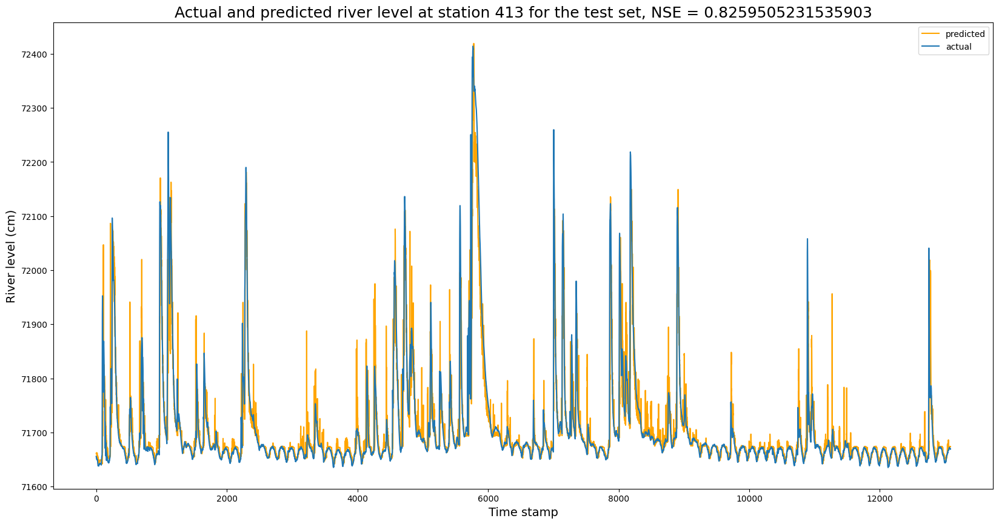

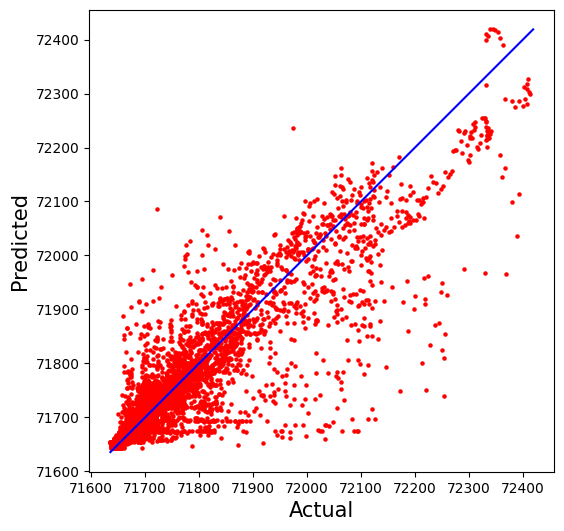

In [ ]:
n_estimators_5 =  200
max_depth_5 = 18
min_samples_split_5 =  20
min_samples_leaf_5 = 4
rmse_train_list_5_optuna, nse_train_list_5_optuna, rmse_list_5_optuna, nse_list_5_optuna, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators_5, max_depth = max_depth_5, min_samples_split = min_samples_split_5, min_samples_leaf = min_samples_leaf_5)

In [ ]:
# Bônus
# Testando XGBoost
#trial, max_depth_5, learning_rate_5 , n_estimators_5, min_child_weight_5, gamma_5, subsample_5, colsample_bytree_5, reg_alpha_5, reg_lambda_5, = run_optuna_xgb(n_trials=50)
#rmse_train_list_5, nse_train_list_5, rmse_list_5, nse_list_5, importances = fit_and_evaluate_xgboost(X_train,y_train,X_val,y_val, X_test,y_test, max_depth = max_depth_5, learning_rate = learning_rate_5, n_estimators = n_estimators_5, min_child_weight = min_child_weight_5, gamma = gamma_5,subsample = subsample_5, colsample_bytree = colsample_bytree_5, reg_alpha = reg_alpha_5, reg_lambda = reg_lambda_5)

## Exp. 6: Nível exutório e níveis a montante

In [ ]:
entradas = []
for nome in X_train_general.columns:
  if ('flu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

N_estimators: 150, max_depth: 15, min_samples_split: 20, min_samples_leaf: 3
The average of the root mean squared error (RMSE) on train set: 31.5369
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.8960368169053428
The average of the root mean squared error (RMSE) on test set: 47.1472
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.7873538882051954


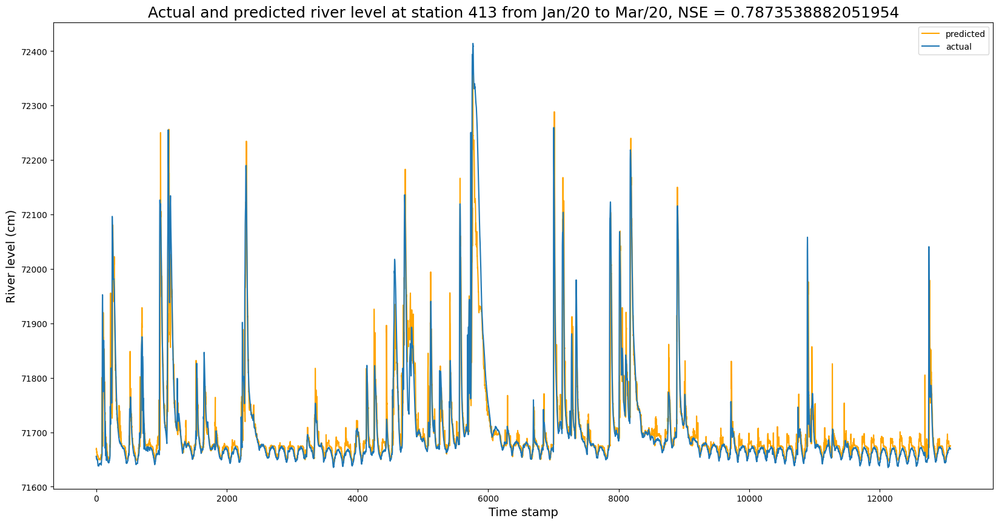

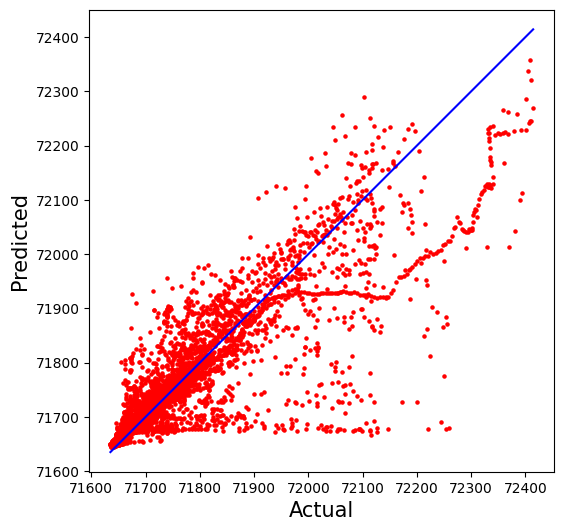

In [ ]:
trial, n_estimators_6, max_depth_6, min_samples_split_6, min_samples_leaf_6 = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators_6}, max_depth: {max_depth_6}, min_samples_split: {min_samples_split_6}, min_samples_leaf: {min_samples_leaf_6}")

The average of the root mean squared error (RMSE) on train set: 31.5369
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.8960368169053423
The average of the root mean squared error (RMSE) on test set: 47.1472
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.7873538882051958


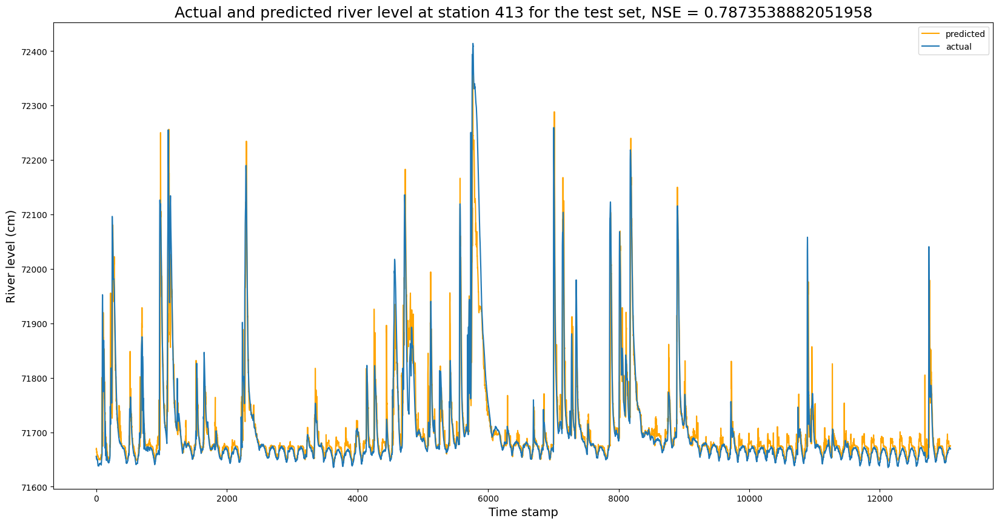

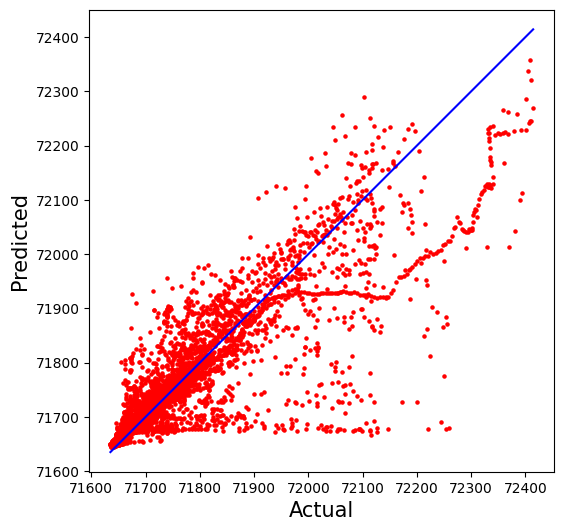

In [ ]:
n_estimators_6 = 150
max_depth_6 = 15
min_samples_split_6 = 20
min_samples_leaf_6 = 3
rmse_train_list_6_optuna, nse_train_list_6_optuna, rmse_list_6_optuna, nse_list_6_optuna, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators_6, max_depth = max_depth_6, min_samples_split = min_samples_split_6, min_samples_leaf = min_samples_leaf_6)

## Exp. 7: Nível exutório, níveis a montante e todos os pluviômetros da bacia

In [ ]:
entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

N_estimators: 200, max_depth: 15, min_samples_split: 16, min_samples_leaf: 2
The average of the root mean squared error (RMSE) on train set: 27.1971
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.9226806617301786
The average of the root mean squared error (RMSE) on test set: 43.3222
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.8204582823160043


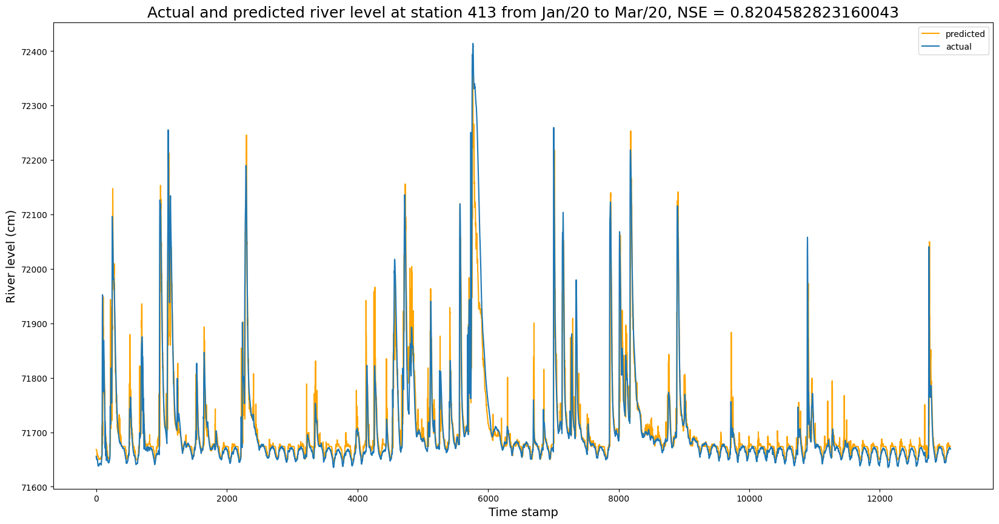

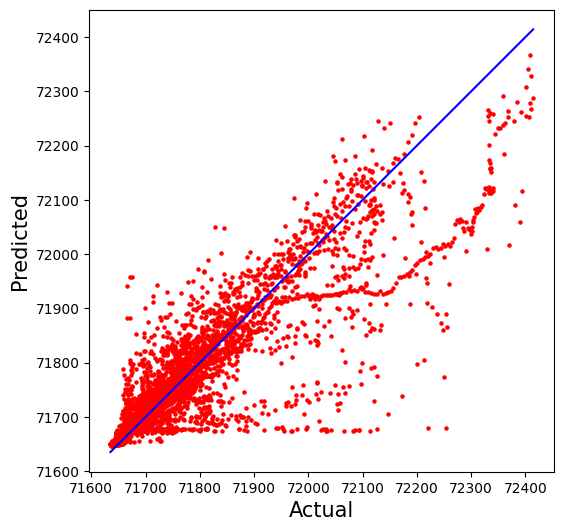

In [ ]:
trial, n_estimators_7, max_depth_7, min_samples_split_7, min_samples_leaf_7 = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators_7}, max_depth: {max_depth_7}, min_samples_split: {min_samples_split_7}, min_samples_leaf: {min_samples_leaf_7}")

The average of the root mean squared error (RMSE) on train set: 27.1971
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.922680661730179
The average of the root mean squared error (RMSE) on test set: 43.3222
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.8204582823160058


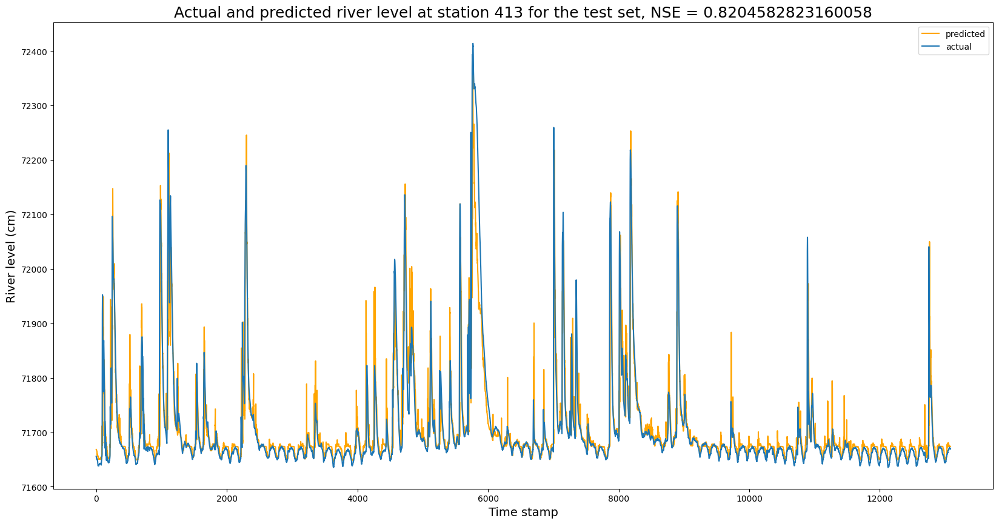

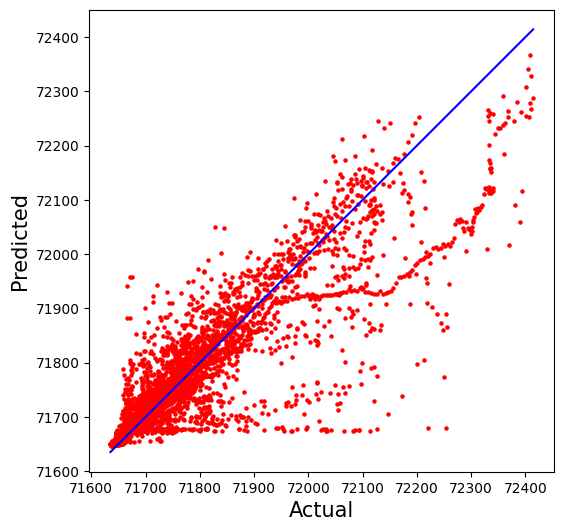

In [ ]:
n_estimators_7 = 200
max_depth_7 = 15
min_samples_split_7 = 16
min_samples_leaf_7 = 2
rmse_train_list_7_optuna, nse_train_list_7_optuna, rmse_list_7_optuna, nse_list_7_optuna, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators_7, max_depth = max_depth_7, min_samples_split = min_samples_split_7, min_samples_leaf = min_samples_leaf_7)

## Comparação de Performances

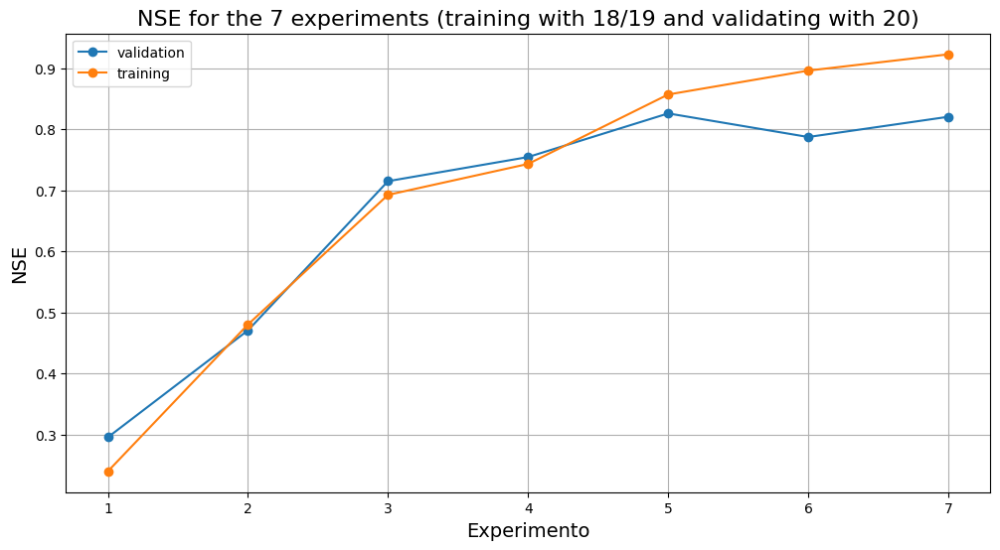

In [ ]:
plt.figure(figsize=(12, 6))
plt.plot([1,2,3,4,5,6,7], [nse_list_1_optuna,nse_list_2_optuna,nse_list_3_optuna,nse_list_4_optuna,nse_list_5_optuna,nse_list_6_optuna,nse_list_7_optuna], marker = 'o', label = 'validation')
plt.plot([1,2,3,4,5,6,7], [nse_train_list_1_optuna,nse_train_list_2_optuna,nse_train_list_3_optuna,nse_train_list_4_optuna,nse_train_list_5_optuna,nse_train_list_6_optuna,nse_train_list_7_optuna], marker = 'o', label = 'training')
plt.title(f'NSE for the 7 experiments (training with 18/19 and validating with 20)',fontsize=16)
#plt.title(f'NSE para os 7 experimentos (treinando com 18/19 e validando com 20)',fontsize=16)
plt.ylabel('NSE',fontsize=14)
#plt.xlabel('Experiment',fontsize=14)
plt.xlabel('Experimento',fontsize=14)
plt.grid(linestyle='-')
#plt.xticks([0, 1, 2, 3, 4, 5, 6, 7], ['e1', 'e2', 'e3', 'e4','e5','e6','e7'],rotation=20)  # Set text labels and properties
plt.legend()
plt.show()

## Experimentos Markovianos com Random Forest (Treinando com 2018+2019+2020 e Testando em 2021+2022)

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019,df_2020], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023])
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df)

## Exp. 1: Só Pluviômetro Exutório

<ipython-input-9-73a65f936368>:9: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().


The average of the root mean squared error (RMSE) on train set: 85.3163
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.26211044030726494
The average of the root mean squared error (RMSE) on test set: 77.3801
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.16311691303673326


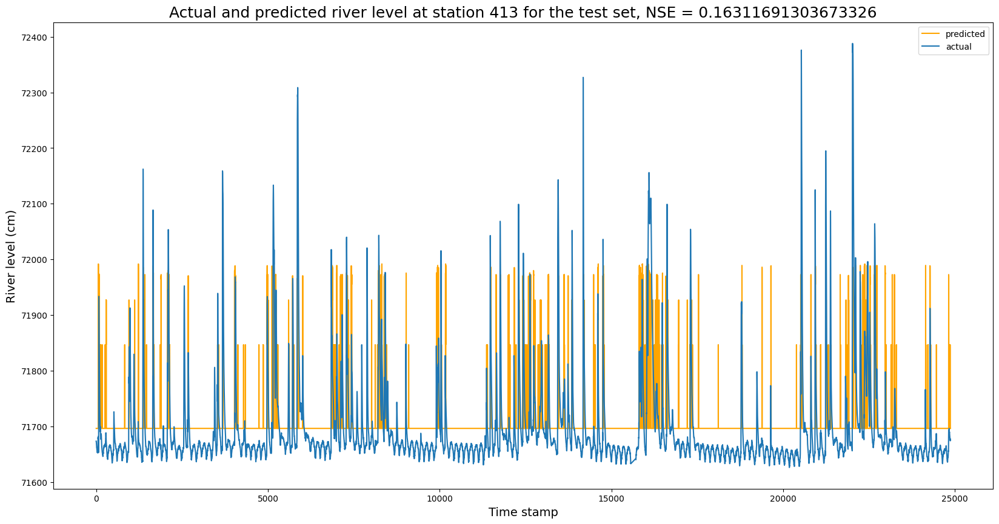

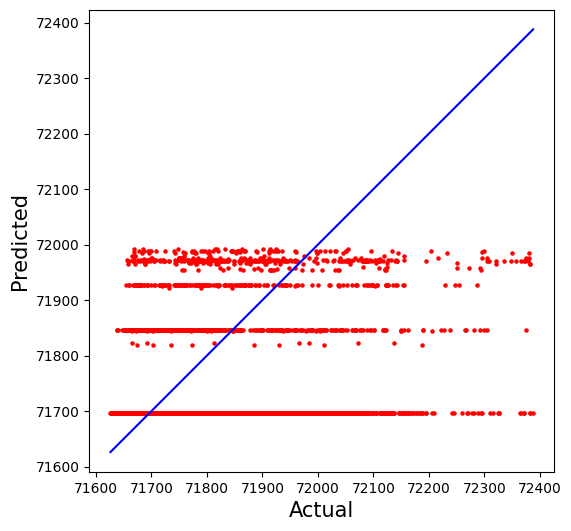

In [ ]:
X_train = np.array(X_train_general['valor_leitura_plu_413(t-0)'])
X_val = np.array(X_val_general['valor_leitura_plu_413(t-0)'])
X_test = np.array(X_test_general['valor_leitura_plu_413(t-0)'])
y_train = np.array(y_train_general.values)
y_val = np.array(y_val_general.values)
y_test = np.array(y_test_general.values)

#Reshaping
X_train = X_train.reshape(-1,1)
X_val = X_val.reshape(-1,1)
X_test = X_test.reshape(-1,1)

n_estimators_1 = 150
max_depth_1 = 4
min_samples_split_1 = 9
min_samples_leaf_1 = 14

rmse_train_list_1_2122, nse_train_list_1_2122, rmse_list_1_2122, nse_list_1_2122, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators_1, max_depth = max_depth_1, min_samples_split = min_samples_split_1, min_samples_leaf = min_samples_leaf_1)

## Exp. 2: Todos os pluviômetros da bacia

<ipython-input-9-73a65f936368>:9: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().


The average of the root mean squared error (RMSE) on train set: 70.5879
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.4948881772290218
The average of the root mean squared error (RMSE) on test set: 65.6310
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.397962016799038


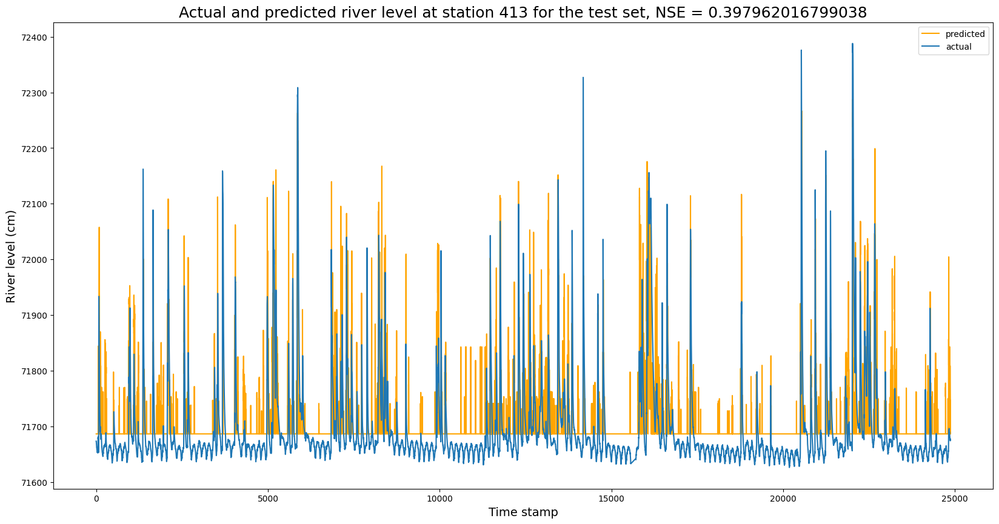

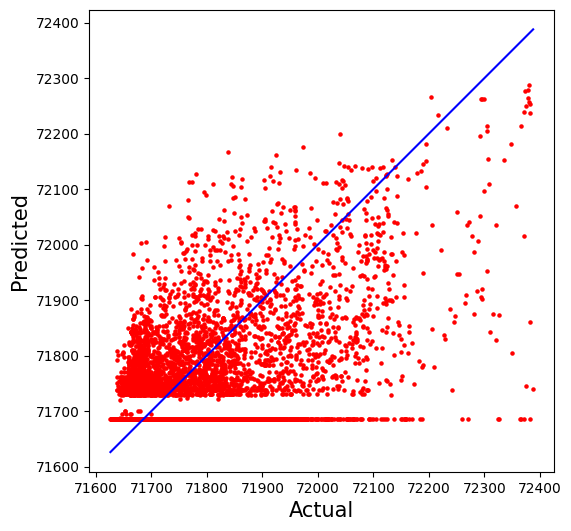

In [ ]:
pluviometros = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    pluviometros.append(nome)

X_train = np.array(X_train_general[pluviometros])
X_val = np.array(X_val_general[pluviometros])
X_test = np.array(X_test_general[pluviometros])
y_train = np.array(y_train_general.values)
y_val = np.array(y_val_general.values)
y_test = np.array(y_test_general.values)

n_estimators_2 = 200
max_depth_2 = 16
min_samples_split_2 = 19
min_samples_leaf_2 = 18

rmse_train_list_2_2122, nse_train_list_2_2122, rmse_list_2_2122, nse_list_2_2122, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators_2, max_depth = max_depth_2, min_samples_split = min_samples_split_2, min_samples_leaf = min_samples_leaf_2)

Análise da importância das features

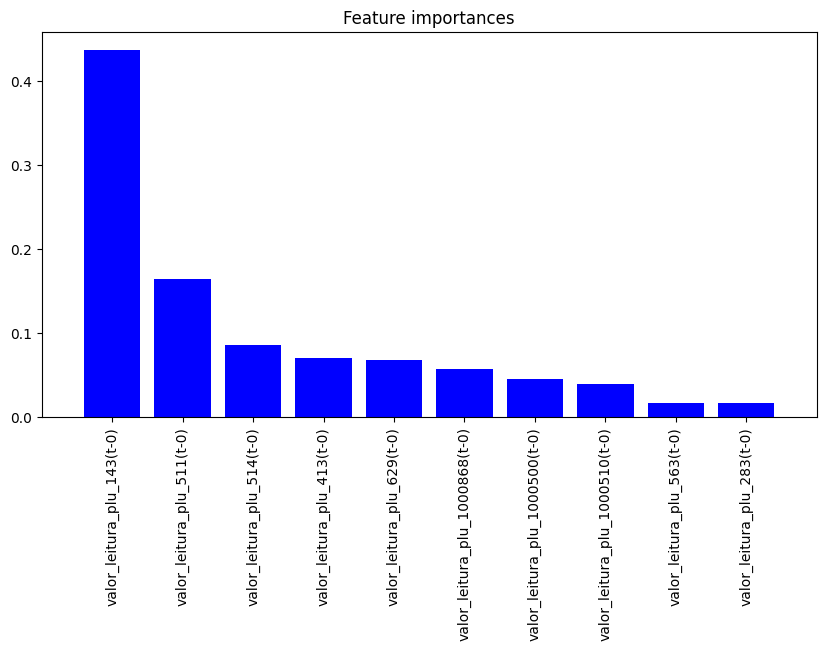

In [ ]:
feature_names = X_train_general[pluviometros].columns

# Based on: https://towardsdatascience.com/machine-learning-for-forecasting-supervised-learning-with-multivariate-time-series-b5b5044fe068
# Ordena as features pelo valor de importância
indices = np.argsort(importances)[::-1]

# Plota o gráfico de barras com os nomes das features
plt.figure(figsize=(10, 5))
plt.title("Feature importances")
plt.bar(range(10), importances[indices[0:10]],
        color="b", align="center")
plt.xticks(range(10), feature_names[indices[0:10]], rotation='vertical')
plt.xlim([-1, 10])

#plt.bar(range(X_train.shape[1]), importances[indices],
#        color="b", align="center")
#plt.xticks(range(X_train.shape[1]), feature_names[indices], rotation='vertical')
#plt.xlim([-1, X_train.shape[1]])
plt.show()

## Exp. 3: Nível no exutório

<ipython-input-9-73a65f936368>:9: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().


The average of the root mean squared error (RMSE) on train set: 53.5256
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.7095638220411156
The average of the root mean squared error (RMSE) on test set: 56.7823
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.549357580263658


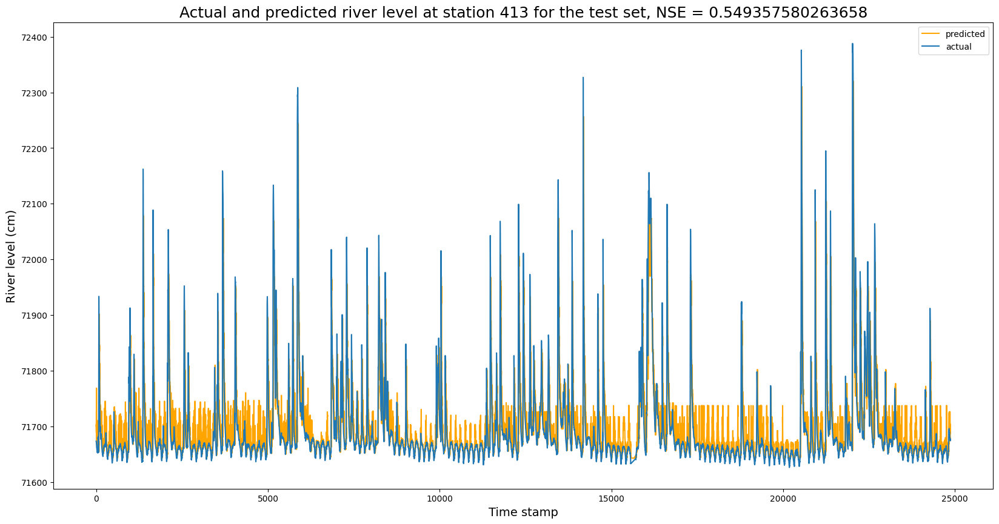

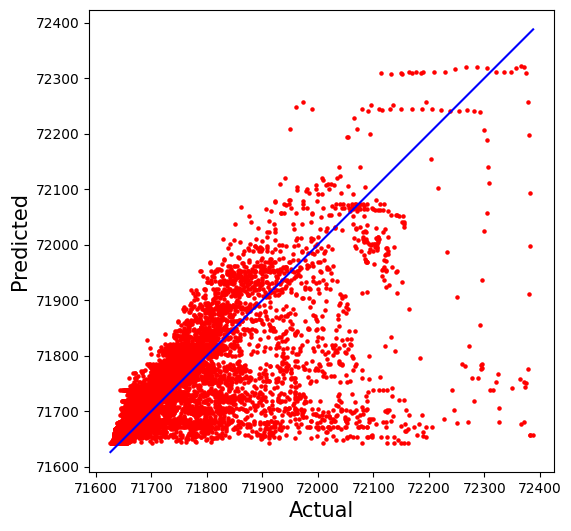

In [ ]:
X_train = np.array(X_train_general['valor_leitura_flu_413(t-0)'])
X_val = np.array(X_val_general['valor_leitura_flu_413(t-0)'])
X_test = np.array(X_test_general['valor_leitura_flu_413(t-0)'])
y_train = np.array(y_train_general.values)
y_val = np.array(y_val_general.values)
y_test = np.array(y_test_general.values)

#Reshaping
X_train = X_train.reshape(-1,1)
X_val = X_val.reshape(-1,1)
X_test = X_test.reshape(-1,1)

n_estimators_3 = 50
max_depth_3 = 19
min_samples_split_3 = 16
min_samples_leaf_3 = 20

rmse_train_list_3_2122, nse_train_list_3_2122, rmse_list_3_2122, nse_list_3_2122, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators_3, max_depth = max_depth_3, min_samples_split = min_samples_split_3, min_samples_leaf = min_samples_leaf_3)

## Exp. 4: Nível no exutório e pluviômetro no exutório

<ipython-input-9-73a65f936368>:9: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().


The average of the root mean squared error (RMSE) on train set: 48.9855
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.7567446346761899
The average of the root mean squared error (RMSE) on test set: 53.7277
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.5965384724539385


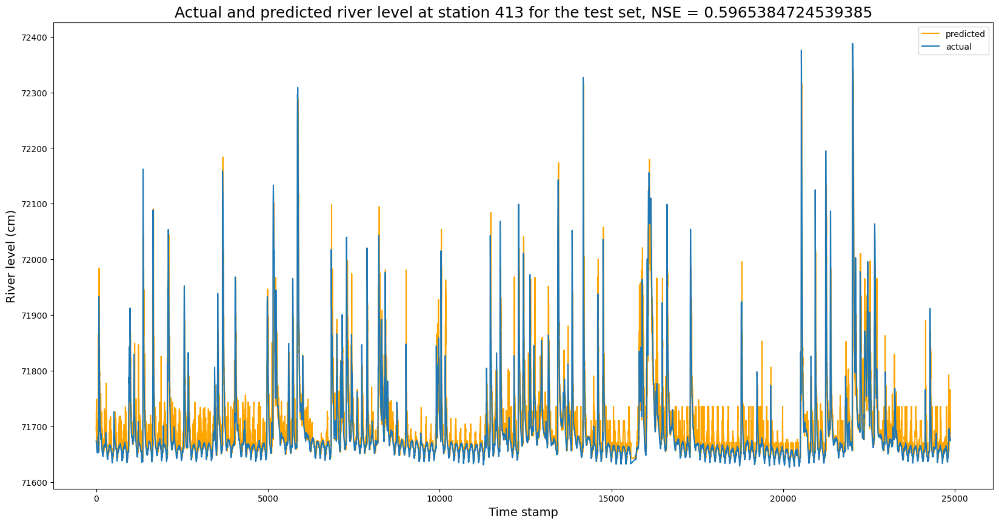

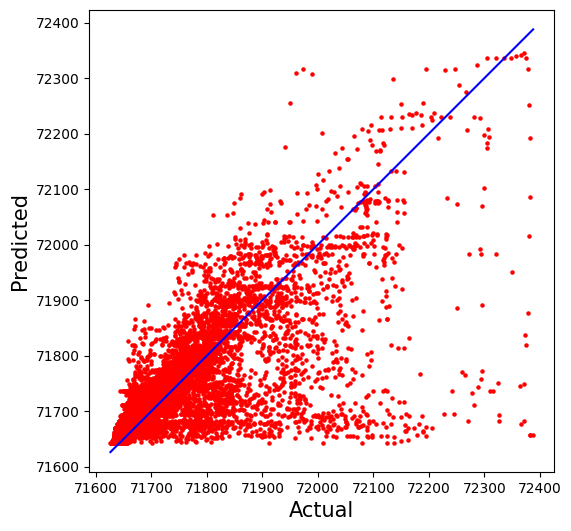

In [ ]:
X_train = np.array(X_train_general[['valor_leitura_flu_413(t-0)','valor_leitura_plu_413(t-0)']])
X_val = np.array(X_val_general[['valor_leitura_flu_413(t-0)','valor_leitura_plu_413(t-0)']])
X_test = np.array(X_test_general[['valor_leitura_flu_413(t-0)','valor_leitura_plu_413(t-0)']])
y_train = np.array(y_train_general.values)
y_val = np.array(y_val_general.values)
y_test = np.array(y_test_general.values)

n_estimators_4 = 200
max_depth_4 = 20
min_samples_split_4 = 11
min_samples_leaf_4 = 20

rmse_train_list_4_2122, nse_train_list_4_2122, rmse_list_4_2122, nse_list_4_2122, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators_4, max_depth = max_depth_4, min_samples_split = min_samples_split_4, min_samples_leaf = min_samples_leaf_4)

## Exp. 5: Nível exutório e todos os pluviômetros da bacia

<ipython-input-9-73a65f936368>:9: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().


The average of the root mean squared error (RMSE) on train set: 36.4091
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.8656160997487783
The average of the root mean squared error (RMSE) on test set: 45.3054
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.7131161583732513


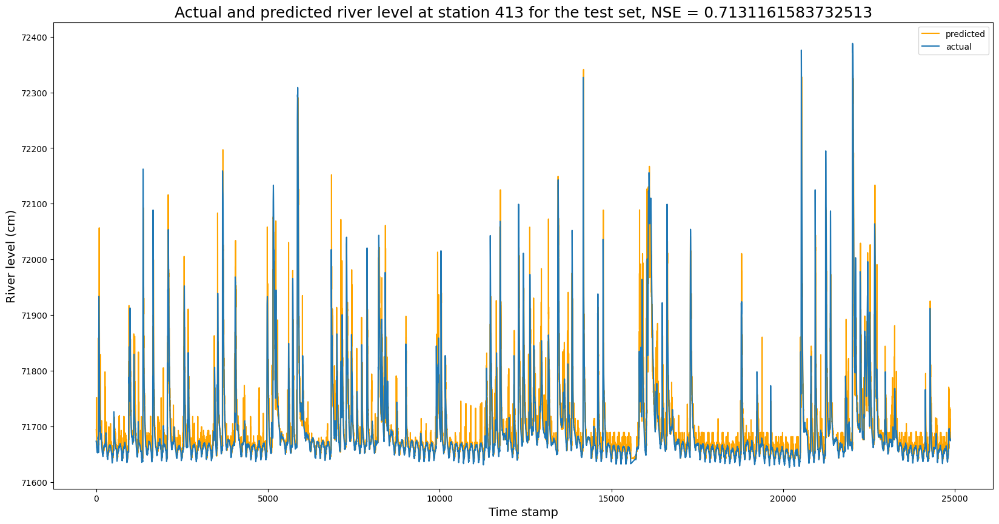

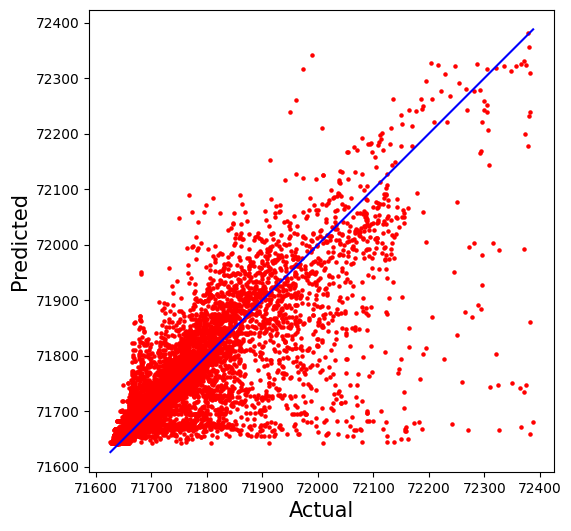

In [ ]:
entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)


X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values)
y_val = np.array(y_val_general.values)
y_test = np.array(y_test_general.values)

n_estimators_5 = 200
max_depth_5 = 18
min_samples_split_5 = 20
min_samples_leaf_5 = 4

rmse_train_list_5_2122, nse_train_list_5_2122, rmse_list_5_2122, nse_list_5_2122, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators_5, max_depth = max_depth_5, min_samples_split = min_samples_split_5, min_samples_leaf = min_samples_leaf_5)

Análise da importância das features

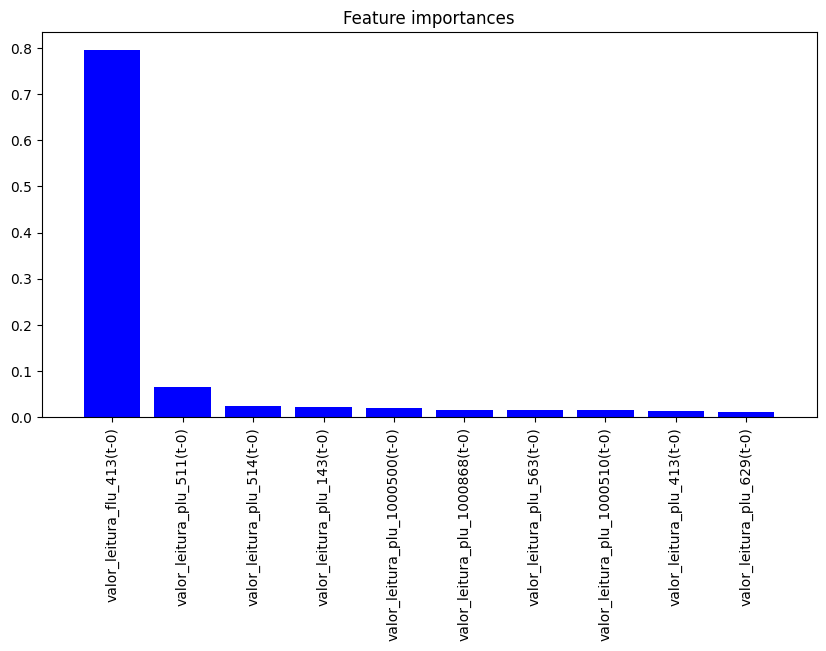

In [ ]:
feature_names = X_train_general[entradas].columns

# Based on: https://towardsdatascience.com/machine-learning-for-forecasting-supervised-learning-with-multivariate-time-series-b5b5044fe068
# Ordena as features pelo valor de importância
indices = np.argsort(importances)[::-1]

# Plota o gráfico de barras com os nomes das features
plt.figure(figsize=(10, 5))
plt.title("Feature importances")
plt.bar(range(10), importances[indices[0:10]],
        color="b", align="center")
plt.xticks(range(10), feature_names[indices[0:10]], rotation='vertical')
plt.xlim([-1, 10])

#plt.bar(range(X_train.shape[1]), importances[indices],
#        color="b", align="center")
#plt.xticks(range(X_train.shape[1]), feature_names[indices], rotation='vertical')
#plt.xlim([-1, X_train.shape[1]])
plt.show()

## Exp. 6: Nível exutório e níveis a montante

<ipython-input-9-73a65f936368>:9: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().


The average of the root mean squared error (RMSE) on train set: 30.9885
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.9026516634335937
The average of the root mean squared error (RMSE) on test set: 84.1525
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.01021668214627991


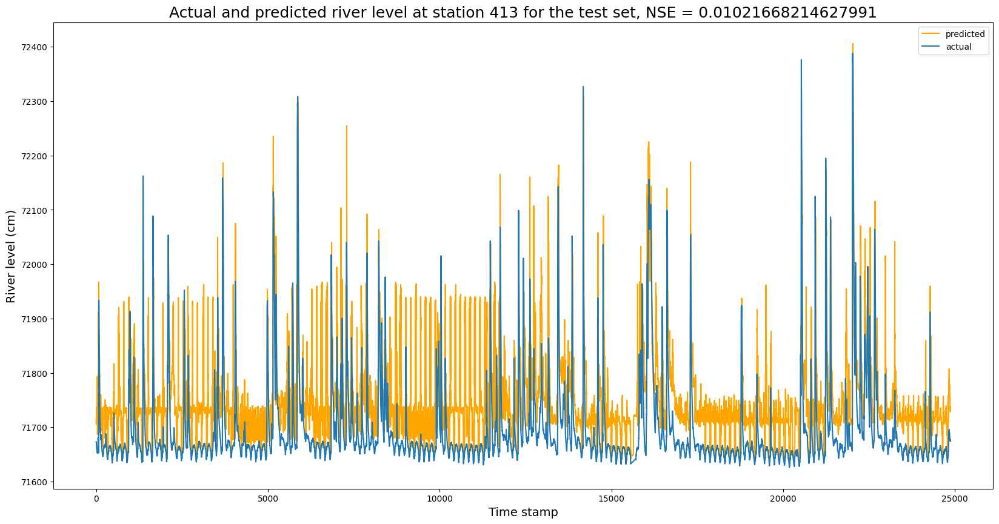

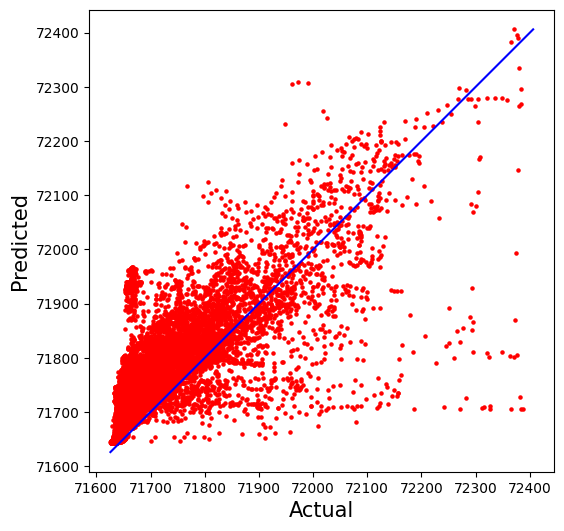

In [ ]:
entradas = []
for nome in X_train_general.columns:
  if ('flu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values)
y_val = np.array(y_val_general.values)
y_test = np.array(y_test_general.values)

n_estimators_6 = 150
max_depth_6 = 15
min_samples_split_6 = 20
min_samples_leaf_6 = 3

rmse_train_list_6_2122, nse_train_list_6_2122, rmse_list_6_2122, nse_list_6_2122, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators_6, max_depth = max_depth_6, min_samples_split = min_samples_split_6, min_samples_leaf = min_samples_leaf_6)

## Exp. 7: Nível exutório, níveis a montante e todos os pluviômetros da bacia

<ipython-input-9-73a65f936368>:9: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().


The average of the root mean squared error (RMSE) on train set: 27.1182
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.9254497807638653
The average of the root mean squared error (RMSE) on test set: 53.4401
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.6008462496644158


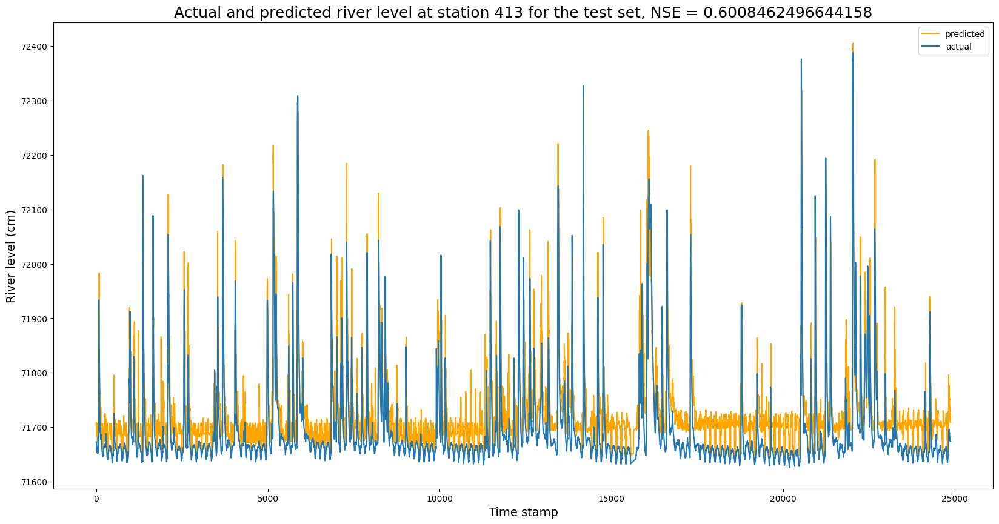

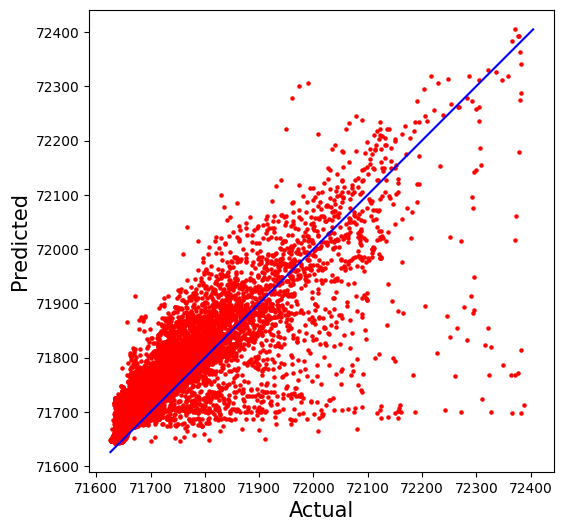

In [ ]:
entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values)
y_val = np.array(y_val_general.values)
y_test = np.array(y_test_general.values)

n_estimators_7 = 200
max_depth_7 = 15
min_samples_split_7 = 16
min_samples_leaf_7 = 2

rmse_train_list_7_2122, nse_train_list_7_2122, rmse_list_7_2122, nse_list_7_2122, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators_7, max_depth = max_depth_7, min_samples_split = min_samples_split_7, min_samples_leaf = min_samples_leaf_7)

Análise da importância das features

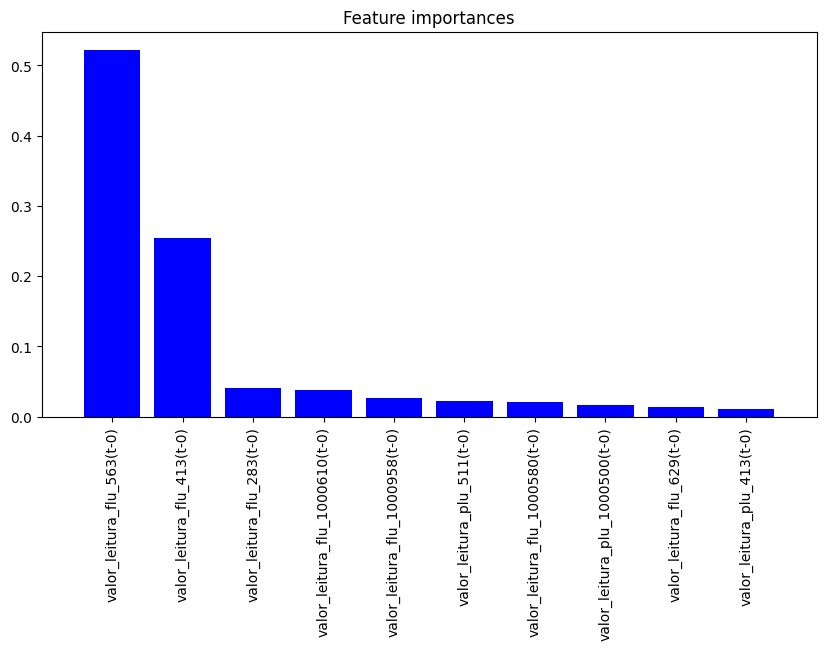

In [ ]:
feature_names = X_train_general[entradas].columns

# Based on: https://towardsdatascience.com/machine-learning-for-forecasting-supervised-learning-with-multivariate-time-series-b5b5044fe068
# Ordena as features pelo valor de importância
indices = np.argsort(importances)[::-1]

# Plota o gráfico de barras com os nomes das features
plt.figure(figsize=(10, 5))
plt.title("Feature importances")
plt.bar(range(10), importances[indices[0:10]],
        color="b", align="center")
plt.xticks(range(10), feature_names[indices[0:10]], rotation='vertical')
plt.xlim([-1, 10])

#plt.bar(range(X_train.shape[1]), importances[indices],
#        color="b", align="center")
#plt.xticks(range(X_train.shape[1]), feature_names[indices], rotation='vertical')
#plt.xlim([-1, X_train.shape[1]])
plt.show()

## Comparação de Performances

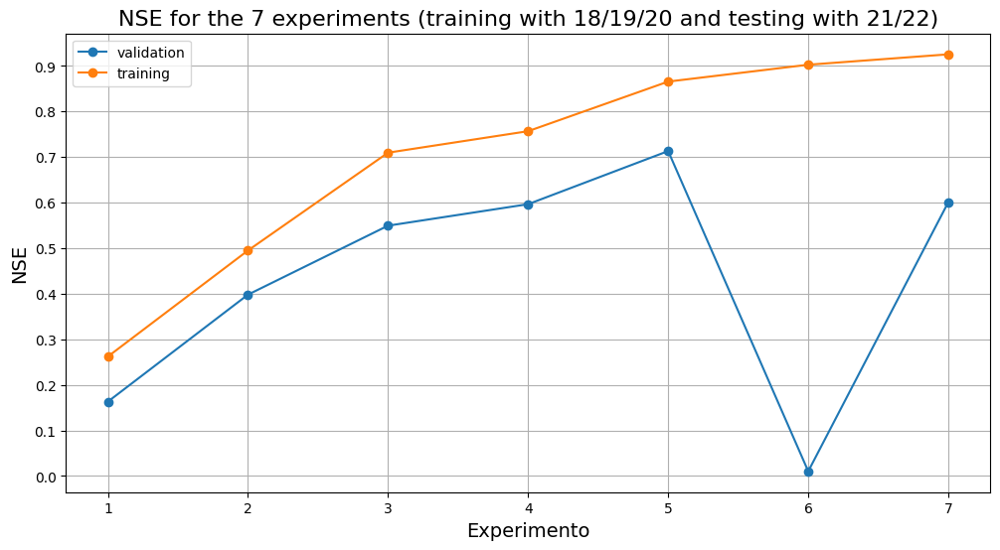

In [ ]:
import matplotlib as mpl
mpl.rcParams.update(mpl.rcParamsDefault)
plt.figure(figsize=(12, 6))
plt.plot([1,2,3,4,5,6,7], [nse_list_1_2122,nse_list_2_2122,nse_list_3_2122,nse_list_4_2122,nse_list_5_2122,nse_list_6_2122,nse_list_7_2122], marker = 'o', label = 'validation')
plt.plot([1,2,3,4,5,6,7], [nse_train_list_1_2122,nse_train_list_2_2122,nse_train_list_3_2122,nse_train_list_4_2122,nse_train_list_5_2122,nse_train_list_6_2122,nse_train_list_7_2122], marker = 'o', label = 'training')
plt.title(f'NSE for the 7 experiments (training with 18/19/20 and testing with 21/22)',fontsize=16)
#plt.title(f'NSE para os 7 experimentos (treinando com 18/19/20 e testando com 21/22)',fontsize=16)
plt.ylabel('NSE',fontsize=14)
#plt.xlabel('Experiment',fontsize=14)
plt.xlabel('Experimento',fontsize=14)
plt.yticks([0,0.1,0.2,0.3,0.4,0.5,0.6,0.7,0.8,0.9])
plt.grid(linestyle='-')
#plt.xticks([0, 1, 2, 3, 4, 5, 6, 7], ['e1', 'e2', 'e3', 'e4','e5','e6','e7'],rotation=20)  # Set text labels and properties
plt.legend()
plt.show()

# Parte 2: Experimentos com previsões para diferentes horizontes de tempo (TALVEZ EXLCUIR ESSA SEÇÃO)

Nessa parte, testaremos diferentes horizontes para o Experimento 5 (All Rain Gauges + HS_out), que foi o que teve melhores resultados na Parte 1.

## Experimento para horizonte de 1 hora (Exp. 5: Nível exutório e todos os pluviômetros da bacia)

### Com treino em 2018/2019 e validação em 2020

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023],horizon=6)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df,horizon=6)

Lista de RMSE: [27.547695515194523]
Lista de NSE: [0.927378369899966]
The average of the root mean squared error (RMSE) on test set: 27.5477
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.927378369899966


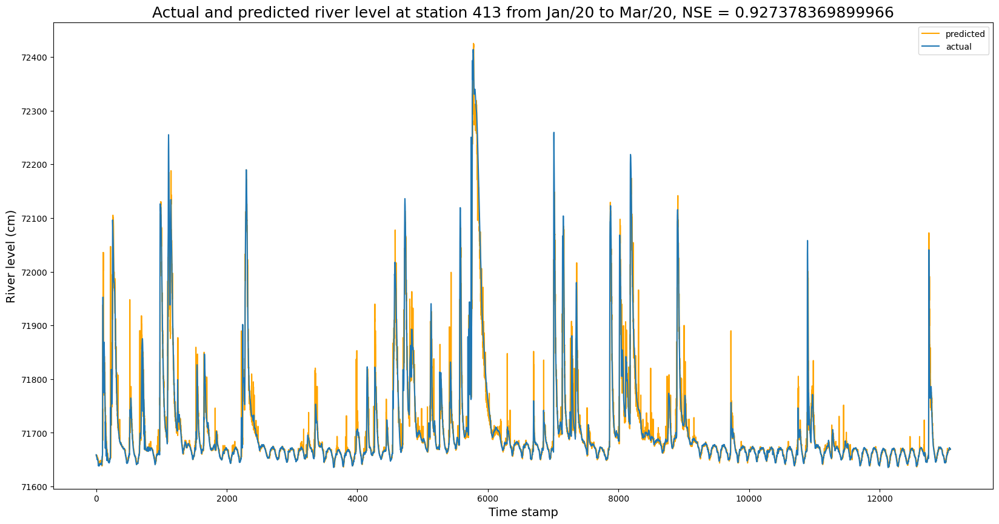

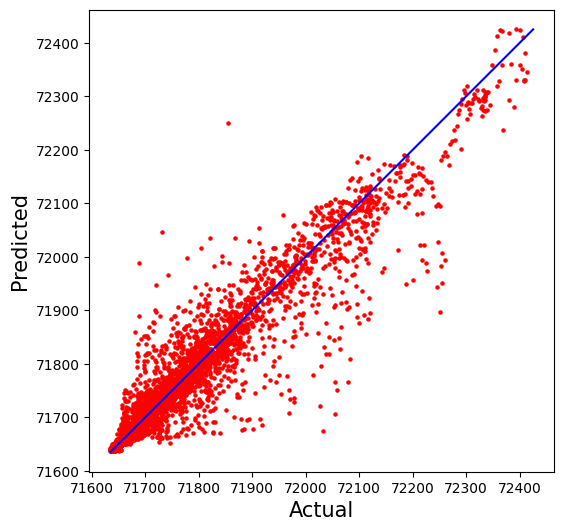

In [ ]:
entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_1_val, nse_train_list_1_val, rmse_list_1_val, nse_list_5_1_val, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

[I 2023-08-12 21:41:40,028] A new study created in memory with name: no-name-465145aa-d732-4615-b679-60cb7eecf7ee


N_estimators: 200, max_depth: 14, min_samples_split: 10, min_samples_leaf: 2
Lista de RMSE: [26.481750282570065]
Lista de NSE: [0.9328897561615068]
The average of the root mean squared error (RMSE) on test set: 26.4818
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.9328897561615068


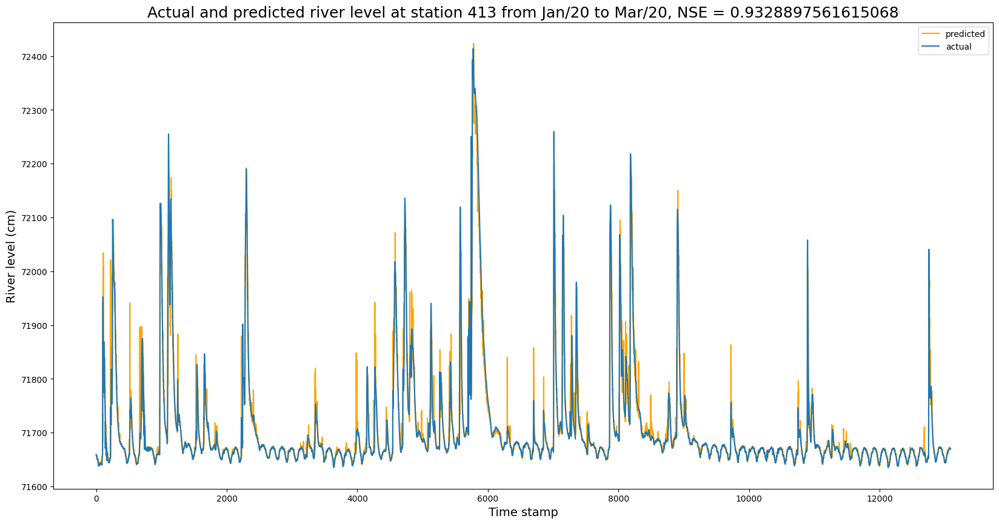

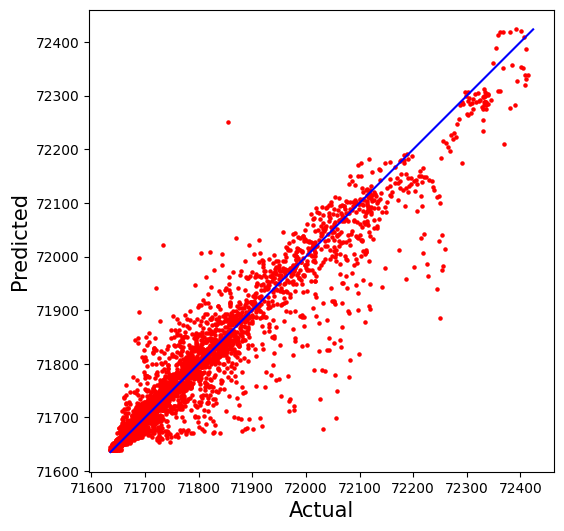

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")
rmse_train_list_1_val_opt, nse_train_list_1_val_opt, rmse_list_1_val_opt, nse_list_1_val_opt, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

### Com treino em 2018/2019/2020 e teste em 2021+2022

Lista de RMSE: [29.174320882527635]
Lista de NSE: [0.8809821597117633]
The average of the root mean squared error (RMSE) on test set: 29.1743
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.8809821597117633


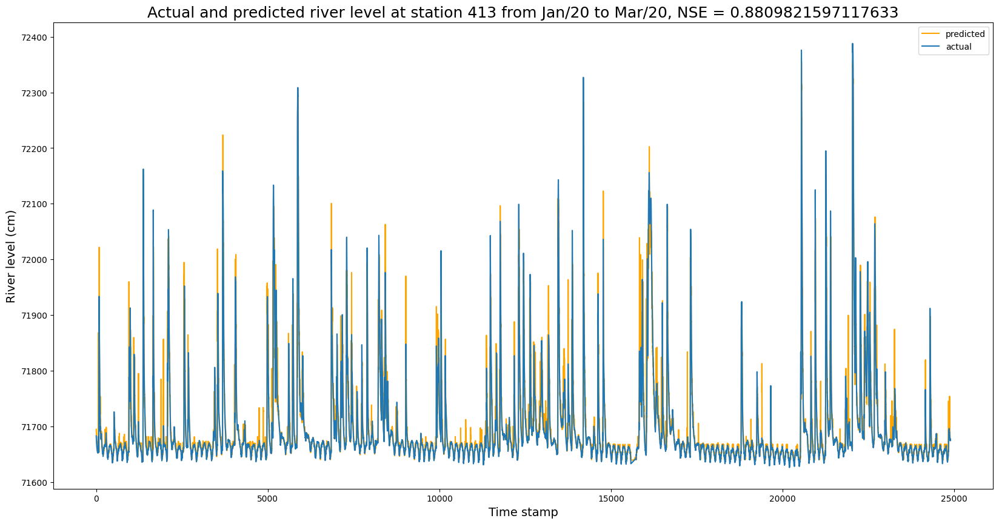

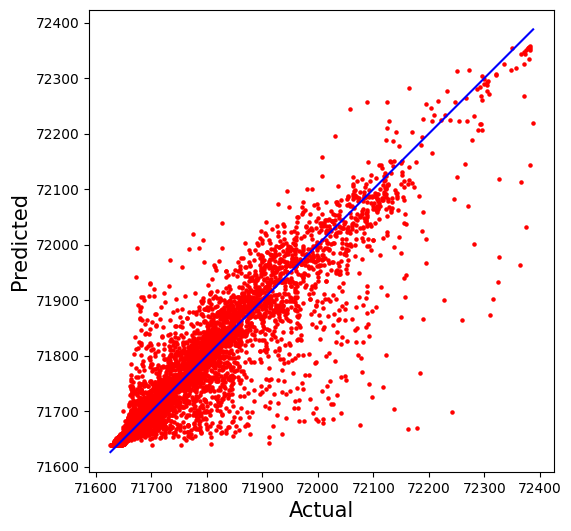

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023],horizon=6)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df,horizon=6)

entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_1_test, nse_train_list_1_test, rmse_list_1_test, nse_list_1_test, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

## Experimento para horizonte de 2 horas (Exp. 5: Nível exutório e todos os pluviômetros da bacia)

### Com treino em 2018/2019 e validação em 2020

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023],horizon=12)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df,horizon=12)

Lista de RMSE: [44.59212377548635]
Lista de NSE: [0.8097776936081011]
The average of the root mean squared error (RMSE) on test set: 44.5921
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.8097776936081011


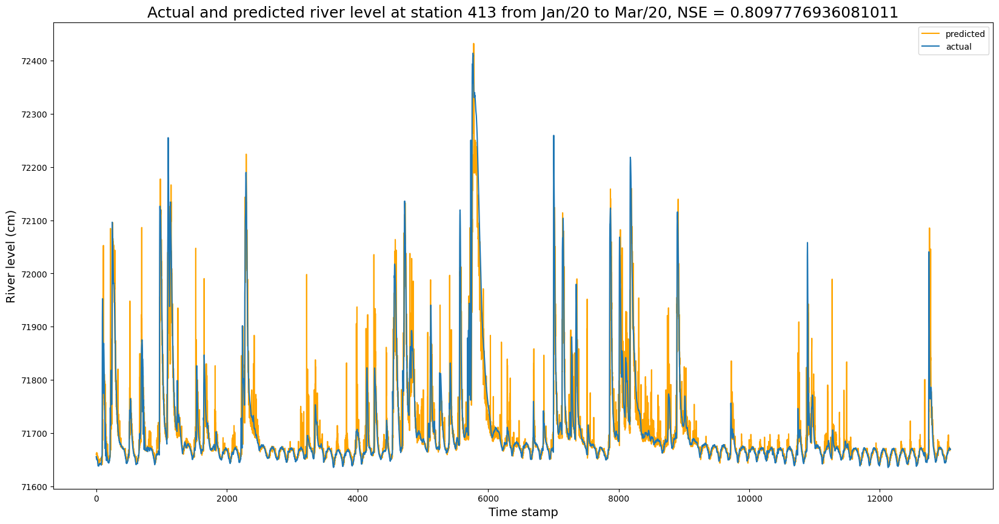

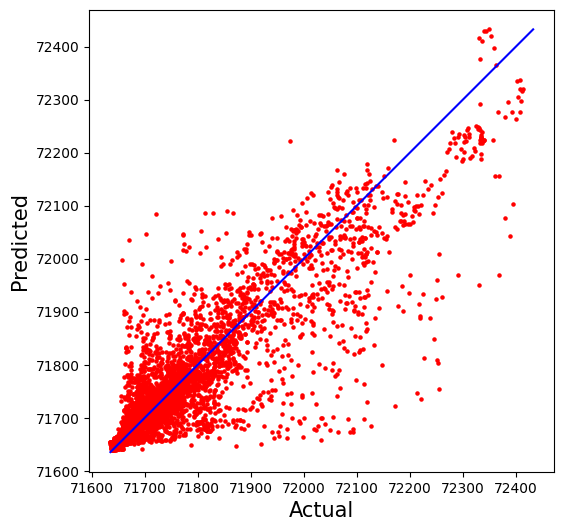

In [ ]:
entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_2_val, nse_train_list_2_val, rmse_list_2_val, nse_list_2_val, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

N_estimators: 200, max_depth: 18, min_samples_split: 20, min_samples_leaf: 4
Lista de RMSE: [42.654395985096464]
Lista de NSE: [0.8259505231535894]
The average of the root mean squared error (RMSE) on test set: 42.6544
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.8259505231535894


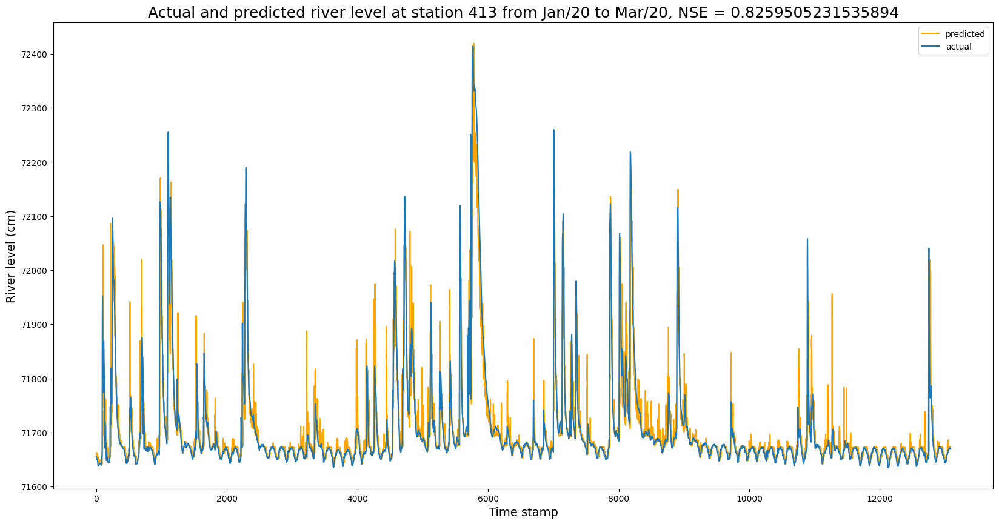

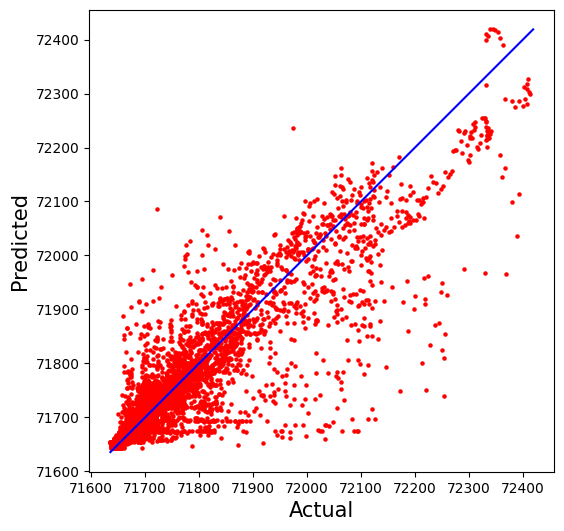

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")
rmse_train_list_2_val_opt, nse_train_list_2_val_opt, rmse_list_2_val_opt, nse_list_2_val_opt, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

### Com treino em 2018/2019/2020 e teste em 2021+2022

Lista de RMSE: [45.38410827430715]
Lista de NSE: [0.7121187723879585]
The average of the root mean squared error (RMSE) on test set: 45.3841
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.7121187723879585


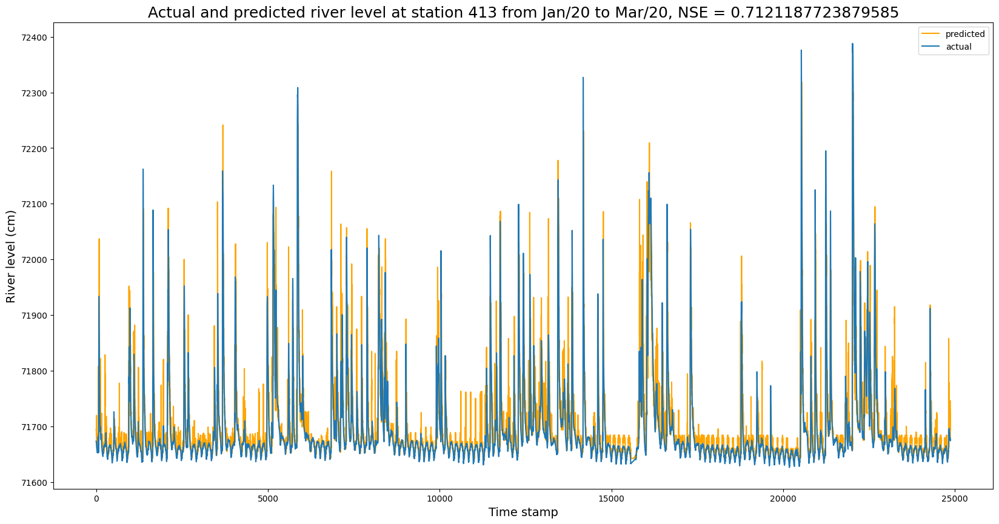

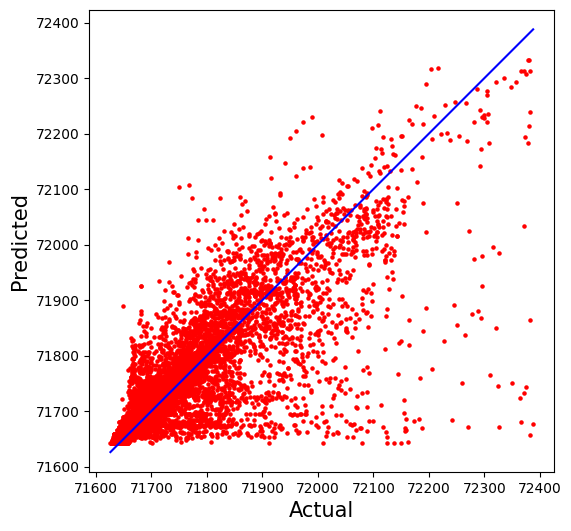

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023],horizon=12)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df,horizon=12)

entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_2_test, nse_train_list_2_test, rmse_list_2_test, nse_list_2_test, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

## Experimento para horizonte de 3 horas (Exp. 5: Nível exutório e todos os pluviômetros da bacia)

### Com treino em 2018/2019 e validação em 2020

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023],horizon=18)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df,horizon=18)

Lista de RMSE: [56.70518936774154]
Lista de NSE: [0.6924986958063641]
The average of the root mean squared error (RMSE) on test set: 56.7052
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.6924986958063641


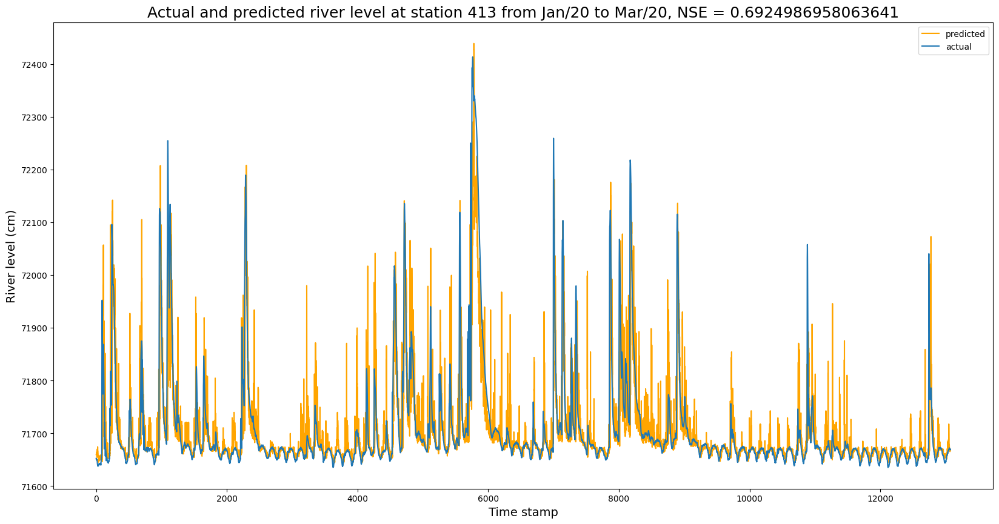

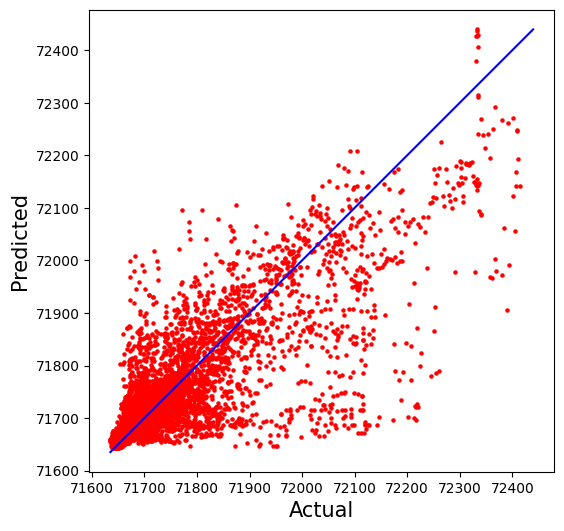

In [ ]:
entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_3_val, nse_train_list_3_val, rmse_list_3_val, nse_list_3_val, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

N_estimators: 200, max_depth: 20, min_samples_split: 20, min_samples_leaf: 4
Lista de RMSE: [54.84239738994678]
Lista de NSE: [0.7123699779571842]
The average of the root mean squared error (RMSE) on test set: 54.8424
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.7123699779571842


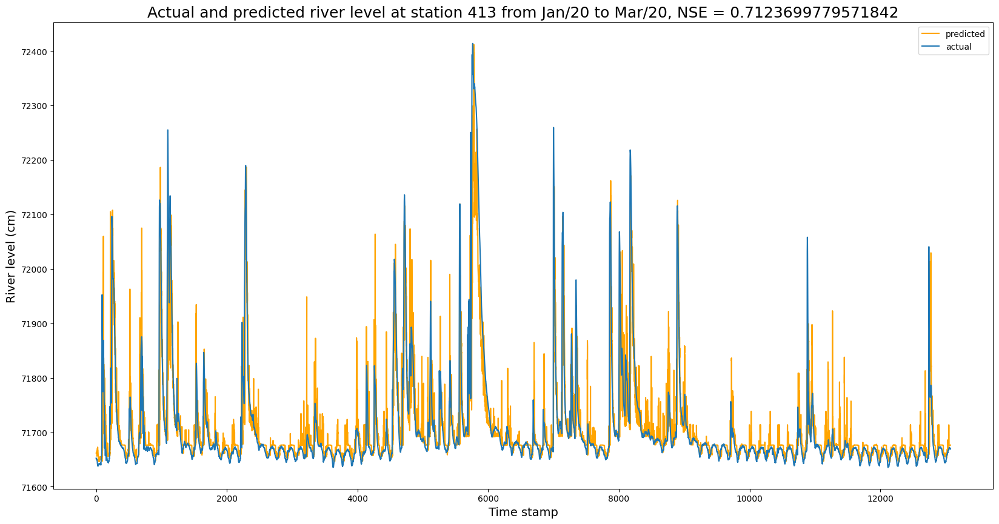

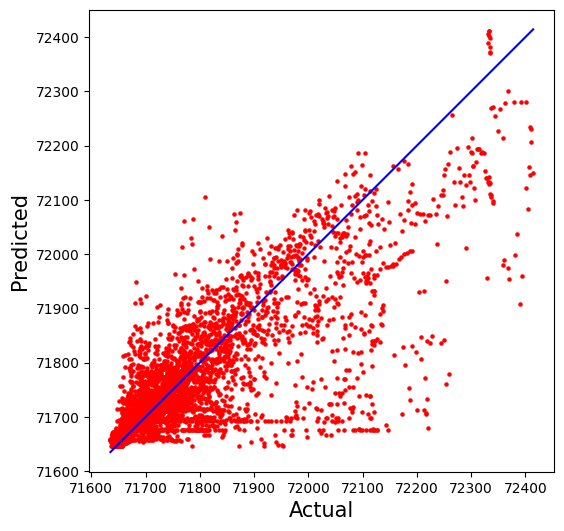

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")
rmse_train_list_3_val_opt, nse_train_list_3_val_opt, rmse_list_3_val_opt, nse_list_3_val_opt, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

### Com treino em 2018/2019/2020 e teste em 2021+2022

Lista de RMSE: [56.97683093746151]
Lista de NSE: [0.546475228666682]
The average of the root mean squared error (RMSE) on test set: 56.9768
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.546475228666682


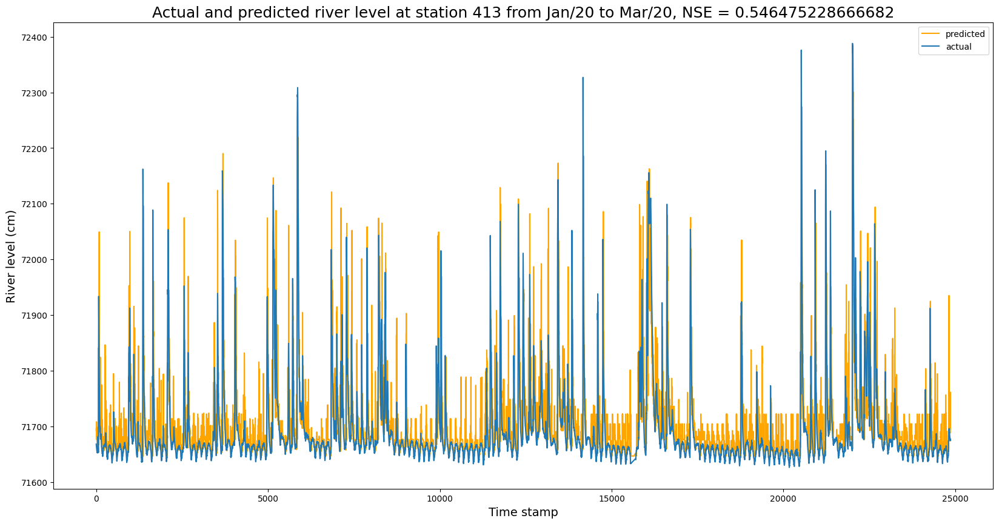

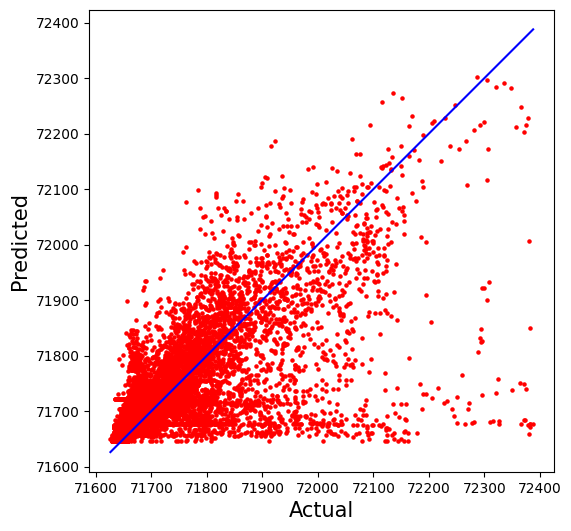

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023],horizon=18)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df,horizon=18)

entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_3_test, nse_train_list_3_test, rmse_list_3_test, nse_list_3_test, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

## Experimento para horizonte de 4 horas (Exp. 5: Nível exutório e todos os pluviômetros da bacia)

### Com treino em 2018/2019 e validação em 2020

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023],horizon=24)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df,horizon=24)

Lista de RMSE: [68.17582033105249]
Lista de NSE: [0.5556503474131205]
The average of the root mean squared error (RMSE) on test set: 68.1758
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.5556503474131205


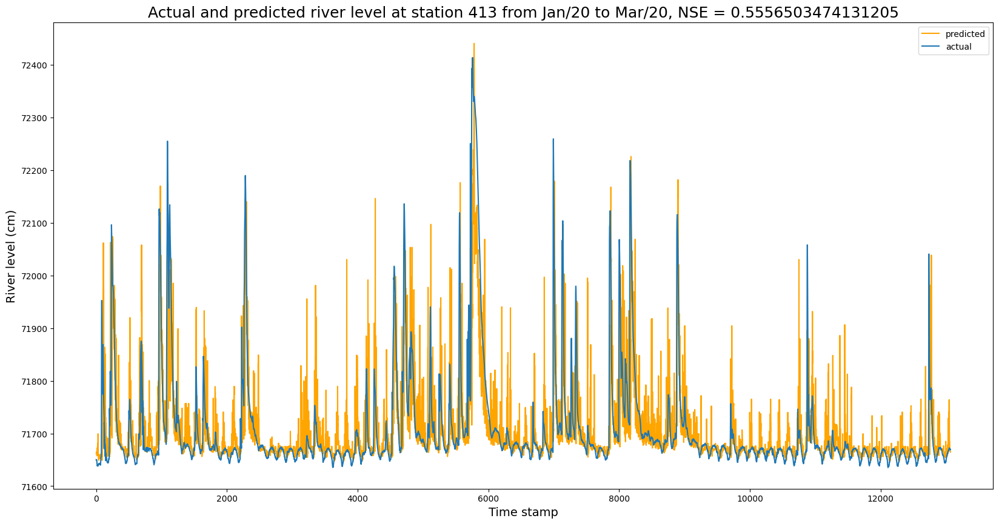

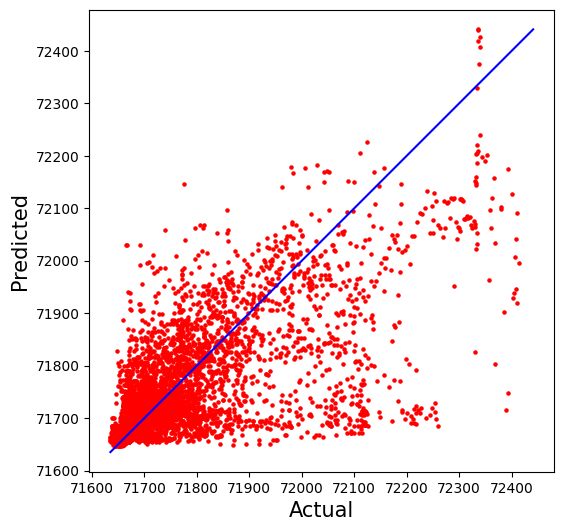

In [ ]:
entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_4_val, nse_train_list_4_val, rmse_list_4_val, nse_list_4_val, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

N_estimators: 100, max_depth: 20, min_samples_split: 9, min_samples_leaf: 20
Lista de RMSE: [65.83035255188675]
Lista de NSE: [0.5856985414972988]
The average of the root mean squared error (RMSE) on test set: 65.8304
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.5856985414972988


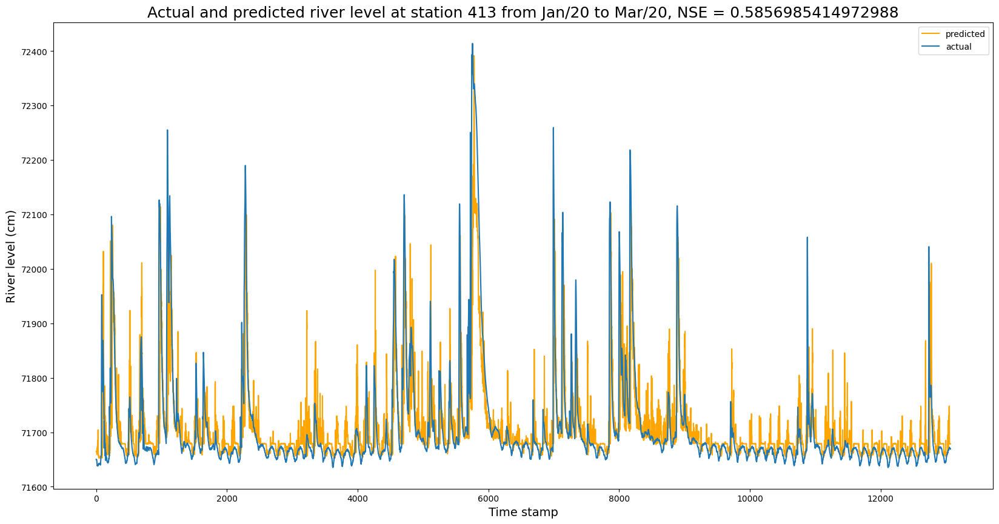

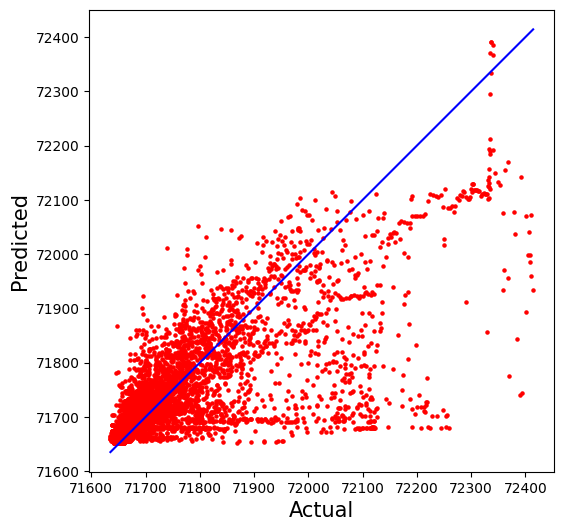

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")
rmse_train_list_4_val_opt, nse_train_list_4_val_opt, rmse_list_4_val_opt, nse_list_4_val_opt, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

### Com treino em 2018/2019/2020 e teste em 2021+2022

Lista de RMSE: [67.78995738052495]
Lista de NSE: [0.35828974502486866]
The average of the root mean squared error (RMSE) on test set: 67.7900
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.35828974502486866


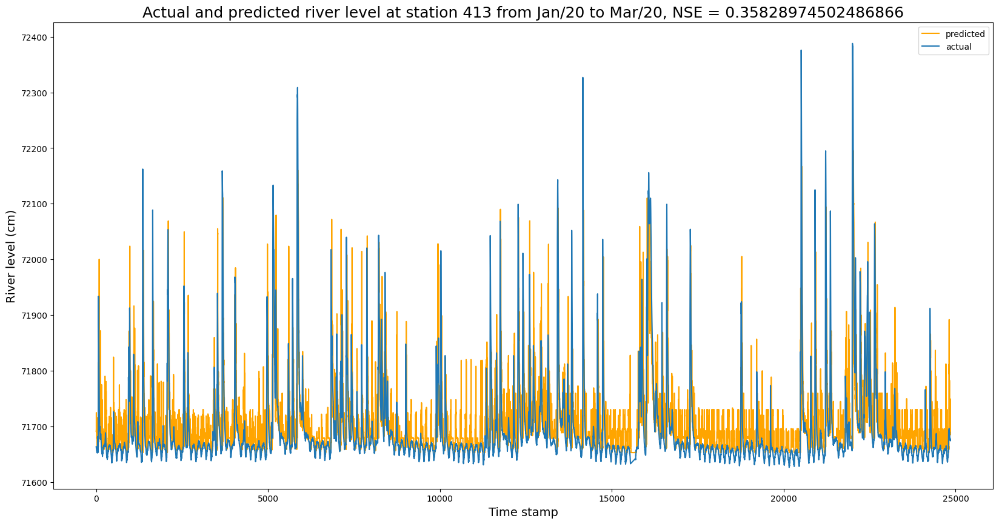

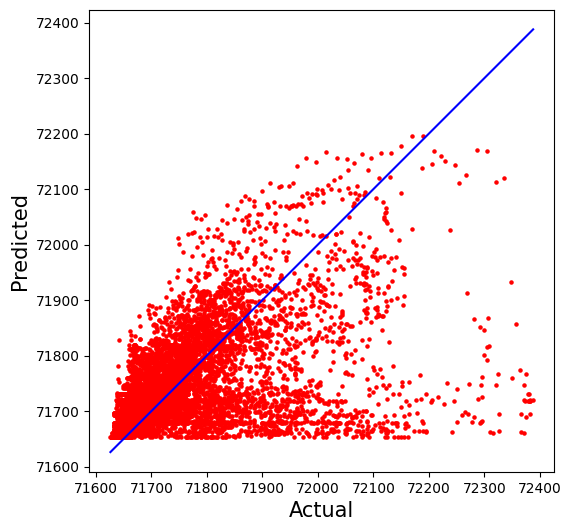

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023],horizon=24)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df,horizon=24)

entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_4_test, nse_train_list_4_test, rmse_list_4_test, nse_list_4_test, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

## Experimento para horizonte de 5 horas (Exp. 5: Nível exutório e todos os pluviômetros da bacia)

### Com treino em 2018/2019 e validação em 2020

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023],horizon=30)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df,horizon=30)

Lista de RMSE: [78.04626778004507]
Lista de NSE: [0.41785027074242564]
The average of the root mean squared error (RMSE) on test set: 78.0463
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.41785027074242564


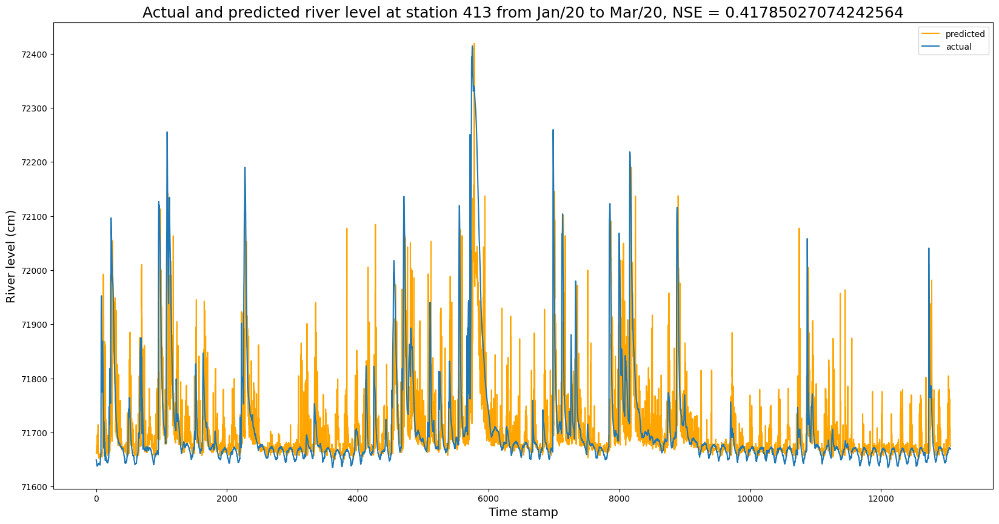

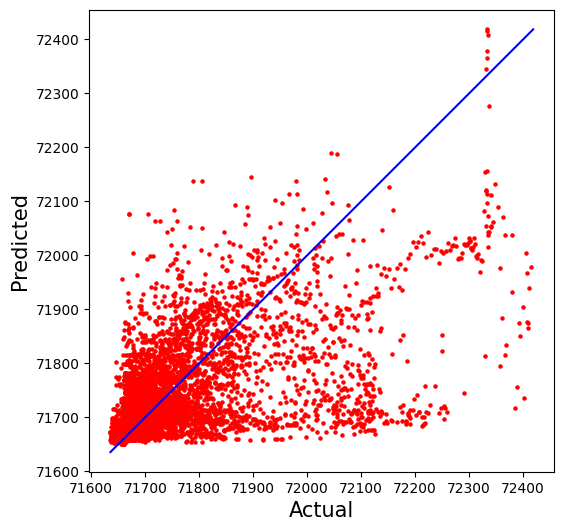

In [ ]:
entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_5_val, nse_train_list_5_val, rmse_list_5_val, nse_list_5_val, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

N_estimators: 150, max_depth: 20, min_samples_split: 2, min_samples_leaf: 16
Lista de RMSE: [75.13095128362073]
Lista de NSE: [0.4605288851422348]
The average of the root mean squared error (RMSE) on test set: 75.1310
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.4605288851422348


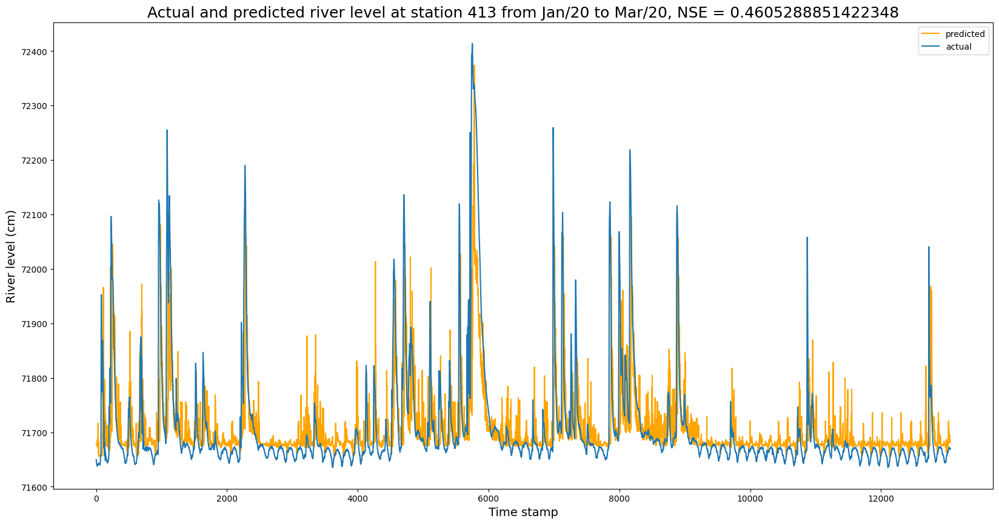

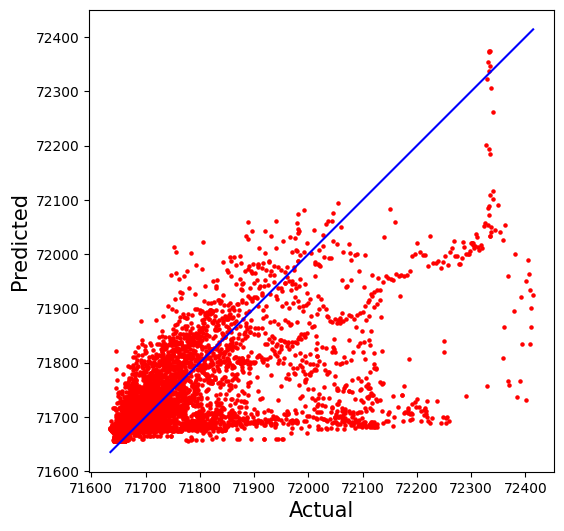

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")
rmse_train_list_5_val_opt, nse_train_list_5_val_opt, rmse_list_5_val_opt, nse_list_5_val_opt, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

### Com treino em 2018/2019/2020 e teste em 2021+2022

Lista de RMSE: [74.50847538449129]
Lista de NSE: [0.22512932306173805]
The average of the root mean squared error (RMSE) on test set: 74.5085
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.22512932306173805


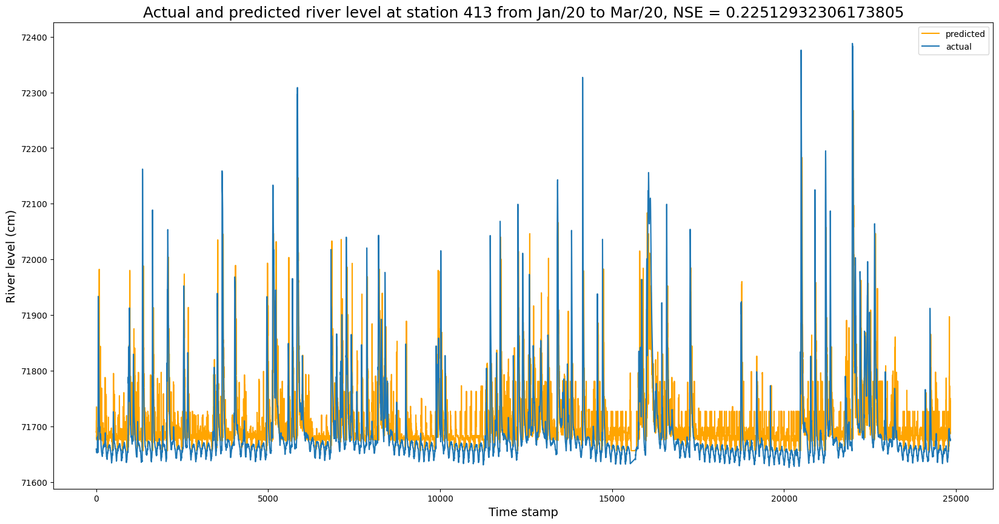

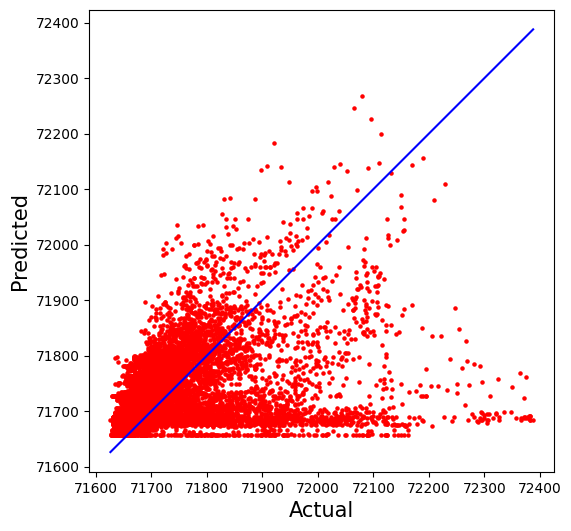

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023],horizon=30)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df,horizon=30)

entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_5_test, nse_train_list_5_test, rmse_list_5_test, nse_list_5_test, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

## Experimento para horizonte de 6 horas (Exp. 5: Nível exutório e todos os pluviômetros da bacia)

### Com treino em 2018/2019 e validação em 2020

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023],horizon=36)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df,horizon=36)

Lista de RMSE: [85.67426859308289]
Lista de NSE: [0.2987008525792725]
The average of the root mean squared error (RMSE) on test set: 85.6743
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.2987008525792725


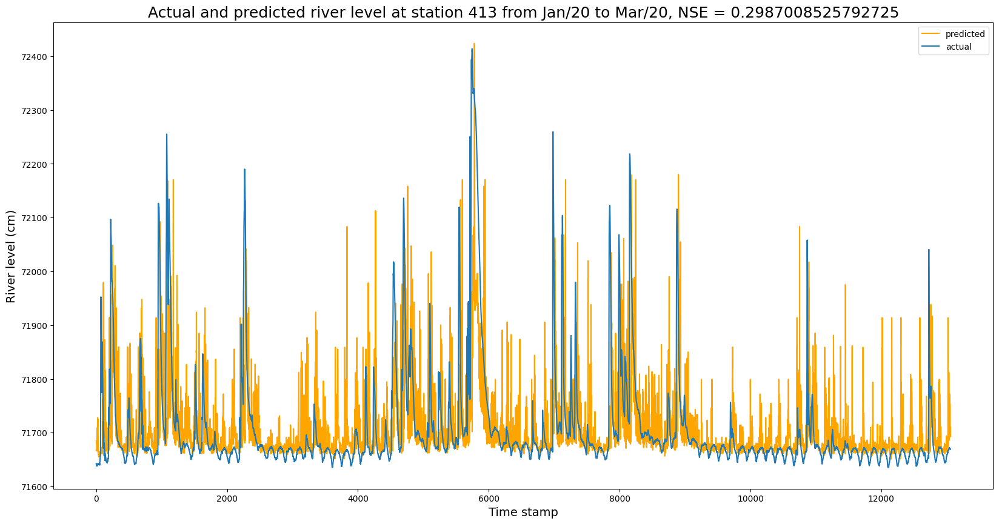

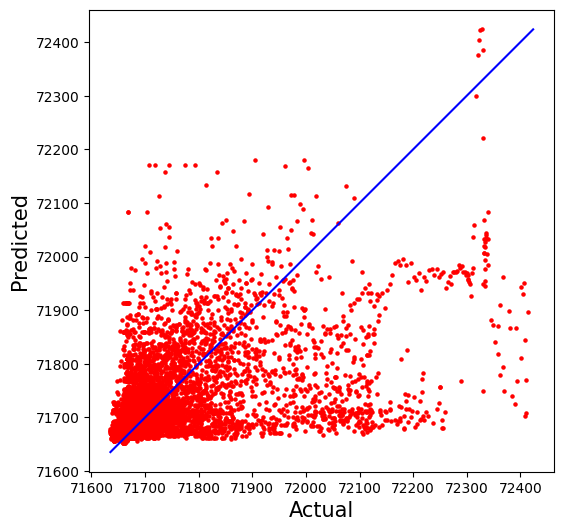

In [ ]:
entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_6_val, nse_train_list_6_val, rmse_list_6_val, nse_list_6_val, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

N_estimators: 200, max_depth: 20, min_samples_split: 7, min_samples_leaf: 19
Lista de RMSE: [81.73203868702582]
Lista de NSE: [0.36175537849695905]
The average of the root mean squared error (RMSE) on test set: 81.7320
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.36175537849695905


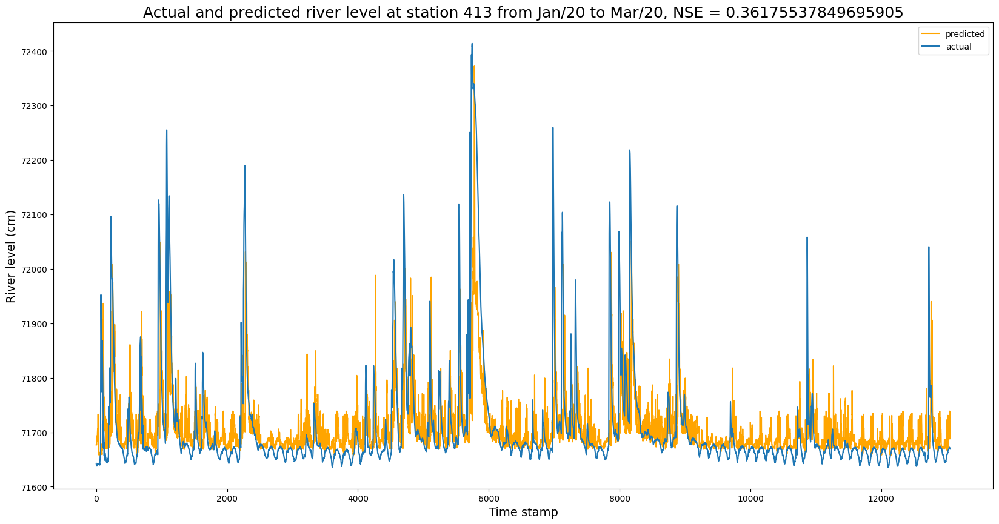

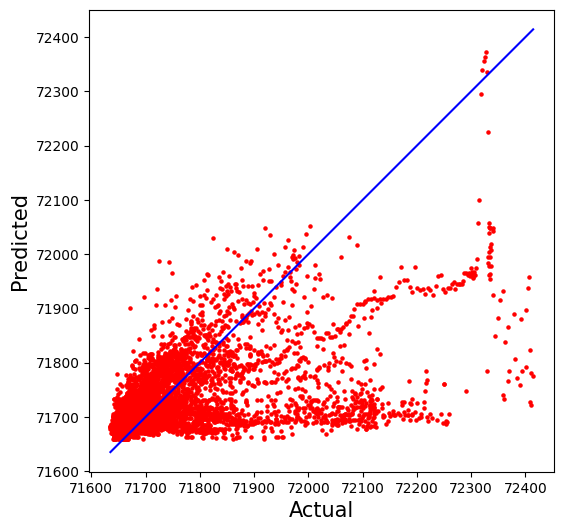

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")
rmse_train_list_6_val_opt, nse_train_list_6_val_opt, rmse_list_6_val_opt, nse_list_6_val_opt, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

### Com treino em 2018/2019/2020 e teste em 2021+2022

Lista de RMSE: [79.49951116616192]
Lista de NSE: [0.11821245094490418]
The average of the root mean squared error (RMSE) on test set: 79.4995
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.11821245094490418


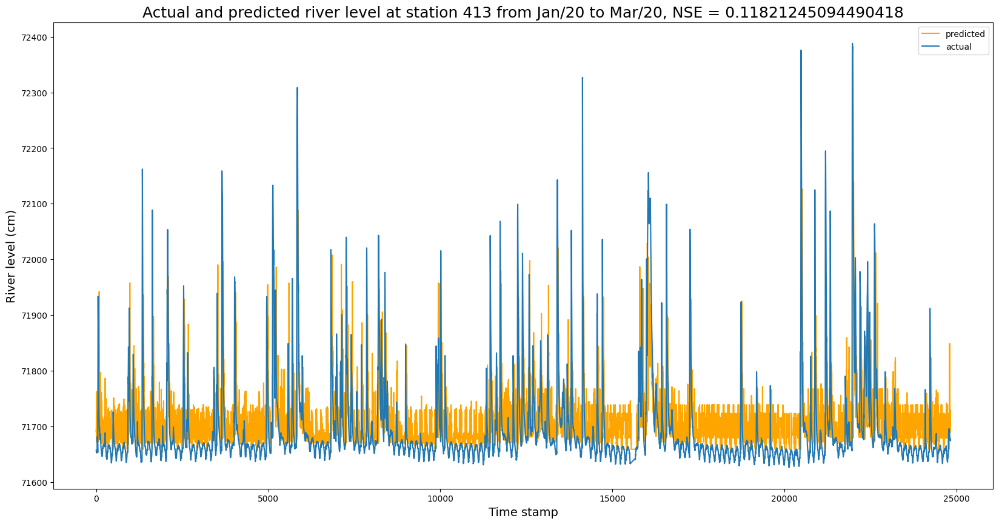

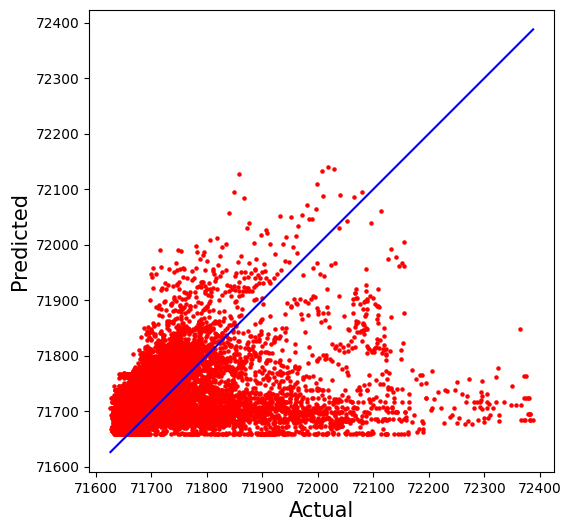

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023],horizon=36)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df,horizon=36)

entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_6_test, nse_train_list_6_test, rmse_list_6_test, nse_list_6_test, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

## Experimento para horizonte de 7 horas (Exp. 5: Nível exutório e todos os pluviômetros da bacia)

### Com treino em 2018/2019 e validação em 2020

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023],horizon=42)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df,horizon=42)

Lista de RMSE: [91.97029903012665]
Lista de NSE: [0.19204612968132095]
The average of the root mean squared error (RMSE) on test set: 91.9703
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.19204612968132095


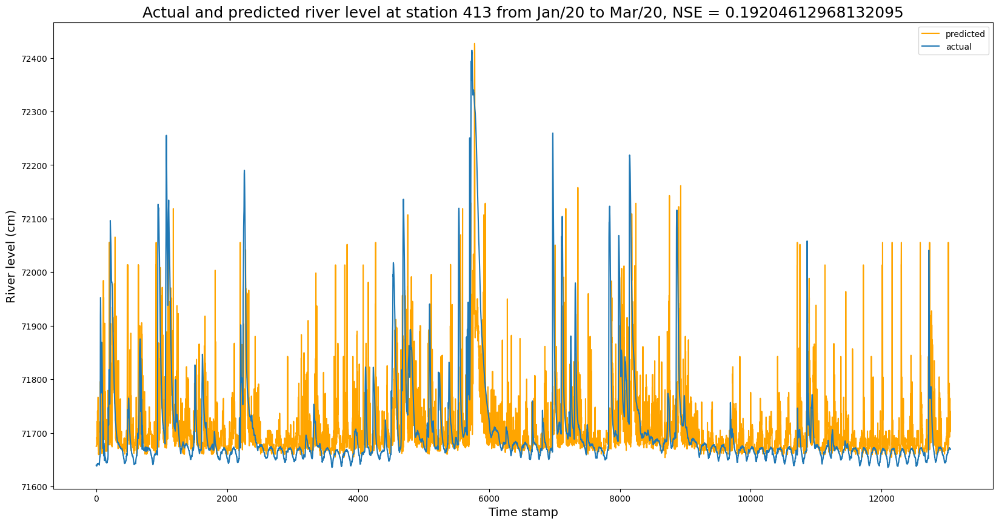

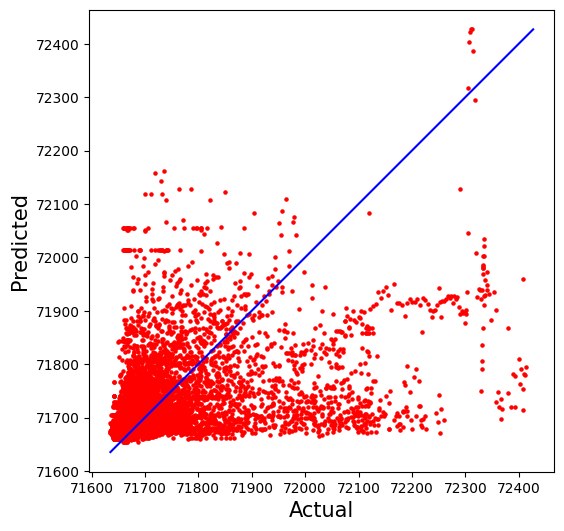

In [ ]:
entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_7_val, nse_train_list_7_val, rmse_list_7_val, nse_list_7_val, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

N_estimators: 50, max_depth: 20, min_samples_split: 6, min_samples_leaf: 19
Lista de RMSE: [86.96297888291888]
Lista de NSE: [0.2776291966335027]
The average of the root mean squared error (RMSE) on test set: 86.9630
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.2776291966335027


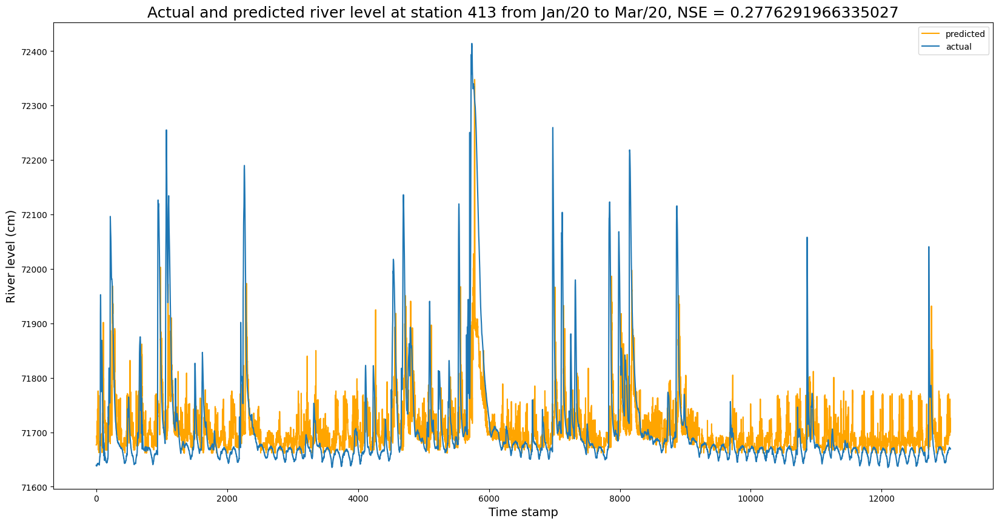

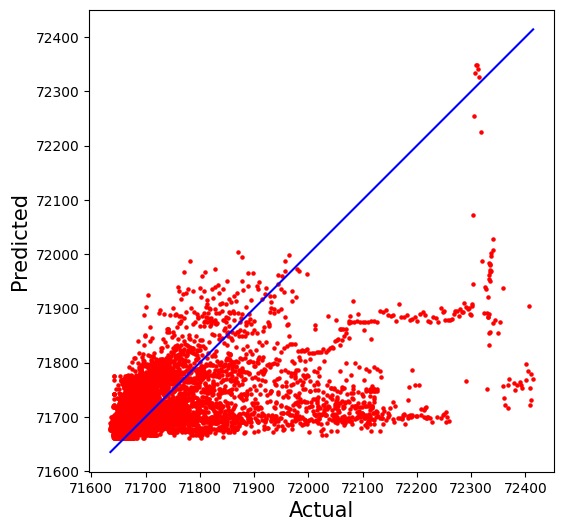

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")
rmse_train_list_7_val_opt, nse_train_list_7_val_opt, rmse_list_7_val_opt, nse_list_7_val_opt, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

### Com treino em 2018/2019/2020 e teste em 2021+2022

Lista de RMSE: [83.21253329101945]
Lista de NSE: [0.034311889072839]
The average of the root mean squared error (RMSE) on test set: 83.2125
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.034311889072839


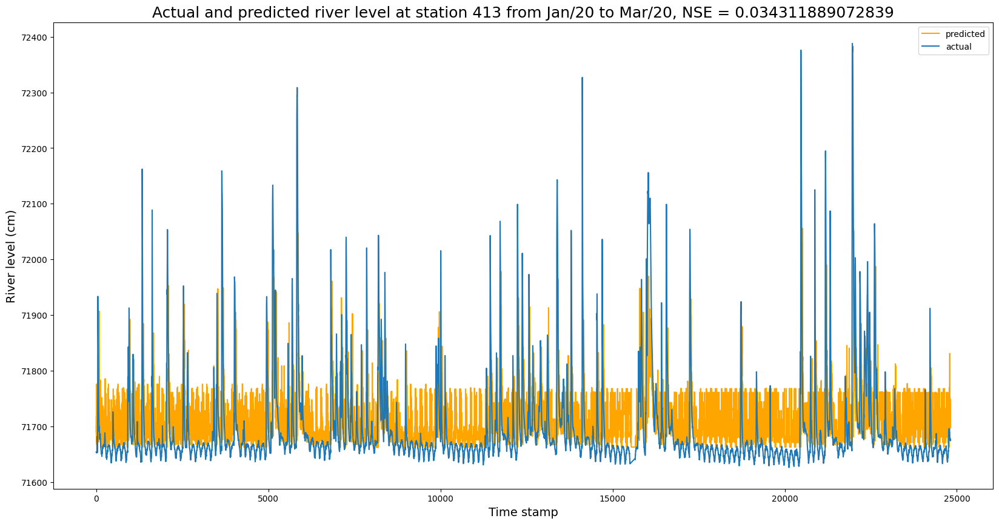

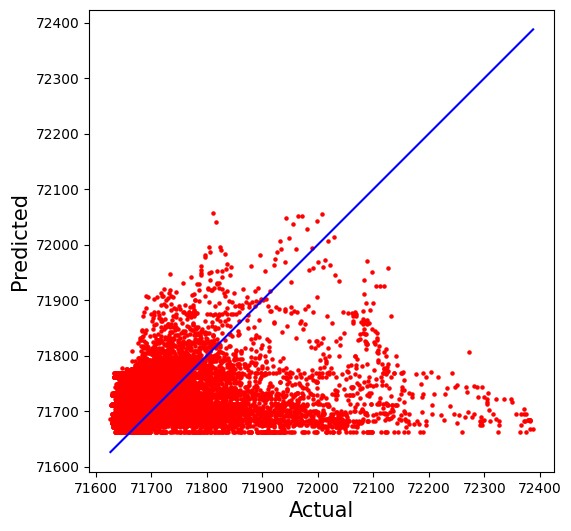

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023],horizon=42)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df,horizon=42)

entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_7_test, nse_train_list_7_test, rmse_list_7_test, nse_list_7_test, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

## Experimento para horizonte de 8 horas (Exp. 5: Nível exutório e todos os pluviômetros da bacia)

### Com treino em 2018/2019 e validação em 2020

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023],horizon=48)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df,horizon=48)

Lista de RMSE: [96.43511643161]
Lista de NSE: [0.11191429450576884]
The average of the root mean squared error (RMSE) on test set: 96.4351
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.11191429450576884


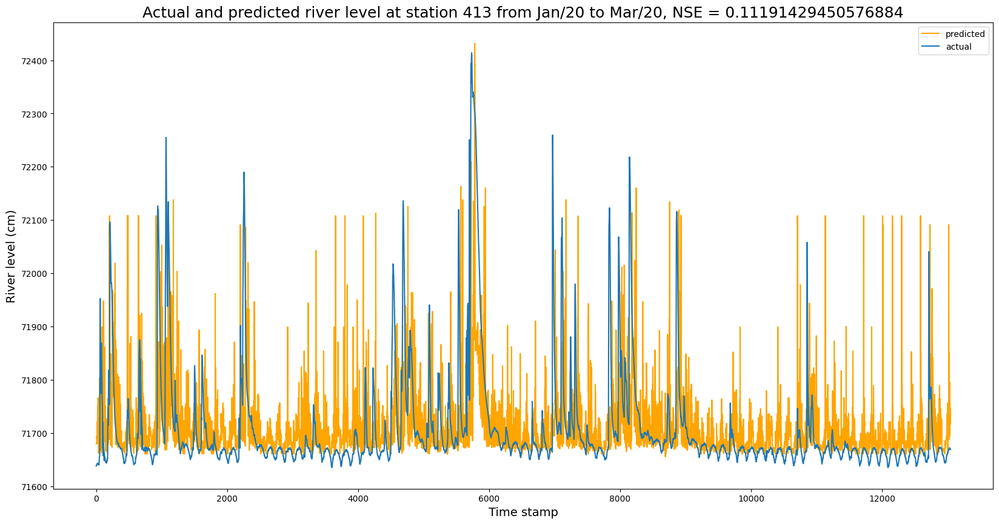

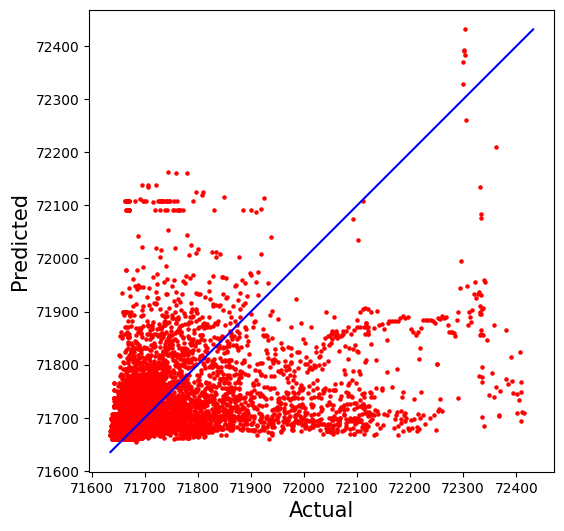

In [ ]:
entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_8_val, nse_train_list_8_val, rmse_list_8_val, nse_list_8_val, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

N_estimators: 50, max_depth: 19, min_samples_split: 3, min_samples_leaf: 18
Lista de RMSE: [90.75469153890927]
Lista de NSE: [0.21345670811188078]
The average of the root mean squared error (RMSE) on test set: 90.7547
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.21345670811188078


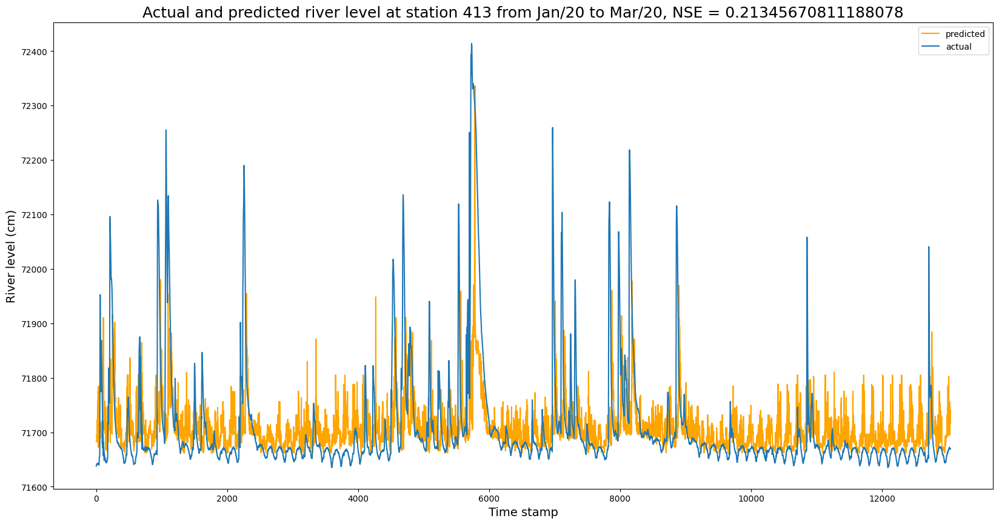

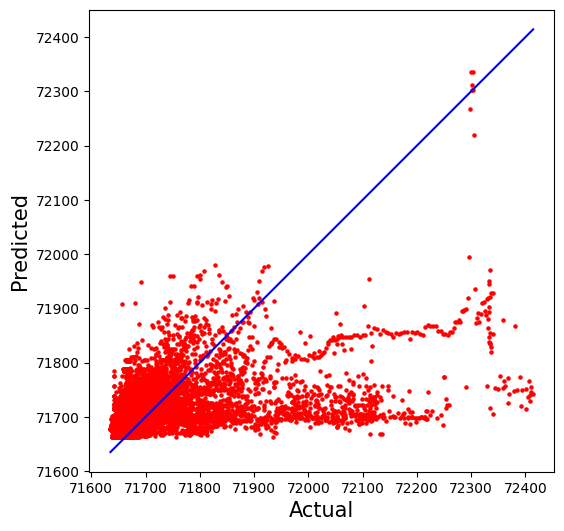

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")
rmse_train_list_8_val_opt, nse_train_list_8_val_opt, rmse_list_8_val_opt, nse_list_8_val_opt, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

### Com treino em 2018/2019/2020 e teste em 2021+2022

Lista de RMSE: [84.91410443218241]
Lista de NSE: [-0.005183572694799299]
The average of the root mean squared error (RMSE) on test set: 84.9141
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: -0.005183572694799299


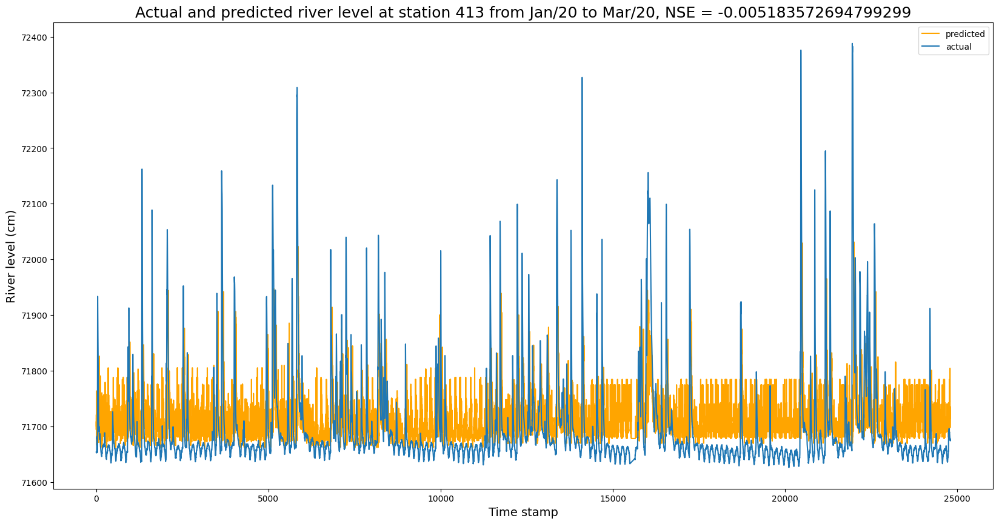

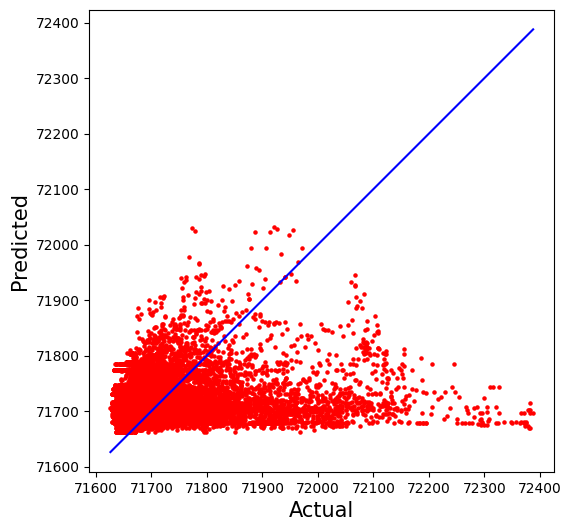

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023],horizon=48)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df,horizon=48)

entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)

X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_8_test, nse_train_list_8_test, rmse_list_8_test, nse_list_8_test, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

## Comparação da performance

NSE

Text(0.5, 1.0, 'NSE for different forecasting horizons')

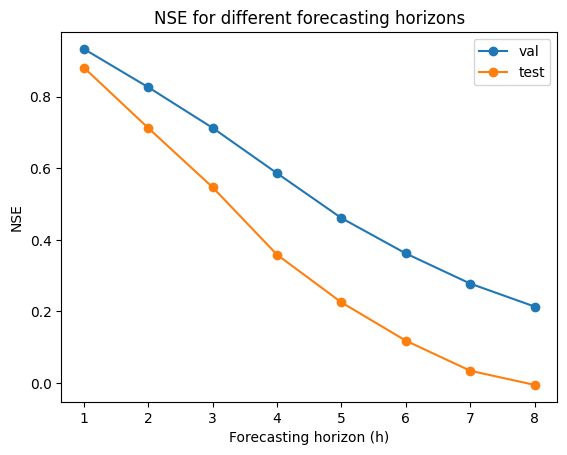

In [ ]:
nse = [nse_list_1_val_opt,nse_list_2_val_opt,nse_list_3_val_opt,nse_list_4_val_opt,nse_list_5_val_opt,nse_list_6_val_opt,nse_list_7_val_opt,nse_list_8_val_opt]
horizon = [1,2,3,4,5,6,7,8]
plt.plot(horizon, nse,marker='o',label='val')
nse = [nse_list_1_test,nse_list_2_test,nse_list_3_test,nse_list_4_test,nse_list_5_test,nse_list_6_test,nse_list_7_test,nse_list_8_test]
horizon = [1,2,3,4,5,6,7,8]
plt.plot(horizon, nse,marker='o',label='test')

plt.xlabel('Forecasting horizon (h)')
plt.ylabel('NSE')
plt.legend()

plt.title('NSE for different forecasting horizons')

RMSE

Text(0.5, 1.0, 'RMSE for different forecasting horizons')

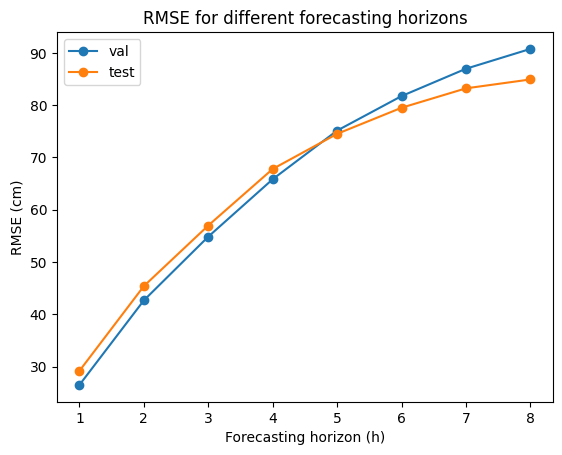

In [ ]:
rmse = [rmse_list_1_val_opt,rmse_list_2_val_opt,rmse_list_3_val_opt,rmse_list_4_val_opt,rmse_list_5_val_opt,rmse_list_6_val_opt,rmse_list_7_val_opt,rmse_list_8_val_opt]
horizon = [1,2,3,4,5,6,7,8]
plt.plot(horizon, rmse,marker='o',label='val')
rmse = [rmse_list_1_test,rmse_list_2_test,rmse_list_3_test,rmse_list_4_test,rmse_list_5_test,rmse_list_6_test,rmse_list_7_test,rmse_list_8_test]
horizon = [1,2,3,4,5,6,7,8]
plt.plot(horizon, rmse,marker='o',label='test')

plt.xlabel('Forecasting horizon (h)')
plt.ylabel('RMSE (cm)')
plt.legend()

plt.title('RMSE for different forecasting horizons')

# Parte 3: Experimentos com Lag Features de Todas as Séries (TALVEZ EXCLUIR ESSA SEÇÃO)

## Experimentos Multivariate com Random Forest (Validando em 2020)

### Usando todas as features

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023])
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df)

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_list_all_train, nse_list_all_train, rmse_list_all, nse_list_all, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

KeyboardInterrupt: ignored

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")

rmse_list_all_train, nse_list_all_train, rmse_list_all, nse_list_all, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

### Aplicando Filtro de Correlação

In [ ]:
# FILTRO DE CORRELAÇÃO DE 0.95
correlated_features = set()
correlation_matrix = X_train_general.corr(method='pearson')

alvo = y_train_general['valor_leitura_flu_413(t+12)']

for i in range(len(correlation_matrix .columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) > 0.95:
            # Vamos comparar com o nosso alvo e manter apenas a que tem maior correlação com o alvo
            if(alvo.corr(X_train_general.iloc[:,j])>alvo.corr(X_train_general.iloc[:,j])):
              colname = correlation_matrix.columns[i]
            else:
              colname = correlation_matrix.columns[j]
            correlated_features.add(colname)
print("Quantidade de features a eliminar: ",len(correlated_features))
print(correlated_features)

X_train = X_train_general.drop(labels=correlated_features, axis=1)
X_val = X_val_general.drop(labels=correlated_features, axis=1)
X_test = X_test_general.drop(labels=correlated_features, axis=1)

# Obtém os nomes das colunas
feature_names = X_train.columns

X_train = np.array(X_train)
X_val = np.array(X_val)
X_test = np.array(X_test)

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")

rmse_list_all_uncorr_train, nse_list_all_uncorr_train, rmse_list_all_uncorr, nse_list_all_uncorr, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

Análise da importância das features

In [ ]:
# Based on: https://towardsdatascience.com/machine-learning-for-forecasting-supervised-learning-with-multivariate-time-series-b5b5044fe068
# Ordena as features pelo valor de importância
indices = np.argsort(importances)[::-1]

# Plota o gráfico de barras com os nomes das features
plt.figure(figsize=(10, 5))
plt.title("Feature importances")
plt.bar(range(10), importances[indices[0:10]],
        color="b", align="center")
plt.xticks(range(10), feature_names[indices[0:10]], rotation='vertical')
plt.xlim([-1, 10])

#plt.bar(range(X_train.shape[1]), importances[indices],
#        color="b", align="center")
#plt.xticks(range(X_train.shape[1]), feature_names[indices], rotation='vertical')
#plt.xlim([-1, X_train.shape[1]])
plt.show()

### Aplicando Filtro de Correlação e Recursive Filter elimination

In [ ]:
# FILTRO DE CORRELAÇÃO DE 0.95
correlated_features = set()
correlation_matrix = X_train_general.corr(method='pearson')

alvo = y_train_general['valor_leitura_flu_413(t+12)']

for i in range(len(correlation_matrix .columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) > 0.95:
            # Vamos comparar com o nosso alvo e manter apenas a que tem maior correlação com o alvo
            if(alvo.corr(X_train_general.iloc[:,j])>alvo.corr(X_train_general.iloc[:,j])):
              colname = correlation_matrix.columns[i]
            else:
              colname = correlation_matrix.columns[j]
            correlated_features.add(colname)
print("Quantidade de features a eliminar: ",len(correlated_features))
print(correlated_features)

X_train = X_train_general.drop(labels=correlated_features, axis=1)
X_val = X_val_general.drop(labels=correlated_features, axis=1)
X_test = X_test_general.drop(labels=correlated_features, axis=1)

# Recursive Filter Elimination
from sklearn.feature_selection import RFE
# perform feature selection while fitting random forest
rfe = RFE(RandomForestRegressor(n_estimators=10,n_jobs=-1,verbose=0), n_features_to_select=100, step = 20)  #step is the number of features to prune at each iteration
fit = rfe.fit(X_train, y_train)

# report selected features
selected = []

print('Selected Features:')
names = X_train.columns.values
for i in range(len(fit.support_)):
  if fit.support_[i]:
    print(names[i])
    selected.append(names[i])
#plot feature rank
names = X_train.columns.values
ticks = [i for i in range(len(names))]
plt.bar(ticks, fit.ranking_)
plt.xticks(ticks, names)
plt.show()

X_train = X_train[selected]
X_val = X_val[selected]
X_test = X_test[selected]

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")

rmse_list_all_uncorr_rfe_train, nse_list_all_uncorr_rfe_train, rmse_list_all_uncorr_rfe, nse_list_all_uncorr_rfe, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

## Experimentos Multivariate com Random Forest (Testando em 2021+2022)

# Parte 4: Experimentos com Lag Features das Inputs do Experimento 5

## Experimentos Multivariate com Random Forest (Validando em 2020)

### Usando todas as features

The average of the root mean squared error (RMSE) on train set: 13.9124
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.9797677631244885
The average of the root mean squared error (RMSE) on test set: 41.7975
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.8328732238501033


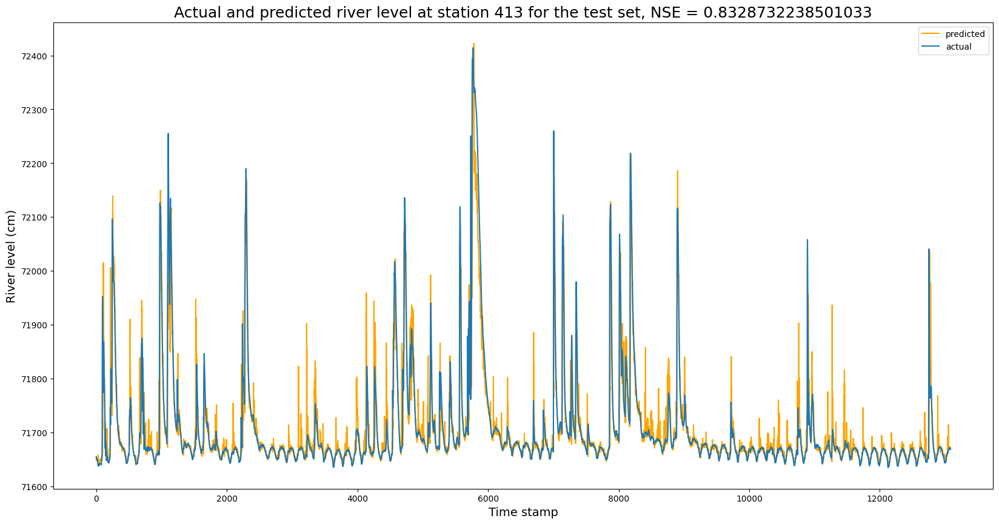

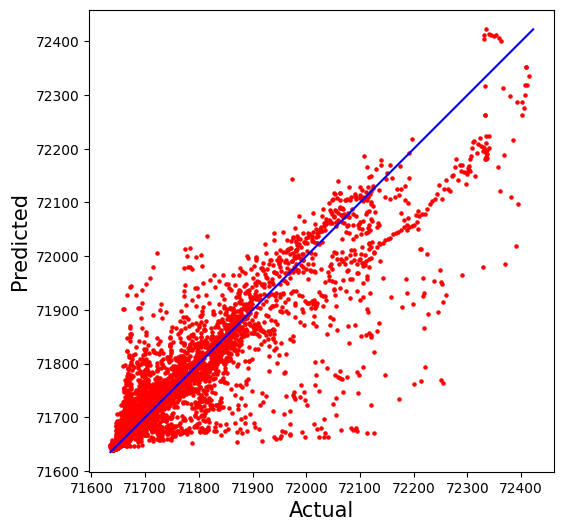

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023])
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_list_all_train, nse_list_all_train, rmse_list_all, nse_list_all, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

N_estimators: 150, max_depth: 20, min_samples_split: 19, min_samples_leaf: 3
building tree 1 of 150
building tree 2 of 150


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.


building tree 3 of 150
building tree 4 of 150
building tree 5 of 150
building tree 6 of 150
building tree 7 of 150
building tree 8 of 150
building tree 9 of 150
building tree 10 of 150
building tree 11 of 150
building tree 12 of 150
building tree 13 of 150
building tree 14 of 150
building tree 15 of 150
building tree 16 of 150
building tree 17 of 150
building tree 18 of 150
building tree 19 of 150
building tree 20 of 150
building tree 21 of 150
building tree 22 of 150
building tree 23 of 150
building tree 24 of 150
building tree 25 of 150
building tree 26 of 150
building tree 27 of 150
building tree 28 of 150
building tree 29 of 150
building tree 30 of 150
building tree 31 of 150
building tree 32 of 150
building tree 33 of 150
building tree 34 of 150
building tree 35 of 150
building tree 36 of 150
building tree 37 of 150building tree 38 of 150



[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:   16.3s


building tree 39 of 150
building tree 40 of 150
building tree 41 of 150
building tree 42 of 150
building tree 43 of 150
building tree 44 of 150
building tree 45 of 150
building tree 46 of 150
building tree 47 of 150
building tree 48 of 150
building tree 49 of 150
building tree 50 of 150
building tree 51 of 150
building tree 52 of 150
building tree 53 of 150
building tree 54 of 150
building tree 55 of 150
building tree 56 of 150
building tree 57 of 150
building tree 58 of 150
building tree 59 of 150
building tree 60 of 150
building tree 61 of 150
building tree 62 of 150
building tree 63 of 150
building tree 64 of 150
building tree 65 of 150
building tree 66 of 150
building tree 67 of 150
building tree 68 of 150
building tree 69 of 150
building tree 70 of 150
building tree 71 of 150
building tree 72 of 150
building tree 73 of 150
building tree 74 of 150
building tree 75 of 150
building tree 76 of 150
building tree 77 of 150
building tree 78 of 150
building tree 79 of 150
building tree 80

[Parallel(n_jobs=-1)]: Done 150 out of 150 | elapsed:  1.1min finished
[Parallel(n_jobs=2)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  37 tasks      | elapsed:    0.0s
[Parallel(n_jobs=2)]: Done 150 out of 150 | elapsed:    0.2s finished
[Parallel(n_jobs=2)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  37 tasks      | elapsed:    0.1s
[Parallel(n_jobs=2)]: Done 150 out of 150 | elapsed:    0.4s finished


The average of the root mean squared error (RMSE) on train set: 29.6851
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.907887099692369
The average of the root mean squared error (RMSE) on test set: 41.2232
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.837434208773472


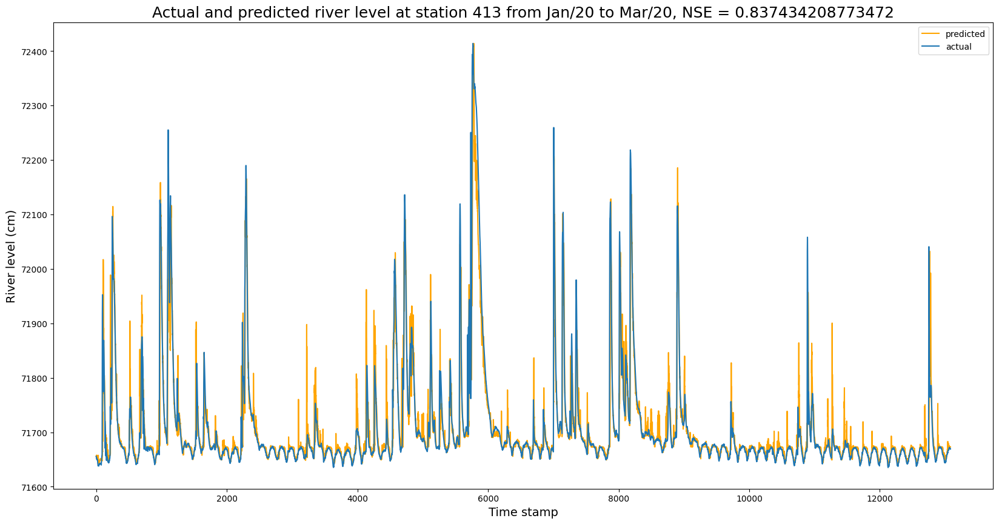

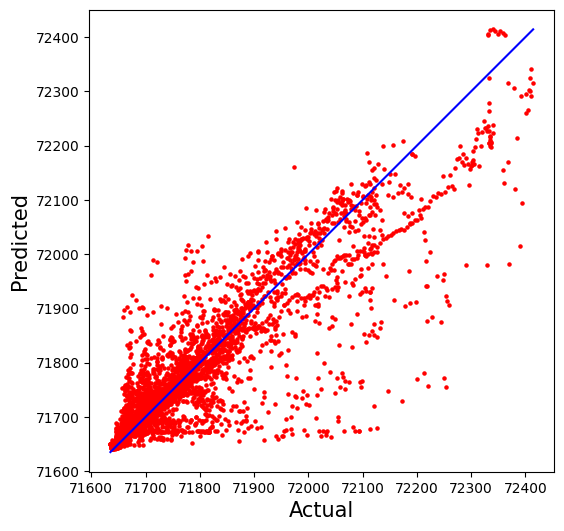

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")

In [ ]:
n_estimators = 150
max_depth = 20
min_samples_split = 19
min_samples_leaf = 3
rmse_list_all_train, nse_list_all_train, rmse_list_all, nse_list_all, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

[I 2023-08-13 17:54:19,153] A new study created in memory with name: no-name-3fba1db6-e506-4db5-bb41-b2754c2b6911
[I 2023-08-13 17:54:30,188] Trial 0 finished with value: 1761.8996665137304 and parameters: {'max_depth': 7, 'learning_rate': 0.011002817226254392, 'n_estimators': 335, 'min_child_weight': 8, 'gamma': 9.728728830009641e-05, 'subsample': 0.02815744802026465, 'colsample_bytree': 0.024895779540435023, 'reg_alpha': 0.012140755068184341, 'reg_lambda': 2.2536511574969237e-07}. Best is trial 0 with value: 1761.8996665137304.
[I 2023-08-13 17:54:42,251] Trial 1 finished with value: 43.6196076511721 and parameters: {'max_depth': 1, 'learning_rate': 0.23481164807395874, 'n_estimators': 479, 'min_child_weight': 1, 'gamma': 0.00012518091079635779, 'subsample': 0.4219314744806921, 'colsample_bytree': 0.16790055575223653, 'reg_alpha': 0.005943503728075847, 'reg_lambda': 2.1627610787257848e-06}. Best is trial 1 with value: 43.6196076511721.
[I 2023-08-13 17:54:56,361] Trial 2 finished wit

The average of the root mean squared error (RMSE) on train set: 22.6278
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.9464787471231563
The average of the root mean squared error (RMSE) on test set: 40.3890
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.8439468982857851


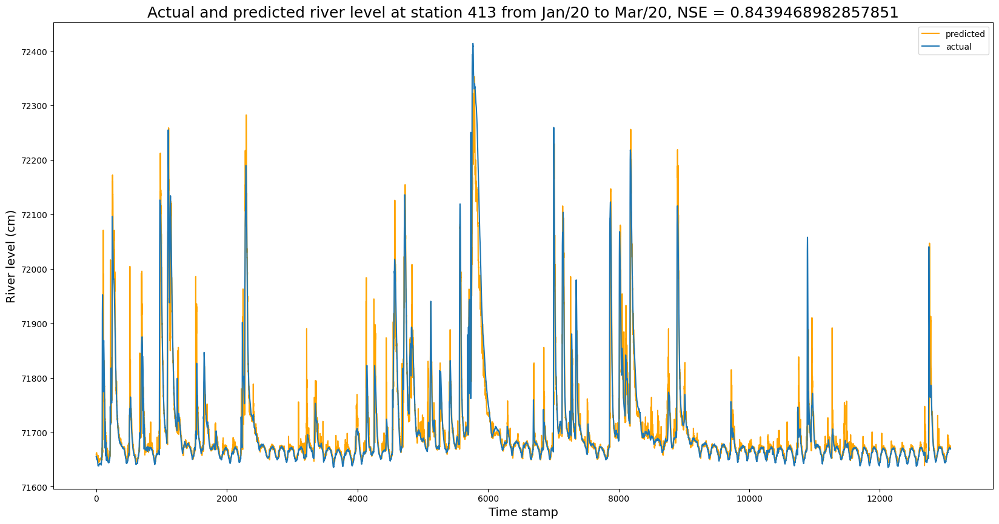

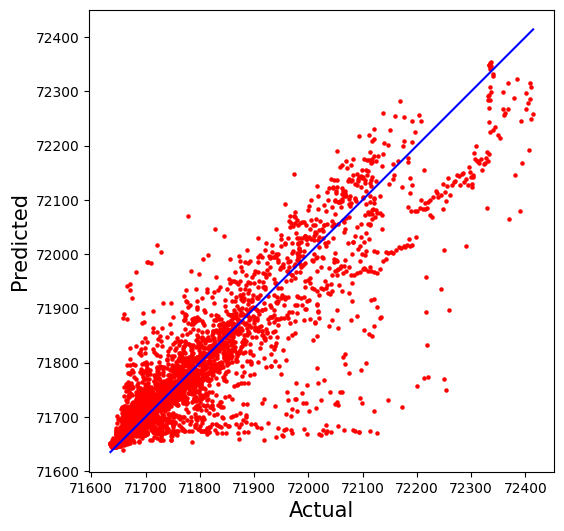

In [ ]:
# Bônus
# Testando XGBoost (Otimizando com Optuna)
trial, max_depth, learning_rate , n_estimators, min_child_weight, gamma, subsample, colsample_bytree, reg_alpha, reg_lambda, = run_optuna_xgb(n_trials=12)
rmse_list_all_train, nse_list_all_train, rmse_list_all, nse_list_all, importances = fit_and_evaluate_xgboost(X_train,y_train,X_val,y_val, X_test,y_test, max_depth = max_depth, learning_rate = learning_rate, n_estimators = n_estimators, min_child_weight = min_child_weight, gamma = gamma,subsample = subsample, colsample_bytree = colsample_bytree, reg_alpha = reg_alpha, reg_lambda = reg_lambda)

### Aplicando Filtro de Correlação

The average of the root mean squared error (RMSE) on train set: 15.9384
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.9734459321060205
The average of the root mean squared error (RMSE) on test set: 41.7562
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.8332036837029341


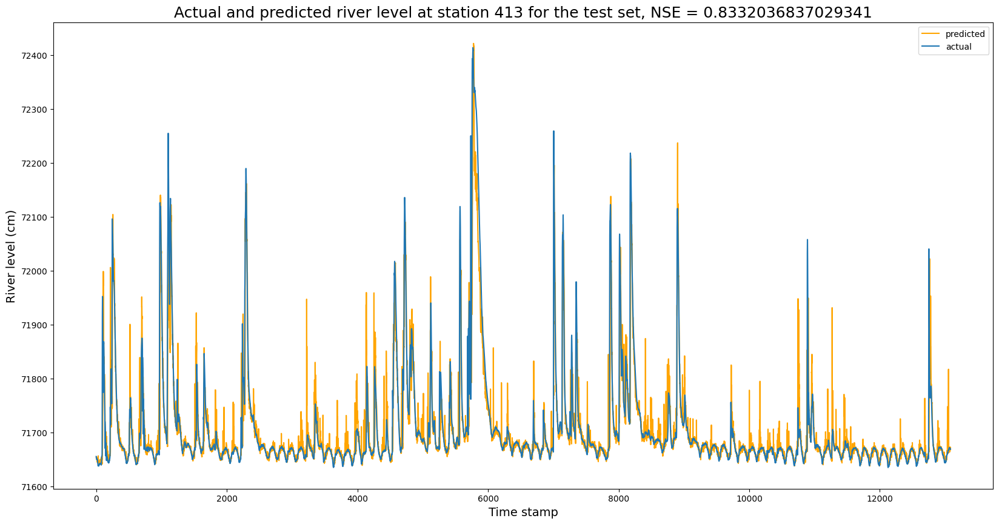

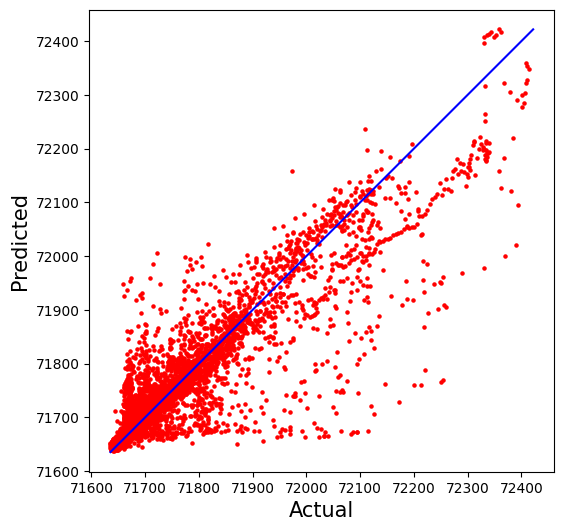

In [ ]:
"""
# FILTRO DE CORRELAÇÃO DE 0.99234
correlated_features = set()
correlation_matrix = X_train_general.corr(method='pearson')

alvo = y_train_general['valor_leitura_flu_413(t+12)']

for i in range(len(correlation_matrix.columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) > 0.99234:
            # Vamos comparar com o nosso alvo e manter apenas a que tem maior correlação com o alvo
            if(alvo.corr(X_train_general.iloc[:,j])>alvo.corr(X_train_general.iloc[:,j])):
              colname = correlation_matrix.columns[i]
            else:
              colname = correlation_matrix.columns[j]
            correlated_features.add(colname)
print("Quantidade de features a eliminar: ",len(correlated_features))
print(correlated_features)

X_train = X_train_general.drop(labels=correlated_features, axis=1)
X_val = X_val_general.drop(labels=correlated_features, axis=1)
X_test = X_test_general.drop(labels=correlated_features, axis=1)
"""

X_train = X_train_general.drop(labels=['valor_leitura_flu_413(t-11)','valor_leitura_flu_413(t-10)','valor_leitura_flu_413(t-9)','valor_leitura_flu_413(t-8)','valor_leitura_flu_413(t-7)','valor_leitura_flu_413(t-6)','valor_leitura_flu_413(t-5)','valor_leitura_flu_413(t-4)','valor_leitura_flu_413(t-2)'], axis=1)
X_val = X_val_general.drop(labels=['valor_leitura_flu_413(t-11)','valor_leitura_flu_413(t-10)','valor_leitura_flu_413(t-9)','valor_leitura_flu_413(t-8)','valor_leitura_flu_413(t-7)','valor_leitura_flu_413(t-6)','valor_leitura_flu_413(t-5)','valor_leitura_flu_413(t-4)','valor_leitura_flu_413(t-2)'], axis=1)
X_test = X_test_general.drop(labels=['valor_leitura_flu_413(t-11)','valor_leitura_flu_413(t-10)','valor_leitura_flu_413(t-9)','valor_leitura_flu_413(t-8)','valor_leitura_flu_413(t-7)','valor_leitura_flu_413(t-6)','valor_leitura_flu_413(t-5)','valor_leitura_flu_413(t-4)','valor_leitura_flu_413(t-2)'], axis=1)

# Obtém os nomes das colunas
feature_names = X_train.columns

X_train = np.array(X_train)
X_val = np.array(X_val)
X_test = np.array(X_test)

rmse_list_all_uncorr_train, nse_list_all_uncorr_train, rmse_list_all, nse_list_all, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

N_estimators: 150, max_depth: 20, min_samples_split: 19, min_samples_leaf: 2
building tree 1 of 150building tree 2 of 150



[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.


building tree 3 of 150
building tree 4 of 150
building tree 5 of 150
building tree 6 of 150
building tree 7 of 150
building tree 8 of 150
building tree 9 of 150
building tree 10 of 150
building tree 11 of 150
building tree 12 of 150
building tree 13 of 150
building tree 14 of 150
building tree 15 of 150
building tree 16 of 150
building tree 17 of 150
building tree 18 of 150
building tree 19 of 150
building tree 20 of 150
building tree 21 of 150
building tree 22 of 150
building tree 23 of 150
building tree 24 of 150
building tree 25 of 150
building tree 26 of 150
building tree 27 of 150
building tree 28 of 150
building tree 29 of 150
building tree 30 of 150
building tree 31 of 150
building tree 32 of 150
building tree 33 of 150
building tree 34 of 150
building tree 35 of 150
building tree 36 of 150
building tree 37 of 150
building tree 38 of 150


[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:    8.9s


building tree 39 of 150
building tree 40 of 150
building tree 41 of 150
building tree 42 of 150
building tree 43 of 150
building tree 44 of 150
building tree 45 of 150
building tree 46 of 150
building tree 47 of 150
building tree 48 of 150
building tree 49 of 150
building tree 50 of 150
building tree 51 of 150
building tree 52 of 150
building tree 53 of 150
building tree 54 of 150
building tree 55 of 150
building tree 56 of 150
building tree 57 of 150
building tree 58 of 150
building tree 59 of 150
building tree 60 of 150
building tree 61 of 150
building tree 62 of 150
building tree 63 of 150
building tree 64 of 150
building tree 65 of 150
building tree 66 of 150
building tree 67 of 150
building tree 68 of 150
building tree 69 of 150
building tree 70 of 150
building tree 71 of 150
building tree 72 of 150
building tree 73 of 150
building tree 74 of 150
building tree 75 of 150
building tree 76 of 150
building tree 77 of 150
building tree 78 of 150
building tree 79 of 150
building tree 80

[Parallel(n_jobs=-1)]: Done 150 out of 150 | elapsed:   37.0s finished
[Parallel(n_jobs=2)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  37 tasks      | elapsed:    0.1s
[Parallel(n_jobs=2)]: Done 150 out of 150 | elapsed:    0.2s finished
[Parallel(n_jobs=2)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  37 tasks      | elapsed:    0.1s
[Parallel(n_jobs=2)]: Done 150 out of 150 | elapsed:    0.4s finished


The average of the root mean squared error (RMSE) on train set: 30.9070
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.9001484253058369
The average of the root mean squared error (RMSE) on test set: 41.2588
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.8371539371742096


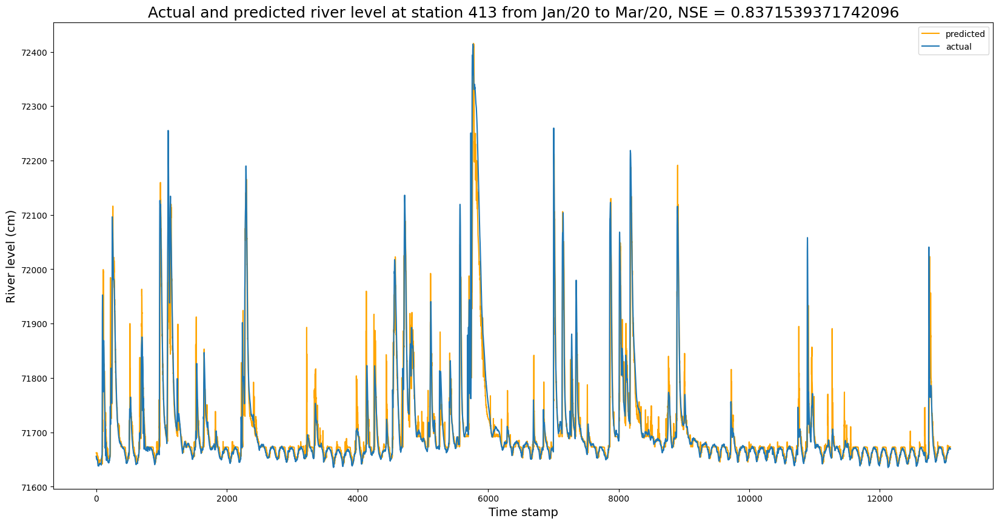

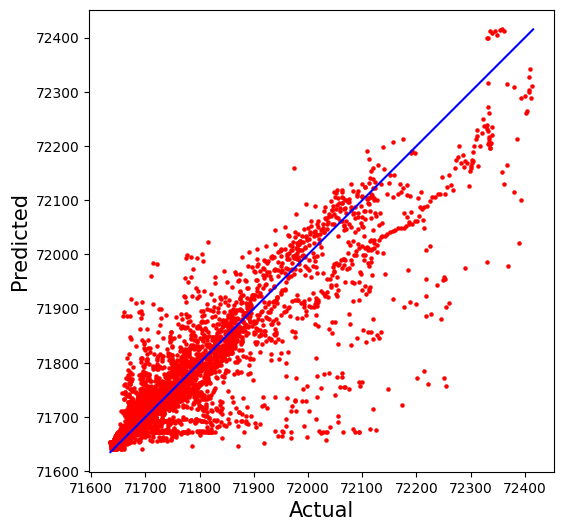

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")

rmse_list_all_uncorr_train, nse_list_all_uncorr_train, rmse_list_all_uncorr, nse_list_all_uncorr, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

Análise da importância das features

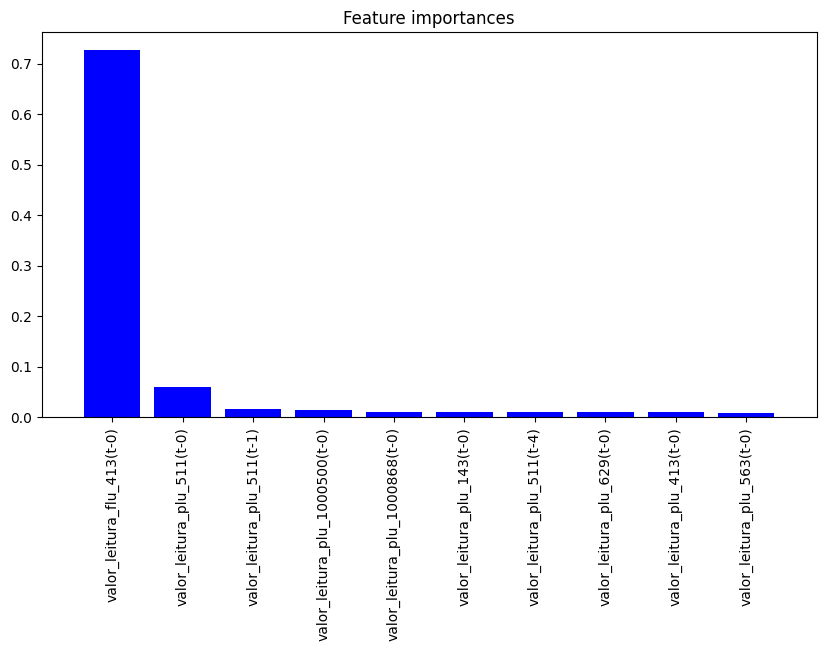

In [ ]:
# Based on: https://towardsdatascience.com/machine-learning-for-forecasting-supervised-learning-with-multivariate-time-series-b5b5044fe068
# Ordena as features pelo valor de importância
indices = np.argsort(importances)[::-1]

# Plota o gráfico de barras com os nomes das features
plt.figure(figsize=(10, 5))
plt.title("Feature importances")
plt.bar(range(10), importances[indices[0:10]],
        color="b", align="center")
plt.xticks(range(10), feature_names[indices[0:10]], rotation='vertical')
plt.xlim([-1, 10])

#plt.bar(range(X_train.shape[1]), importances[indices],
#        color="b", align="center")
#plt.xticks(range(X_train.shape[1]), feature_names[indices], rotation='vertical')
#plt.xlim([-1, X_train.shape[1]])
plt.show()

### Aplicando Filtro de Correlação e Recursive Filter elimination

Selected Features:
valor_leitura_flu_413(t-3)
valor_leitura_flu_413(t-1)
valor_leitura_flu_413(t-0)
valor_leitura_plu_143(t-1)
valor_leitura_plu_143(t-0)
valor_leitura_plu_283(t-11)
valor_leitura_plu_283(t-0)
valor_leitura_plu_413(t-2)
valor_leitura_plu_413(t-1)
valor_leitura_plu_413(t-0)
valor_leitura_plu_511(t-9)
valor_leitura_plu_511(t-6)
valor_leitura_plu_511(t-5)
valor_leitura_plu_511(t-4)
valor_leitura_plu_511(t-3)
valor_leitura_plu_511(t-2)
valor_leitura_plu_511(t-1)
valor_leitura_plu_511(t-0)
valor_leitura_plu_514(t-11)
valor_leitura_plu_514(t-9)
valor_leitura_plu_514(t-8)
valor_leitura_plu_514(t-7)
valor_leitura_plu_514(t-6)
valor_leitura_plu_514(t-5)
valor_leitura_plu_514(t-4)
valor_leitura_plu_514(t-3)
valor_leitura_plu_514(t-2)
valor_leitura_plu_514(t-1)
valor_leitura_plu_514(t-0)
valor_leitura_plu_563(t-0)
valor_leitura_plu_629(t-1)
valor_leitura_plu_629(t-0)
valor_leitura_plu_1000500(t-7)
valor_leitura_plu_1000500(t-6)
valor_leitura_plu_1000500(t-5)
valor_leitura_plu_1000

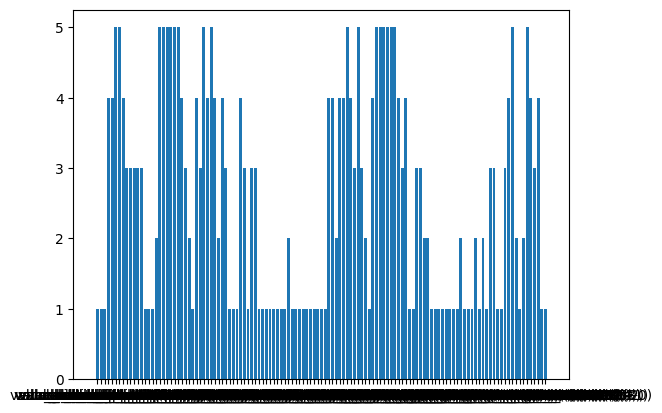

The average of the root mean squared error (RMSE) on train set: 15.9690
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.9733438497192908
The average of the root mean squared error (RMSE) on test set: 41.5456
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.8348816472154356


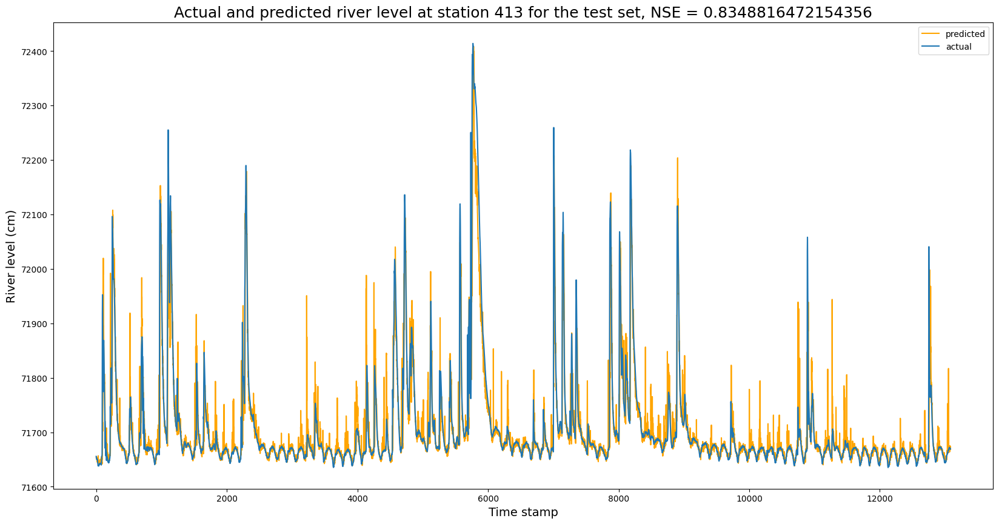

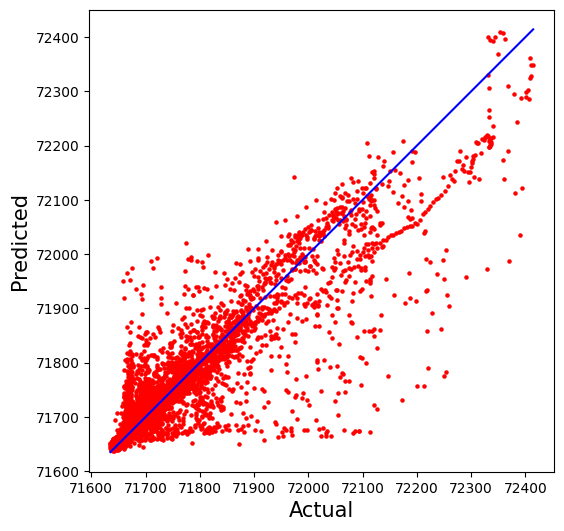

In [ ]:
"""
# FILTRO DE CORRELAÇÃO DE 0.80
correlated_features = set()
correlation_matrix = X_train_general.corr(method='pearson')

alvo = y_train_general['valor_leitura_flu_413(t+12)']

for i in range(len(correlation_matrix .columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) > 0.80:
            # Vamos comparar com o nosso alvo e manter apenas a que tem maior correlação com o alvo
            if(alvo.corr(X_train_general.iloc[:,j])>alvo.corr(X_train_general.iloc[:,j])):
              colname = correlation_matrix.columns[i]
            else:
              colname = correlation_matrix.columns[j]
            correlated_features.add(colname)
print("Quantidade de features a eliminar: ",len(correlated_features))
print(correlated_features)

X_train = X_train_general.drop(labels=correlated_features, axis=1)
X_val = X_val_general.drop(labels=correlated_features, axis=1)
X_test = X_test_general.drop(labels=correlated_features, axis=1)
"""

train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023])
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

X_train = X_train_general.drop(labels=['valor_leitura_flu_413(t-11)','valor_leitura_flu_413(t-10)','valor_leitura_flu_413(t-9)','valor_leitura_flu_413(t-8)','valor_leitura_flu_413(t-7)','valor_leitura_flu_413(t-6)','valor_leitura_flu_413(t-5)','valor_leitura_flu_413(t-4)','valor_leitura_flu_413(t-2)'], axis=1)
X_val = X_val_general.drop(labels=['valor_leitura_flu_413(t-11)','valor_leitura_flu_413(t-10)','valor_leitura_flu_413(t-9)','valor_leitura_flu_413(t-8)','valor_leitura_flu_413(t-7)','valor_leitura_flu_413(t-6)','valor_leitura_flu_413(t-5)','valor_leitura_flu_413(t-4)','valor_leitura_flu_413(t-2)'], axis=1)
X_test = X_test_general.drop(labels=['valor_leitura_flu_413(t-11)','valor_leitura_flu_413(t-10)','valor_leitura_flu_413(t-9)','valor_leitura_flu_413(t-8)','valor_leitura_flu_413(t-7)','valor_leitura_flu_413(t-6)','valor_leitura_flu_413(t-5)','valor_leitura_flu_413(t-4)','valor_leitura_flu_413(t-2)'], axis=1)


# Recursive Filter Elimination
from sklearn.feature_selection import RFE
# perform feature selection while fitting random forest
rfe = RFE(RandomForestRegressor(n_estimators=20,n_jobs=-1,verbose=0,random_state=42), n_features_to_select=50, step = 20)  #step is the number of features to prune at each iteration
fit = rfe.fit(X_train, y_train)

# report selected features
selected = []

print('Selected Features:')
names = X_train.columns.values
for i in range(len(fit.support_)):
  if fit.support_[i]:
    print(names[i])
    selected.append(names[i])
#plot feature rank
names = X_train.columns.values
ticks = [i for i in range(len(names))]
plt.bar(ticks, fit.ranking_)
plt.xticks(ticks, names)
plt.show()

X_train = X_train[selected]
X_val = X_val[selected]
X_test = X_test[selected]

rmse_list_all_uncorr_rfe_train, nse_list_all_uncorr_rfe_train, rmse_list_all_uncorr_rfe, nse_list_all_uncorr_rfe, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

ZONA DE TESTE ABAIXO

In [ ]:
### ZONA DE TESTE
# FILTRO DE CORRELAÇÃO DE 0.80

correlated_features = set()
correlation_matrix = X_train_general.corr(method='pearson')

alvo = y_train_general['valor_leitura_flu_413(t+12)']

for i in range(len(correlation_matrix .columns)):
    for j in range(i):
        if abs(correlation_matrix.iloc[i, j]) > 0.80:
            # Vamos comparar com o nosso alvo e manter apenas a que tem maior correlação com o alvo
            if(alvo.corr(X_train_general.iloc[:,j])>alvo.corr(X_train_general.iloc[:,j])):
              colname = correlation_matrix.columns[i]
            else:
              colname = correlation_matrix.columns[j]
            correlated_features.add(colname)
print("Quantidade de features a eliminar: ",len(correlated_features))
print(correlated_features)

X_train = X_train_general.drop(labels=correlated_features, axis=1)
X_val = X_val_general.drop(labels=correlated_features, axis=1)
X_test = X_test_general.drop(labels=correlated_features, axis=1)

from sklearn.feature_selection import SelectFromModel
model = RandomForestRegressor(n_jobs=-1, verbose=0, random_state=42)  #n_jobs = -1 --> to use all processors to run jobs in parallel
model.fit(X_train, y_train)

Quantidade de features a eliminar:  47
{'valor_leitura_plu_283(t-7)', 'valor_leitura_plu_283(t-3)', 'valor_leitura_plu_283(t-12)', 'valor_leitura_plu_283(t-9)', 'valor_leitura_plu_283(t-8)', 'valor_leitura_plu_283(t-16)', 'valor_leitura_plu_283(t-13)', 'valor_leitura_flu_413(t-15)', 'valor_leitura_flu_413(t-5)', 'valor_leitura_flu_413(t-23)', 'valor_leitura_plu_283(t-20)', 'valor_leitura_plu_283(t-18)', 'valor_leitura_flu_413(t-13)', 'valor_leitura_plu_283(t-21)', 'valor_leitura_plu_283(t-6)', 'valor_leitura_flu_413(t-11)', 'valor_leitura_flu_413(t-21)', 'valor_leitura_flu_413(t-7)', 'valor_leitura_flu_413(t-4)', 'valor_leitura_flu_413(t-14)', 'valor_leitura_flu_413(t-3)', 'valor_leitura_flu_413(t-22)', 'valor_leitura_flu_413(t-10)', 'valor_leitura_flu_413(t-1)', 'valor_leitura_flu_413(t-20)', 'valor_leitura_flu_413(t-19)', 'valor_leitura_plu_283(t-1)', 'valor_leitura_flu_413(t-16)', 'valor_leitura_plu_283(t-22)', 'valor_leitura_plu_283(t-4)', 'valor_leitura_plu_283(t-2)', 'valor_leitu

RandomForestRegressor(n_jobs=-1, random_state=42)

In [ ]:
selecionador = SelectFromModel(model, prefit=True, threshold=-np.inf, max_features = 180)
X_train_new = selecionador.transform(X_train)
X_val_new = selecionador.transform(X_val)
X_test_new = selecionador.transform(X_test)
### ZONA DE TESTE

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but SelectFromModel was fitted without feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but SelectFromModel was fitted without feature names
/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but SelectFromModel was fitted without feature names


In [ ]:
selecionador.get_support()

array([ True, False, False, False, False,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True, False, False,
       False,  True,  True,  True, False, False,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True, False,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True, False,
        True,  True, False, False, False,  True, False,  True,  True,
        True,  True,  True,  True,  True,  True,  True,  True,  True,
        True,  True,  True,  True, False, False, False, False, False,
       False,  True,

The average of the root mean squared error (RMSE) on train set: 20.4526
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.9563061244399461
The average of the root mean squared error (RMSE) on test set: 41.2012
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.8377127097363586


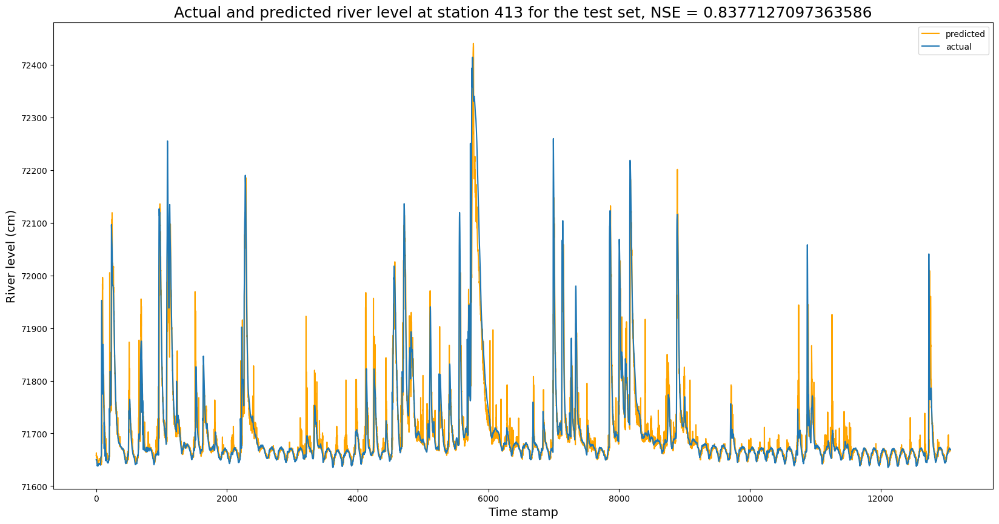

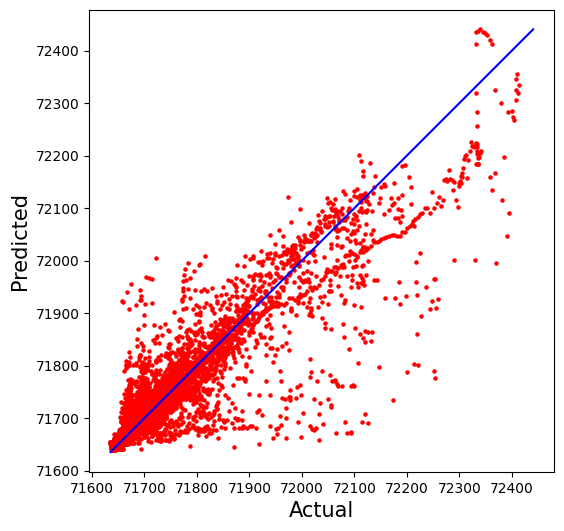

In [ ]:
rmse_testando, nse_testando, rmse_testando, nse_testando, importances = fit_and_evaluate_random_forest(X_train_new,y_train,X_val_new,y_val, X_test_new,y_test)

ZONA DE TESTE ACIMA

N_estimators: 150, max_depth: 20, min_samples_split: 19, min_samples_leaf: 2
building tree 1 of 150
building tree 2 of 150


[Parallel(n_jobs=-1)]: Using backend ThreadingBackend with 2 concurrent workers.


building tree 3 of 150
building tree 4 of 150
building tree 5 of 150
building tree 6 of 150
building tree 7 of 150
building tree 8 of 150
building tree 9 of 150
building tree 10 of 150
building tree 11 of 150
building tree 12 of 150
building tree 13 of 150
building tree 14 of 150
building tree 15 of 150
building tree 16 of 150
building tree 17 of 150
building tree 18 of 150
building tree 19 of 150
building tree 20 of 150
building tree 21 of 150
building tree 22 of 150
building tree 23 of 150
building tree 24 of 150
building tree 25 of 150
building tree 26 of 150
building tree 27 of 150
building tree 28 of 150
building tree 29 of 150
building tree 30 of 150
building tree 31 of 150building tree 32 of 150

building tree 33 of 150
building tree 34 of 150
building tree 35 of 150
building tree 36 of 150
building tree 37 of 150
building tree 38 of 150


[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:    6.6s


building tree 39 of 150
building tree 40 of 150
building tree 41 of 150
building tree 42 of 150
building tree 43 of 150
building tree 44 of 150
building tree 45 of 150
building tree 46 of 150
building tree 47 of 150
building tree 48 of 150
building tree 49 of 150
building tree 50 of 150
building tree 51 of 150
building tree 52 of 150
building tree 53 of 150
building tree 54 of 150
building tree 55 of 150
building tree 56 of 150
building tree 57 of 150
building tree 58 of 150
building tree 59 of 150
building tree 60 of 150
building tree 61 of 150
building tree 62 of 150
building tree 63 of 150
building tree 64 of 150
building tree 65 of 150
building tree 66 of 150
building tree 67 of 150
building tree 68 of 150
building tree 69 of 150
building tree 70 of 150
building tree 71 of 150
building tree 72 of 150
building tree 73 of 150
building tree 74 of 150
building tree 75 of 150
building tree 76 of 150
building tree 77 of 150
building tree 78 of 150
building tree 79 of 150
building tree 80

[Parallel(n_jobs=-1)]: Done 150 out of 150 | elapsed:   28.1s finished
[Parallel(n_jobs=2)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  37 tasks      | elapsed:    0.1s
[Parallel(n_jobs=2)]: Done 150 out of 150 | elapsed:    0.3s finished
[Parallel(n_jobs=2)]: Using backend ThreadingBackend with 2 concurrent workers.
[Parallel(n_jobs=2)]: Done  37 tasks      | elapsed:    0.2s
[Parallel(n_jobs=2)]: Done 150 out of 150 | elapsed:    0.7s finished


The average of the root mean squared error (RMSE) on train set: 30.9644
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.8997769553895949
The average of the root mean squared error (RMSE) on test set: 41.2226
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.8374389525301638


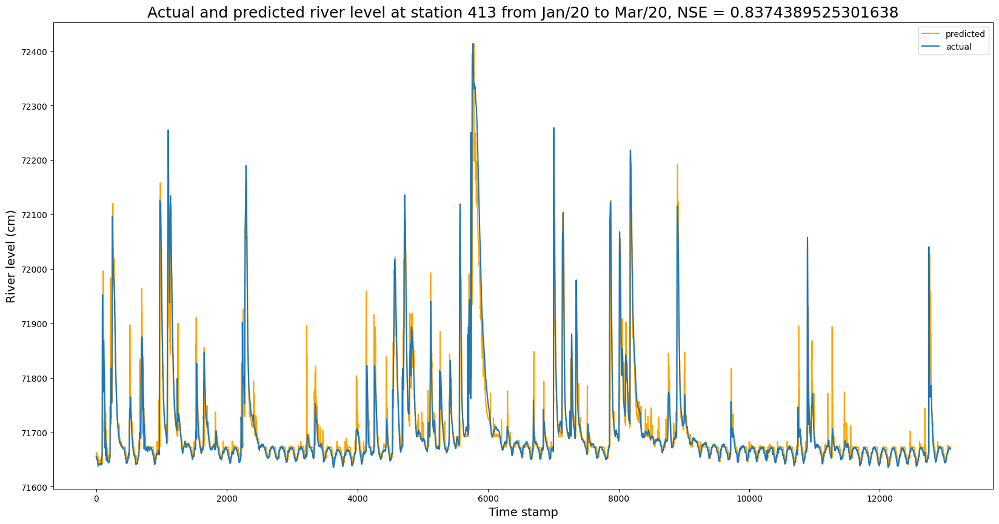

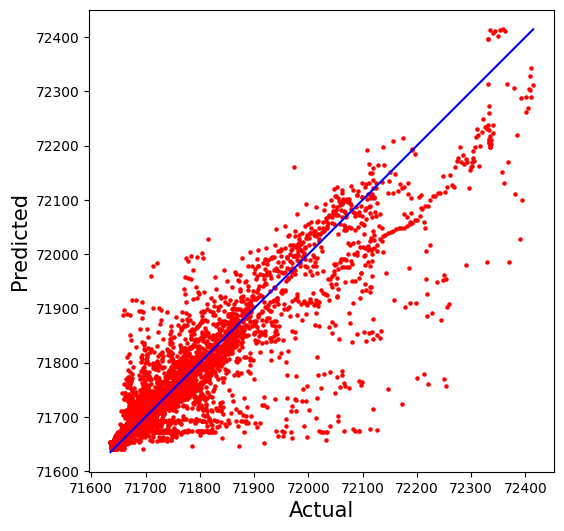

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")

rmse_list_all_uncorr_rfe_train, nse_list_all_uncorr_rfe_train, rmse_list_all_uncorr_rfe, nse_list_all_uncorr_rfe, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

## Experimentos Multivariate com Random Forest (Testando em 2021+2022)

### Usando todas as features

The average of the root mean squared error (RMSE) on train set: 13.4756
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.9815912871393226
The average of the root mean squared error (RMSE) on test set: 42.1500
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.7516856566136145


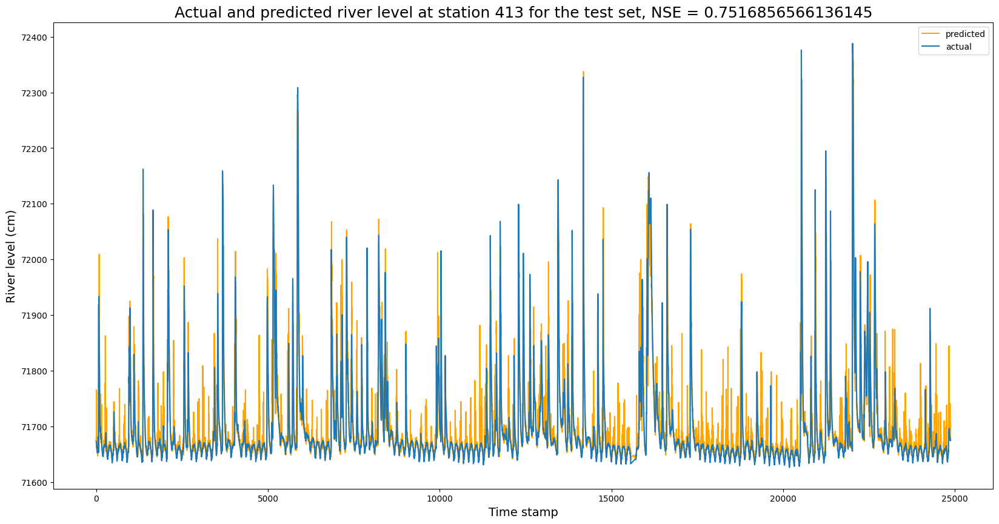

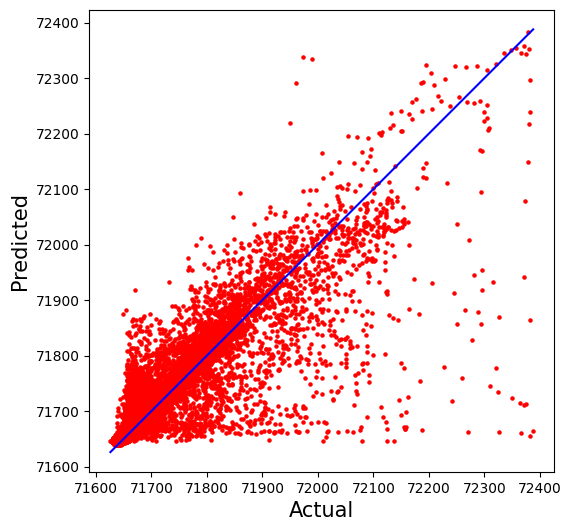

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019,df_2020], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023])
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_list_all_train, nse_list_all_train, rmse_list_all, nse_list_all, importances, y_test, predictions = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test, return_plot=1)

The average of the root mean squared error (RMSE) on train set: 29.1407
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.9139148906026071
The average of the root mean squared error (RMSE) on test set: 41.6798
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.7571951835878858


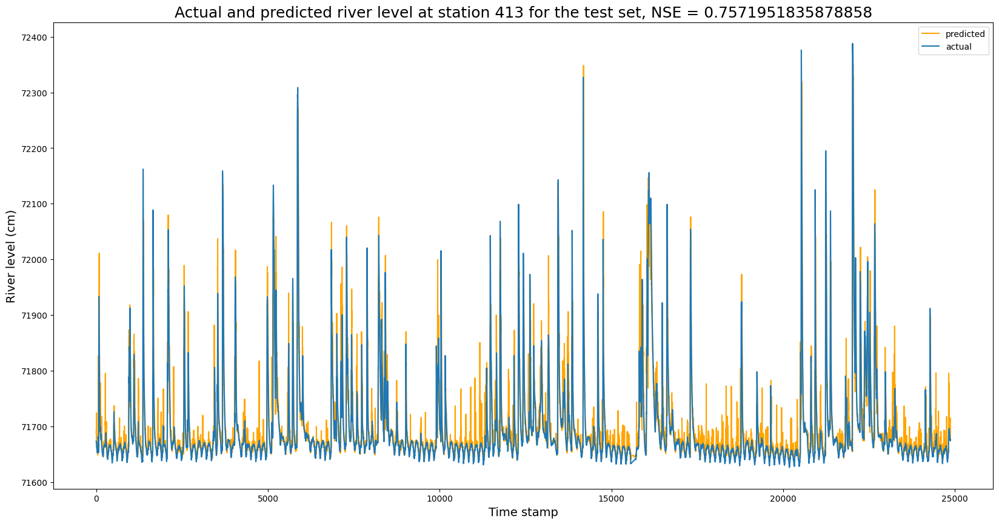

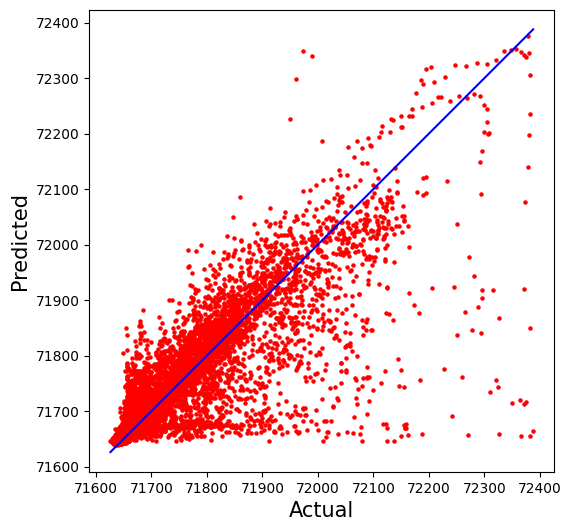

In [ ]:
# Usando hiperparâmetros do Optuna
# Hyperparametres from optuna
n_estimators, max_depth, min_samples_split, min_samples_leaf = 150, 20, 19, 3
rmse_list_all_train, nse_list_all_train, rmse_list_all, nse_list_all, importances, y_test, predictions = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf, return_plot=1)

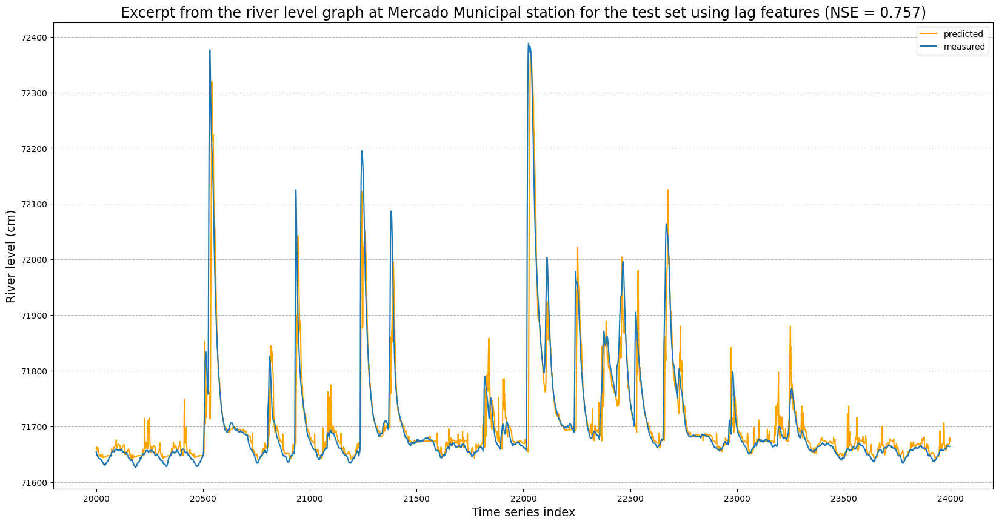

In [ ]:
plt.figure(figsize=(20, 10))
plt.plot(np.arange(20000, 24000, step=1),predictions[20000:24000],color='orange',label='predicted')
plt.plot(np.arange(20000, 24000, step=1),y_test[20000:24000],label='measured')
plt.title(f'Trecho do gráfico do nível do rio na estação do Mercado Municipal para o conjunto de teste usando lag features (NSE = 0.757)',fontsize=17)
plt.title(f'Excerpt from the river level graph at Mercado Municipal station for the test set using lag features (NSE = 0.757)',fontsize=17)
plt.ylabel('River level (cm)',fontsize=14)
plt.xlabel('Time series index',fontsize=14)
plt.grid(axis = 'y', linestyle = '--')
plt.legend()
plt.show()

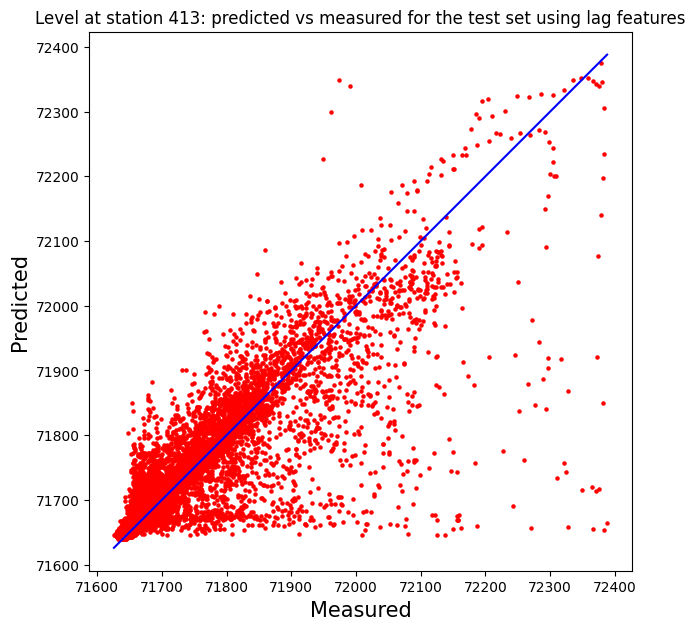

In [ ]:
plt.figure(figsize=(7,7))
plt.scatter(y_val, predictions, c='r',s=5)
p1 = max(max(predictions), max(y_val))
p2 = min(min(predictions), min(y_val))
plt.plot([p1, p2], [p1, p2], 'b-')
plt.xlabel('Measured', fontsize=15)
plt.ylabel('Predicted', fontsize=15)
plt.axis('equal')
#plt.title('Nível na estação 413: predito vs real para o conjunto de teste usando lag features')
plt.title('Level at station 413: predicted vs measured for the test set using lag features')
plt.show()

### Aplicando Filtro de Correlação

The average of the root mean squared error (RMSE) on train set: 15.8209
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.974626079246924
The average of the root mean squared error (RMSE) on test set: 42.7639
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.7444003955168693


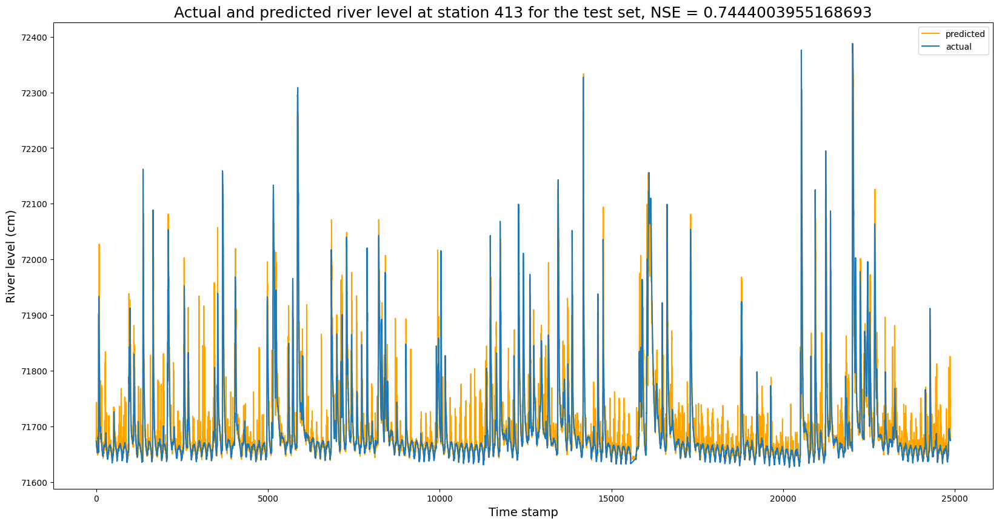

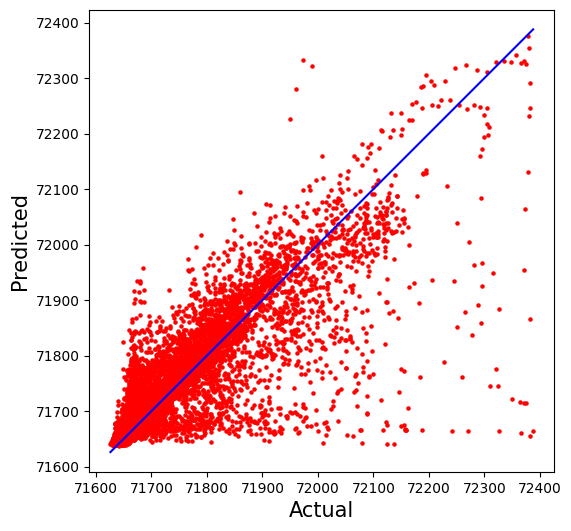

In [ ]:
X_train = X_train_general.drop(labels=['valor_leitura_flu_413(t-11)','valor_leitura_flu_413(t-10)','valor_leitura_flu_413(t-9)','valor_leitura_flu_413(t-8)','valor_leitura_flu_413(t-7)','valor_leitura_flu_413(t-6)','valor_leitura_flu_413(t-5)','valor_leitura_flu_413(t-4)','valor_leitura_flu_413(t-2)'], axis=1)
X_val = X_val_general.drop(labels=['valor_leitura_flu_413(t-11)','valor_leitura_flu_413(t-10)','valor_leitura_flu_413(t-9)','valor_leitura_flu_413(t-8)','valor_leitura_flu_413(t-7)','valor_leitura_flu_413(t-6)','valor_leitura_flu_413(t-5)','valor_leitura_flu_413(t-4)','valor_leitura_flu_413(t-2)'], axis=1)
X_test = X_test_general.drop(labels=['valor_leitura_flu_413(t-11)','valor_leitura_flu_413(t-10)','valor_leitura_flu_413(t-9)','valor_leitura_flu_413(t-8)','valor_leitura_flu_413(t-7)','valor_leitura_flu_413(t-6)','valor_leitura_flu_413(t-5)','valor_leitura_flu_413(t-4)','valor_leitura_flu_413(t-2)'], axis=1)

# Obtém os nomes das colunas
feature_names = X_train.columns

X_train = np.array(X_train)
X_val = np.array(X_val)
X_test = np.array(X_test)

rmse_list_all_uncorr_train, nse_list_all_uncorr_train, rmse_list_all, nse_list_all, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

### Aplicando Filtro de Correlação e Recursive Filter elimination

Selected Features:
valor_leitura_flu_413(t-3)
valor_leitura_flu_413(t-1)
valor_leitura_flu_413(t-0)
valor_leitura_plu_143(t-1)
valor_leitura_plu_143(t-0)
valor_leitura_plu_283(t-1)
valor_leitura_plu_283(t-0)
valor_leitura_plu_413(t-2)
valor_leitura_plu_413(t-1)
valor_leitura_plu_413(t-0)
valor_leitura_plu_511(t-7)
valor_leitura_plu_511(t-6)
valor_leitura_plu_511(t-5)
valor_leitura_plu_511(t-4)
valor_leitura_plu_511(t-3)
valor_leitura_plu_511(t-2)
valor_leitura_plu_511(t-1)
valor_leitura_plu_511(t-0)
valor_leitura_plu_514(t-11)
valor_leitura_plu_514(t-10)
valor_leitura_plu_514(t-9)
valor_leitura_plu_514(t-8)
valor_leitura_plu_514(t-7)
valor_leitura_plu_514(t-6)
valor_leitura_plu_514(t-5)
valor_leitura_plu_514(t-4)
valor_leitura_plu_514(t-3)
valor_leitura_plu_514(t-2)
valor_leitura_plu_514(t-1)
valor_leitura_plu_514(t-0)
valor_leitura_plu_563(t-1)
valor_leitura_plu_563(t-0)
valor_leitura_plu_629(t-1)
valor_leitura_plu_629(t-0)
valor_leitura_plu_1000500(t-3)
valor_leitura_plu_1000500(t-2)

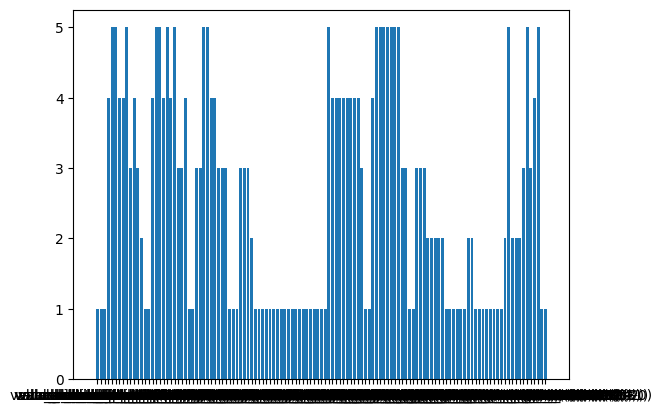

The average of the root mean squared error (RMSE) on train set: 15.8784
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.9744411704807739
The average of the root mean squared error (RMSE) on test set: 42.7906
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.7440810426239571


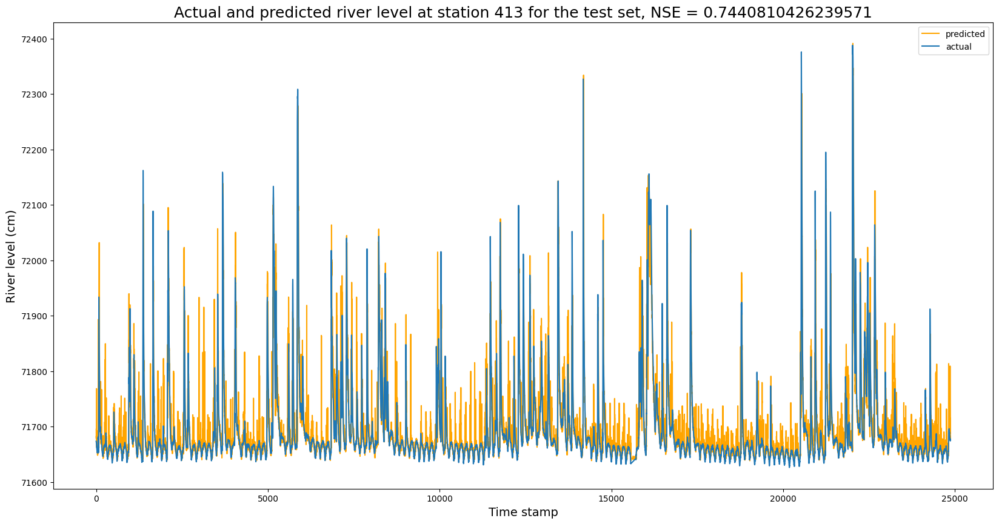

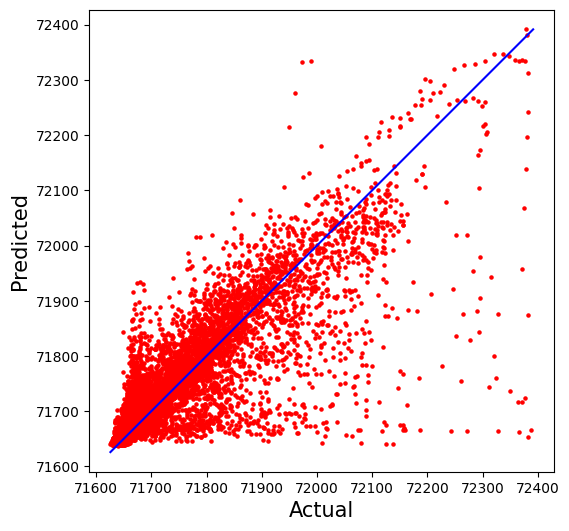

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019, df_2020], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023])
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

X_train = X_train_general.drop(labels=['valor_leitura_flu_413(t-11)','valor_leitura_flu_413(t-10)','valor_leitura_flu_413(t-9)','valor_leitura_flu_413(t-8)','valor_leitura_flu_413(t-7)','valor_leitura_flu_413(t-6)','valor_leitura_flu_413(t-5)','valor_leitura_flu_413(t-4)','valor_leitura_flu_413(t-2)'], axis=1)
X_val = X_val_general.drop(labels=['valor_leitura_flu_413(t-11)','valor_leitura_flu_413(t-10)','valor_leitura_flu_413(t-9)','valor_leitura_flu_413(t-8)','valor_leitura_flu_413(t-7)','valor_leitura_flu_413(t-6)','valor_leitura_flu_413(t-5)','valor_leitura_flu_413(t-4)','valor_leitura_flu_413(t-2)'], axis=1)
X_test = X_test_general.drop(labels=['valor_leitura_flu_413(t-11)','valor_leitura_flu_413(t-10)','valor_leitura_flu_413(t-9)','valor_leitura_flu_413(t-8)','valor_leitura_flu_413(t-7)','valor_leitura_flu_413(t-6)','valor_leitura_flu_413(t-5)','valor_leitura_flu_413(t-4)','valor_leitura_flu_413(t-2)'], axis=1)


# Recursive Filter Elimination
from sklearn.feature_selection import RFE
# perform feature selection while fitting random forest
rfe = RFE(RandomForestRegressor(n_estimators=20,n_jobs=-1,verbose=0,random_state=42), n_features_to_select=50, step = 20)  #step is the number of features to prune at each iteration
fit = rfe.fit(X_train, y_train)

# report selected features
selected = []

print('Selected Features:')
names = X_train.columns.values
for i in range(len(fit.support_)):
  if fit.support_[i]:
    print(names[i])
    selected.append(names[i])
#plot feature rank
names = X_train.columns.values
ticks = [i for i in range(len(names))]
plt.bar(ticks, fit.ranking_)
plt.xticks(ticks, names)
plt.show()

X_train = X_train[selected]
X_val = X_val[selected]
X_test = X_test[selected]

rmse_list_all_uncorr_rfe_train, nse_list_all_uncorr_rfe_train, rmse_list_all_uncorr_rfe, nse_list_all_uncorr_rfe, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test)

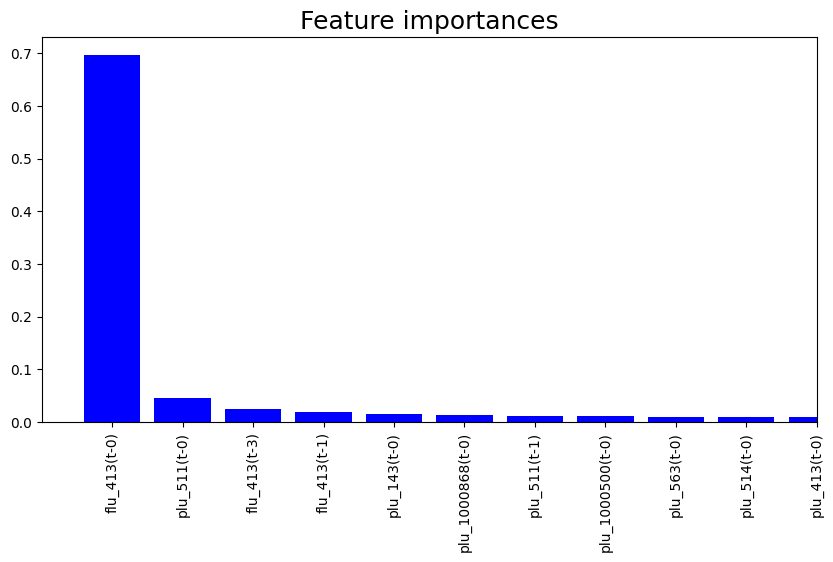

In [ ]:
feature_names = X_train[selected].columns.values
feature_names_novo = []
for elemento in feature_names:
  elemento_novo = elemento.replace("valor_leitura_","")
  feature_names_novo.append(elemento_novo)
feature_names_novo = np.array(feature_names_novo)
# Based on: https://towardsdatascience.com/machine-learning-for-forecasting-supervised-learning-with-multivariate-time-series-b5b5044fe068
# Ordena as features pelo valor de importância
indices = np.argsort(importances)[::-1]

# Plota o gráfico de barras com os nomes das features
plt.figure(figsize=(10, 5))
plt.title("Feature importances",fontsize=18)
plt.bar(range(17), importances[indices[0:17]],
        color="b", align="center")
plt.xticks(range(17), feature_names_novo[indices[0:17]], rotation='vertical')
plt.xlim([-1, 10])

#plt.bar(range(X_train.shape[1]), importances[indices],
#        color="b", align="center")
#plt.xticks(range(X_train.shape[1]), feature_names[indices], rotation='vertical')
#plt.xlim([-1, X_train.shape[1]])
plt.show()

## Comparação de desempenho das ténicas de Feature Selection

In [ ]:
n_features = [204, 195, 50]

### NSE

In [ ]:
# 2020
nse_no_filter_2020 = 0.8328732238501033
nse_correlation_2020 = 0.8332036837029341
nse_correlation_rfe_2020 = 0.8348816472154356

# 2021_2022
nse_no_filter_2021_2022 = 0.7516856566136136
nse_correlation_2021_2022 = 0.7444003955168693
nse_correlation_rfe_2021_2022 = 0.7440810426239571

Text(0.5, 1.0, 'NSE for different sets of inputs')

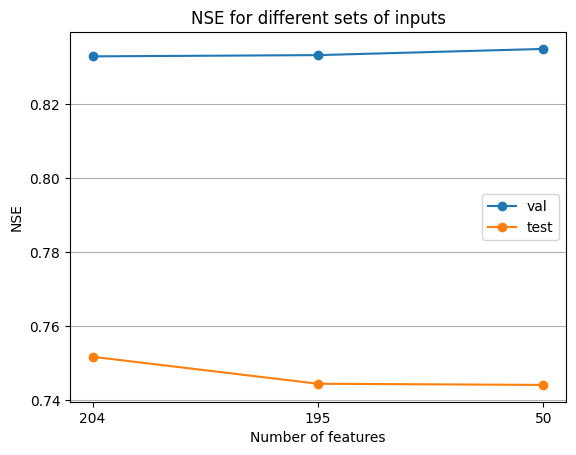

In [ ]:
nse = [nse_no_filter_2020, nse_correlation_2020, nse_correlation_rfe_2020]
plt.plot(nse,marker='o',label='val')
nse = [nse_no_filter_2021_2022, nse_correlation_2021_2022, nse_correlation_rfe_2021_2022]
plt.plot(nse,marker='o',label='test')
plt.xticks(np.arange(3), n_features)  # Set text labels
plt.grid(axis='y')

plt.xlabel('Number of features')
plt.ylabel('NSE')
plt.legend()

plt.title('NSE for different sets of inputs')

### RMSE

In [ ]:
# 2020
rmse_no_filter_2020 = 41.7975
rmse_correlation_2020 = 41.7562
rmse_correlation_rfe_2020 = 41.5456

# 2021_2022
rmse_no_filter_2021_2022 = 42.1500
rmse_correlation_2021_2022 = 42.7639
rmse_correlation_rfe_2021_2022 = 42.7906

Text(0.5, 1.0, 'RMSE for different sets of inputs')

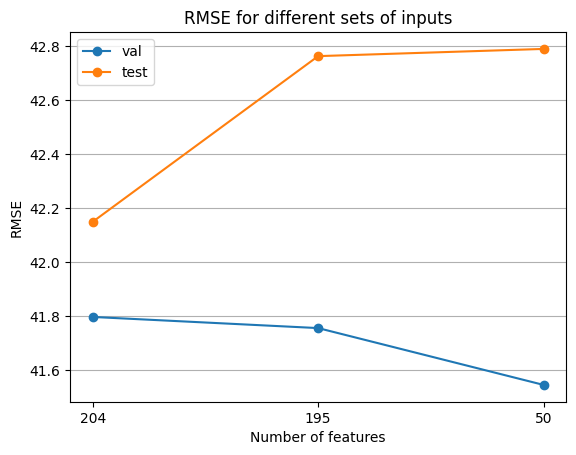

In [ ]:
rmse = [rmse_no_filter_2020, rmse_correlation_2020, rmse_correlation_rfe_2020]
plt.plot(rmse,marker='o',label='val')
rmse = [rmse_no_filter_2021_2022, rmse_correlation_2021_2022, rmse_correlation_rfe_2021_2022]
plt.plot(rmse,marker='o',label='test')
plt.xticks(np.arange(3), n_features)  # Set text labels
plt.grid(axis='y')

plt.xlabel('Number of features')
plt.ylabel('RMSE')
plt.legend()

plt.title('RMSE for different sets of inputs')

# Parte 5: Experimentos com previsões para diferentes horizontes de tempo para o Experimento 5 usando lag features puras

Nessa parte, testaremos diferentes horizontes para o Experimento 5 (All Rain Gauges + HS_out), que foi o que teve melhores resultados na Parte 1.

## Experimento para horizonte de 1 hora (Exp. 5: Nível exutório e todos os pluviômetros da bacia)

### Com treino em 2018/2019 e validação em 2020

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023],horizon=6)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df, horizon = 6)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

N_estimators: 200, max_depth: 20, min_samples_split: 10, min_samples_leaf: 2
The average of the root mean squared error (RMSE) on train set: 14.2530
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.9787565586673855
The average of the root mean squared error (RMSE) on test set: 24.2293
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.9438204377703682


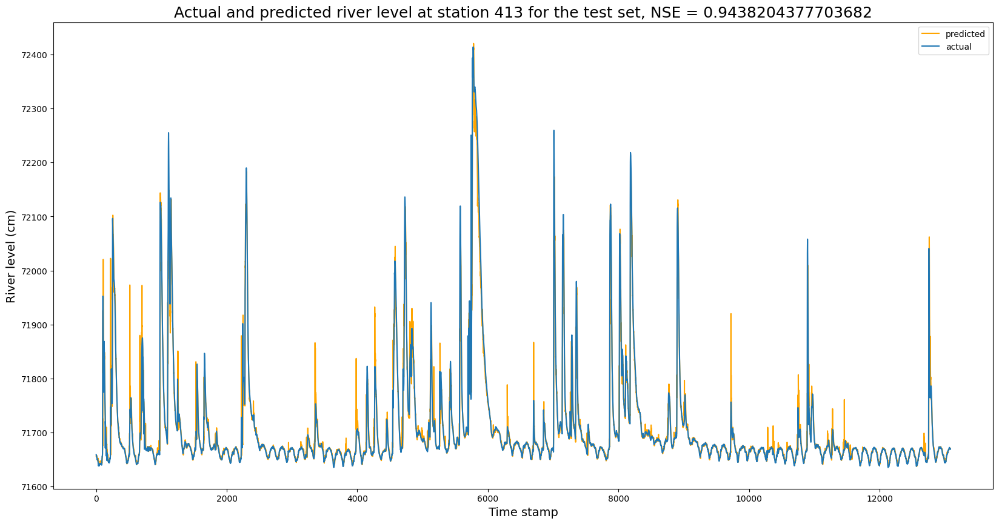

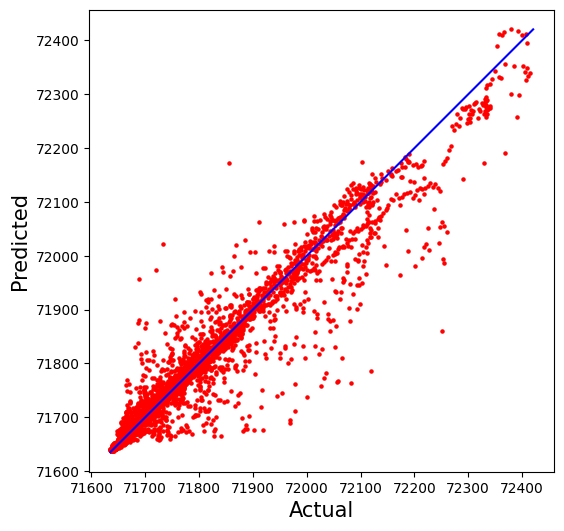

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")
rmse_train_list_1_val_opt, nse_train_list_1_val_opt, rmse_list_1_val_opt, nse_list_1_val_opt, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

N_estimators: 200, max_depth: 20, min_samples_split: 10, min_samples_leaf: 2

In [ ]:
n_estimators = 200
max_depth = 20
min_samples_split = 10
min_samples_leaf = 2

### Com treino em 2018/2019/2020 e teste em 2021+2022

The average of the root mean squared error (RMSE) on train set: 13.5592
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.9813551318392296
The average of the root mean squared error (RMSE) on test set: 24.1848
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.9182107450799932


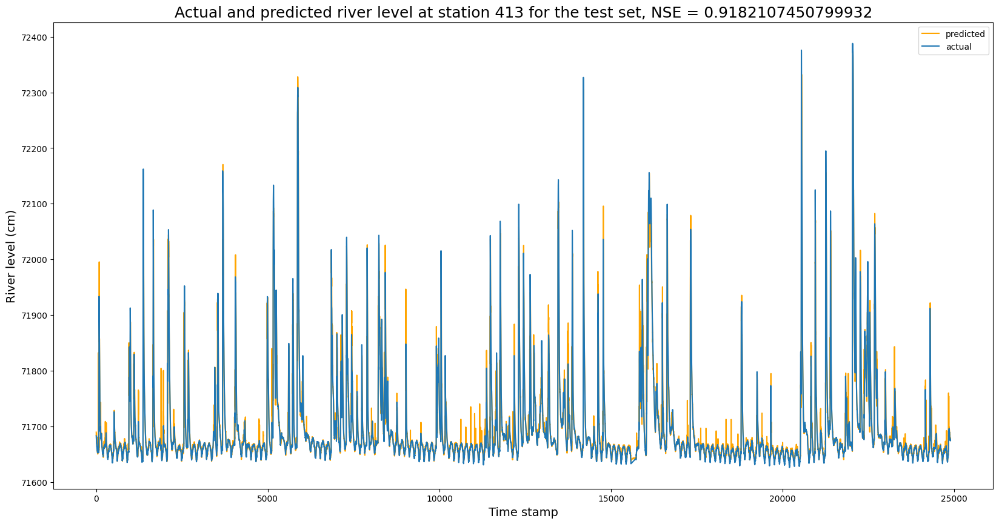

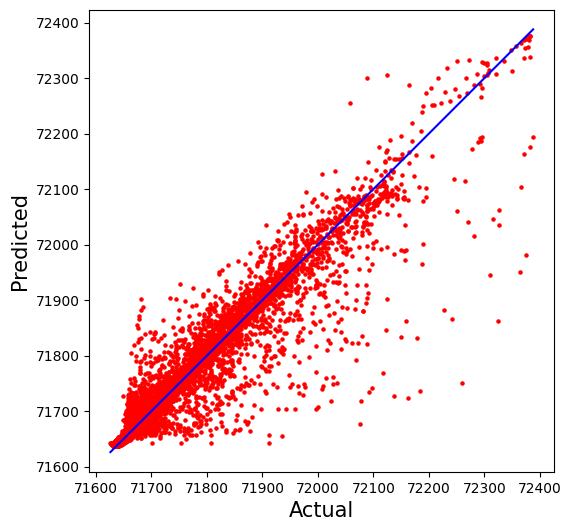

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019,df_2020], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023], horizon = 6)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df, horizon = 6)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_1_test, nse_train_list_1_test, rmse_list_1_test, nse_list_1_test, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test, n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

## Experimento para horizonte de 2 horas (Exp. 5: Nível exutório e todos os pluviômetros da bacia)

### Com treino em 2018/2019 e validação em 2020

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023])
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

N_estimators: 150, max_depth: 20, min_samples_split: 19, min_samples_leaf: 3
The average of the root mean squared error (RMSE) on train set: 29.6851
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.9078870996923692
The average of the root mean squared error (RMSE) on test set: 41.2232
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.8374342087734722


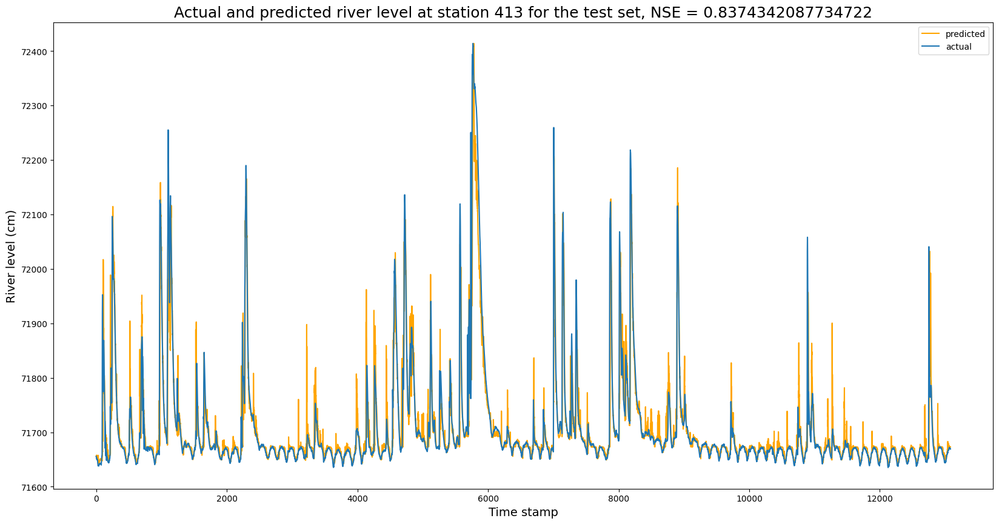

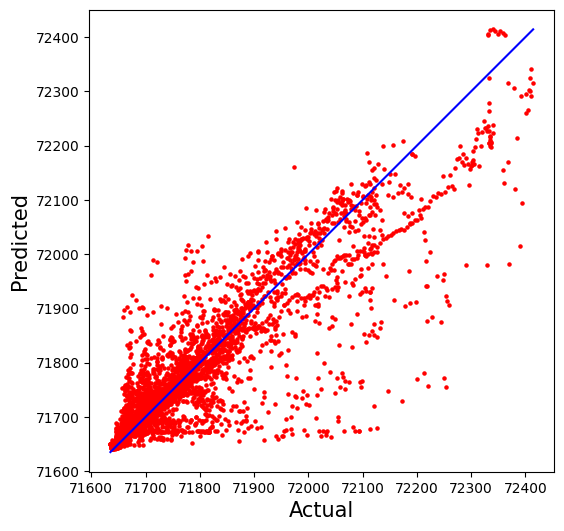

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")
rmse_train_list_2_val_opt, nse_train_list_2_val_opt, rmse_list_2_val_opt, nse_list_2_val_opt, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

N_estimators: 150, max_depth: 20, min_samples_split: 19, min_samples_leaf: 3

In [ ]:
n_estimators = 150
max_depth = 20
min_samples_split = 19
min_samples_leaf = 3

### Com treino em 2018/2019/2020 e teste em 2021+2022

The average of the root mean squared error (RMSE) on train set: 29.1407
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.9139148906026068
The average of the root mean squared error (RMSE) on test set: 41.6798
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.7571951835878873


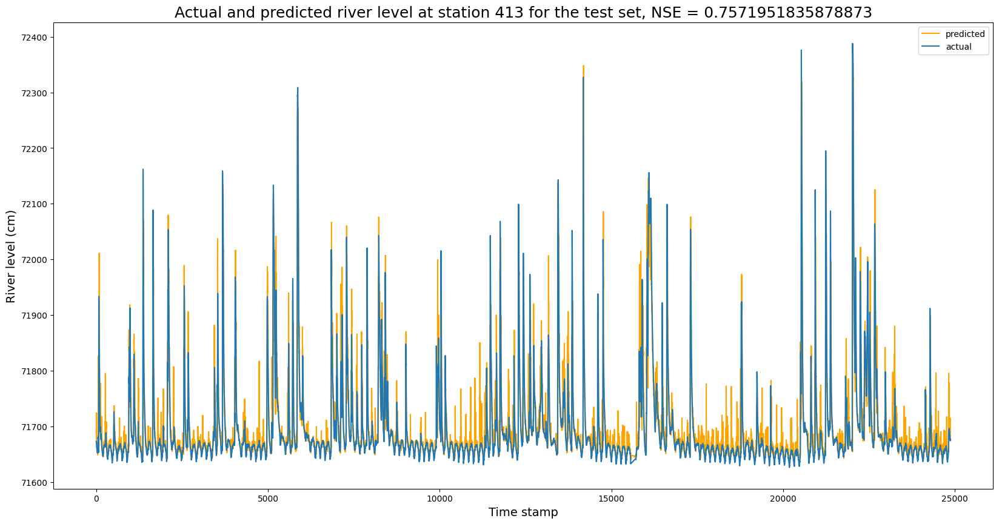

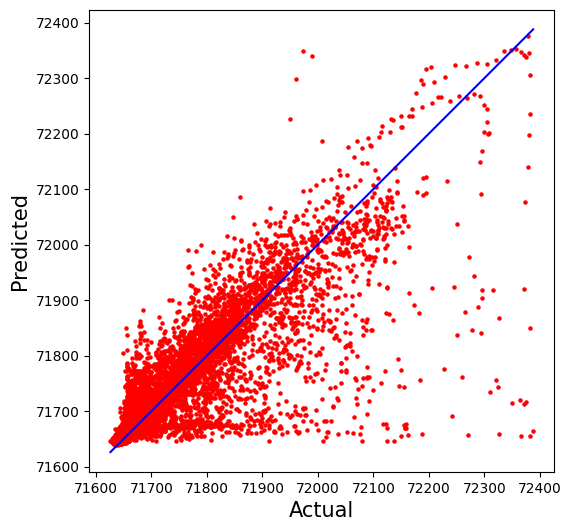

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019,df_2020], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023])
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_2_test, nse_train_list_2_test, rmse_list_2_test, nse_list_2_test, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

## Experimento para horizonte de 3 horas (Exp. 5: Nível exutório e todos os pluviômetros da bacia)

### Com treino em 2018/2019 e validação em 2020

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023], horizon = 18)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df, horizon = 18)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

N_estimators: 150, max_depth: 18, min_samples_split: 14, min_samples_leaf: 14
The average of the root mean squared error (RMSE) on train set: 45.9290
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.7795782966270628
The average of the root mean squared error (RMSE) on test set: 54.0843
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.7202671847999023


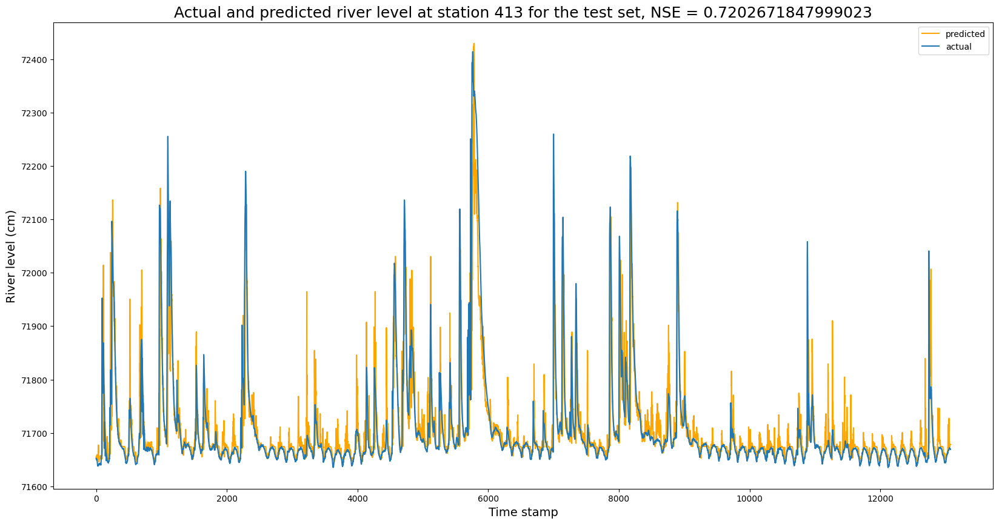

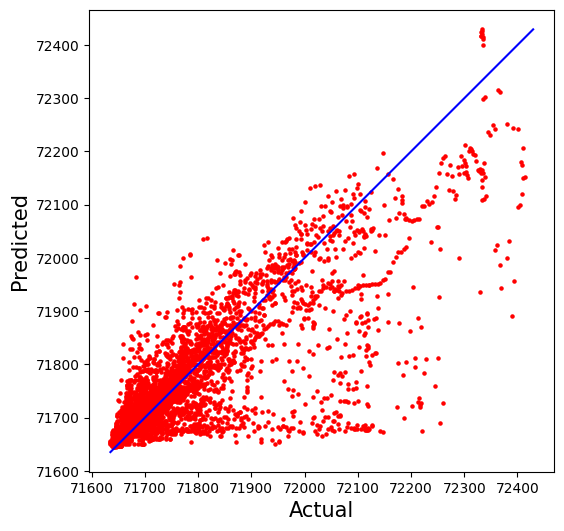

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")
rmse_train_list_3_val_opt, nse_train_list_3_val_opt, rmse_list_3_val_opt, nse_list_3_val_opt, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

N_estimators: 150, max_depth: 18, min_samples_split: 14, min_samples_leaf: 14

In [ ]:
n_estimators = 150
max_depth = 18
min_samples_split = 14
min_samples_leaf = 14

### Com treino em 2018/2019/2020 e teste em 2021+2022

The average of the root mean squared error (RMSE) on train set: 45.7106
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.7882584910495612
The average of the root mean squared error (RMSE) on test set: 55.3745
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.5716253813296095


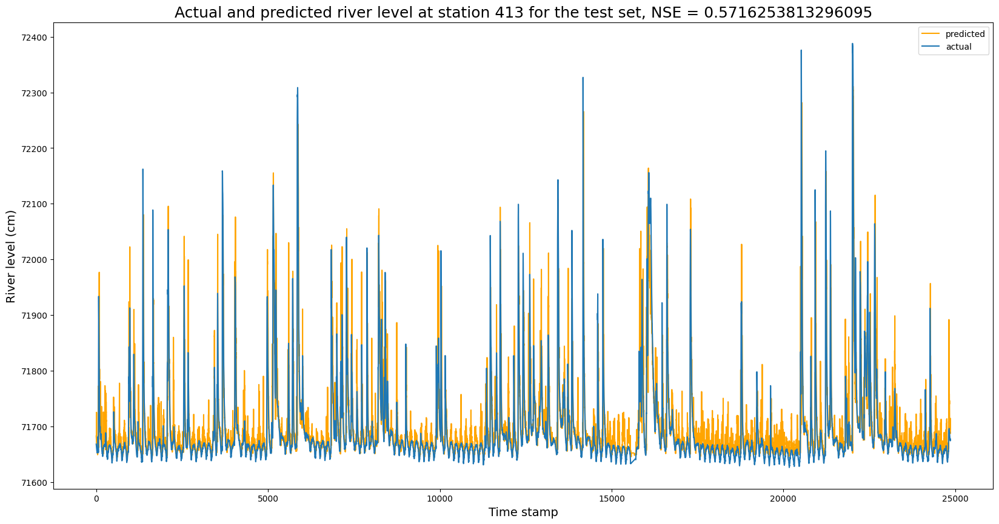

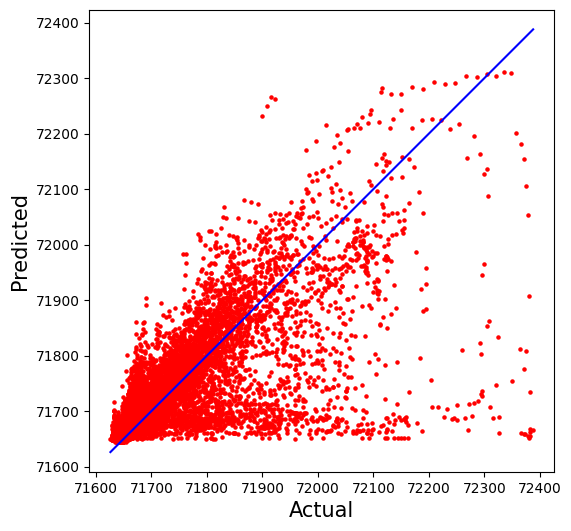

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019,df_2020], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023], horizon = 18)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df, horizon = 18)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_3_test, nse_train_list_3_test, rmse_list_3_test, nse_list_3_test, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test, n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

## Experimento para horizonte de 4 horas (Exp. 5: Nível exutório e todos os pluviômetros da bacia)

### Com treino em 2018/2019 e validação em 2020

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023], horizon = 24)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df, horizon = 24)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

N_estimators: 150, max_depth: 17, min_samples_split: 19, min_samples_leaf: 20
The average of the root mean squared error (RMSE) on train set: 58.6075
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.6412180364251707
The average of the root mean squared error (RMSE) on test set: 65.6644
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.5877849063526737


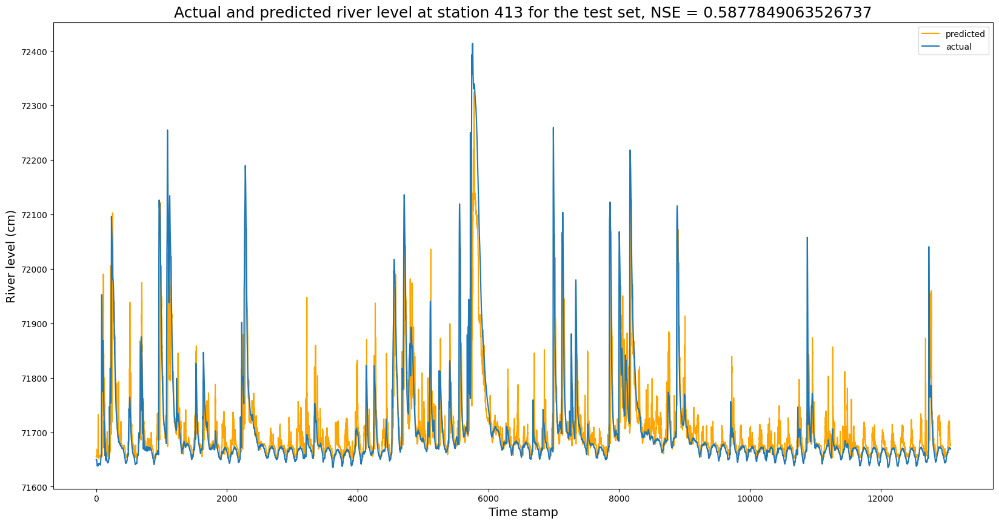

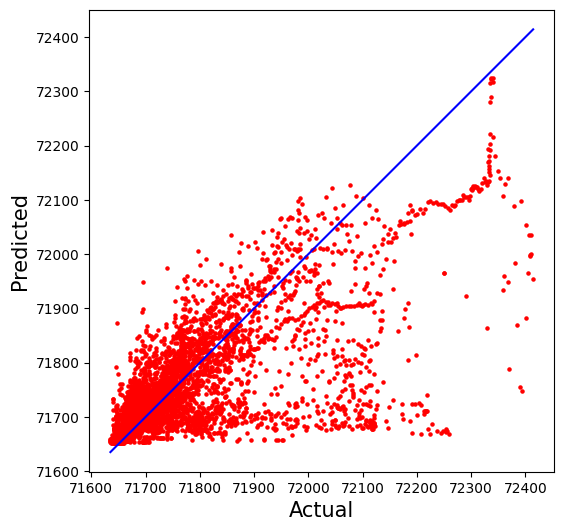

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")
rmse_train_list_4_val_opt, nse_train_list_4_val_opt, rmse_list_4_val_opt, nse_list_4_val_opt, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

N_estimators: 150, max_depth: 17, min_samples_split: 19, min_samples_leaf: 20

In [ ]:
n_estimators = 150
max_depth = 17
min_samples_split = 19
min_samples_leaf = 20

### Com treino em 2018/2019/2020 e teste em 2021+2022

The average of the root mean squared error (RMSE) on train set: 57.9737
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.6595259717321609
The average of the root mean squared error (RMSE) on test set: 66.1340
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.38925714616300267


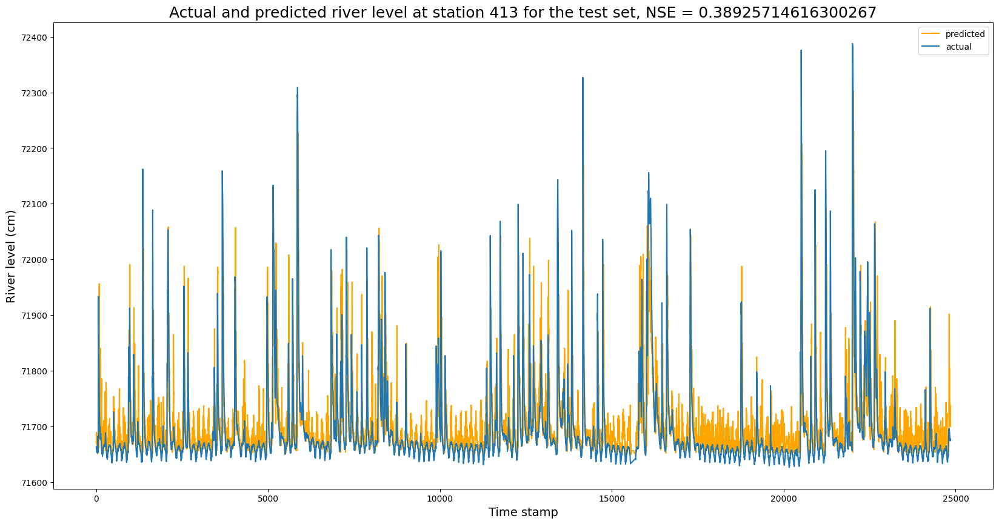

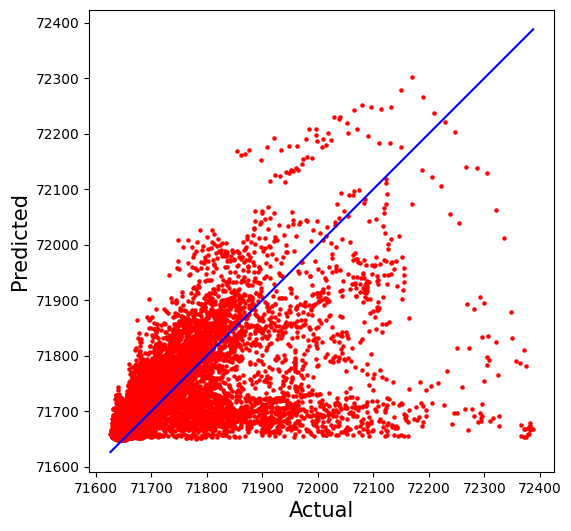

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019,df_2020], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023], horizon = 24)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df, horizon = 24)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_4_test, nse_train_list_4_test, rmse_list_4_test, nse_list_4_test, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

## Experimento para horizonte de 5 horas (Exp. 5: Nível exutório e todos os pluviômetros da bacia)

### Com treino em 2018/2019 e validação em 2020

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023], horizon = 30)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df, horizon = 30)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

N_estimators: 200, max_depth: 20, min_samples_split: 12, min_samples_leaf: 20
The average of the root mean squared error (RMSE) on train set: 65.0584
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.5580487459508094
The average of the root mean squared error (RMSE) on test set: 75.3622
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.4572022564134065


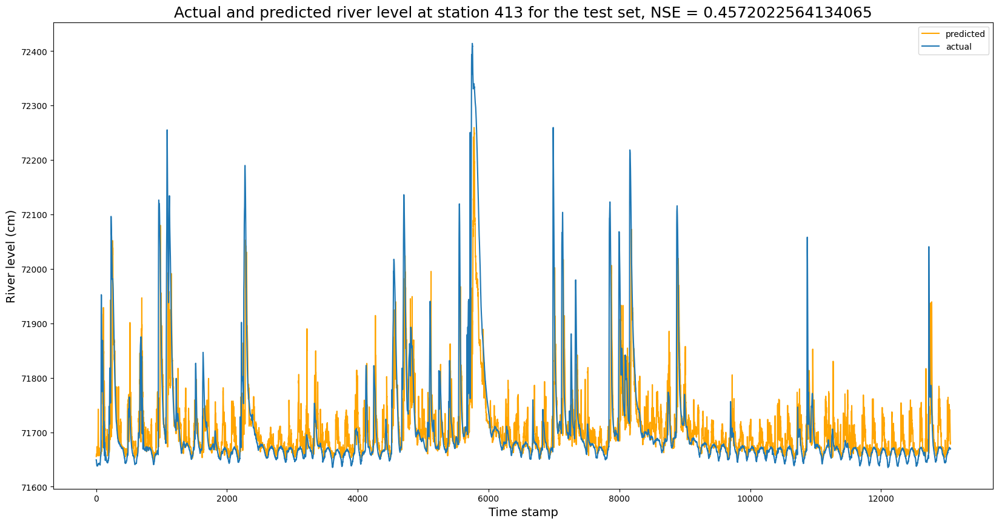

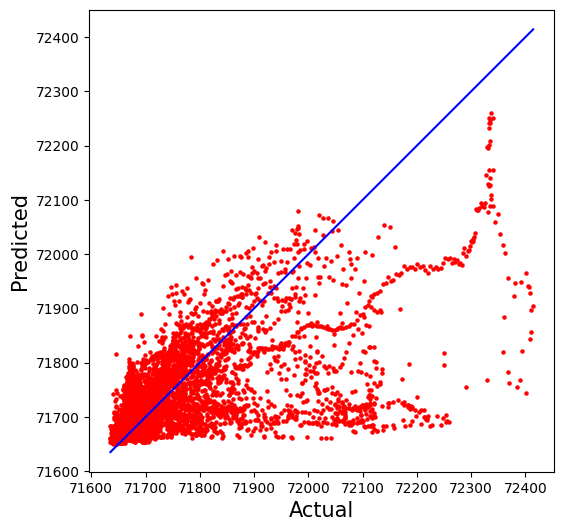

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")
rmse_train_list_5_val_opt, nse_train_list_5_val_opt, rmse_list_5_val_opt, nse_list_5_val_opt, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

N_estimators: 200, max_depth: 20, min_samples_split: 12, min_samples_leaf: 20

In [ ]:
n_estimators = 200
max_depth = 20
min_samples_split = 12
min_samples_leaf = 20

### Com treino em 2018/2019/2020 e teste em 2021+2022

The average of the root mean squared error (RMSE) on train set: 64.5985
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.577410977652385
The average of the root mean squared error (RMSE) on test set: 73.9354
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.23700215372356315


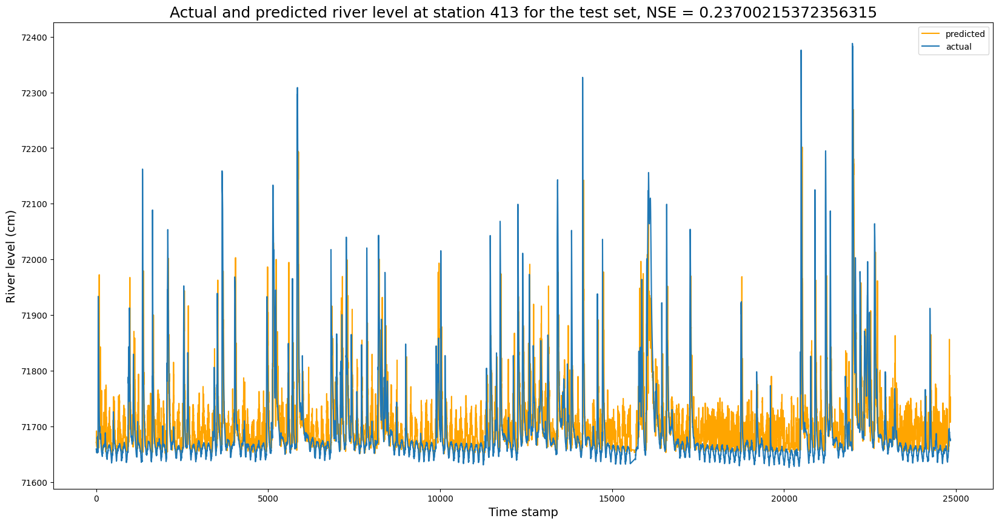

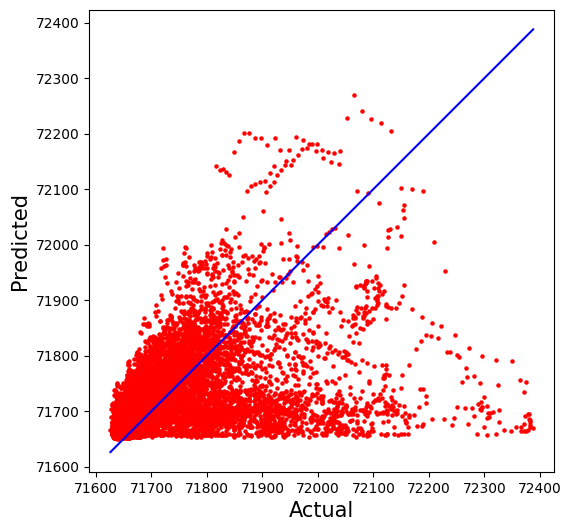

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019,df_2020], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023], horizon = 30)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df, horizon = 30)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_5_test, nse_train_list_5_test, rmse_list_5_test, nse_list_5_test, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

## Experimento para horizonte de 6 horas (Exp. 5: Nível exutório e todos os pluviômetros da bacia)

### Com treino em 2018/2019 e validação em 2020

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023], horizon = 36)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df, horizon = 36)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

[I 2023-08-31 13:17:13,233] A new study created in memory with name: no-name-c21ef8c4-295b-4c6e-9c3d-6ce578f369a6


N_estimators: 200, max_depth: 17, min_samples_split: 15, min_samples_leaf: 20
The average of the root mean squared error (RMSE) on train set: 70.9836
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.4740640136171068
The average of the root mean squared error (RMSE) on test set: 82.0777
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.35634593368130263


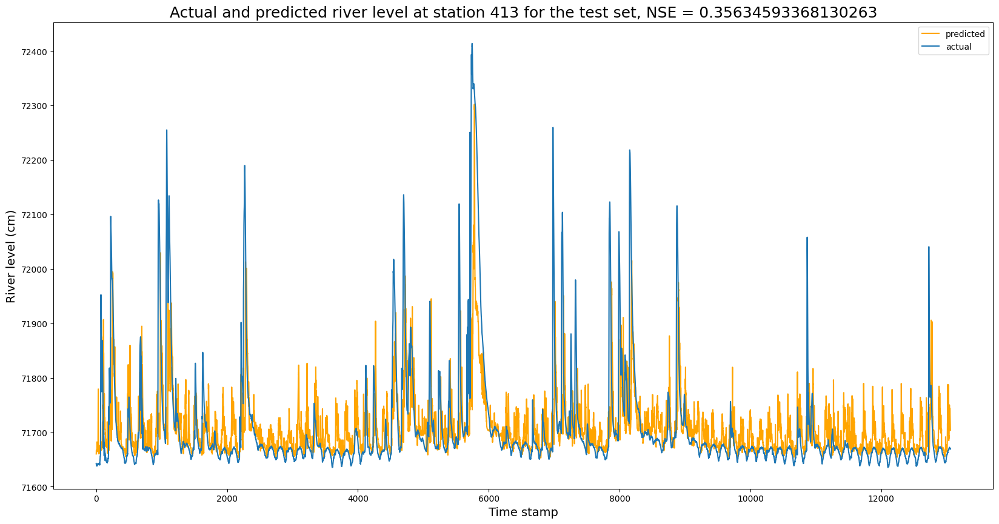

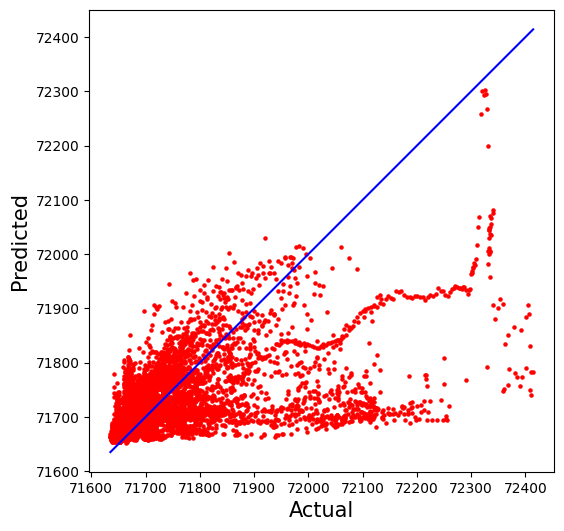

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")
rmse_train_list_6_val_opt, nse_train_list_6_val_opt, rmse_list_6_val_opt, nse_list_6_val_opt, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

N_estimators: 200, max_depth: 17, min_samples_split: 15, min_samples_leaf: 20

In [ ]:
n_estimators = 200
max_depth = 17
min_samples_split = 15
min_samples_leaf = 20

### Com treino em 2018/2019/2020 e teste em 2021+2022

The average of the root mean squared error (RMSE) on train set: 70.5326
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.4963706360957766
The average of the root mean squared error (RMSE) on test set: 79.4539
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.1192245808228446


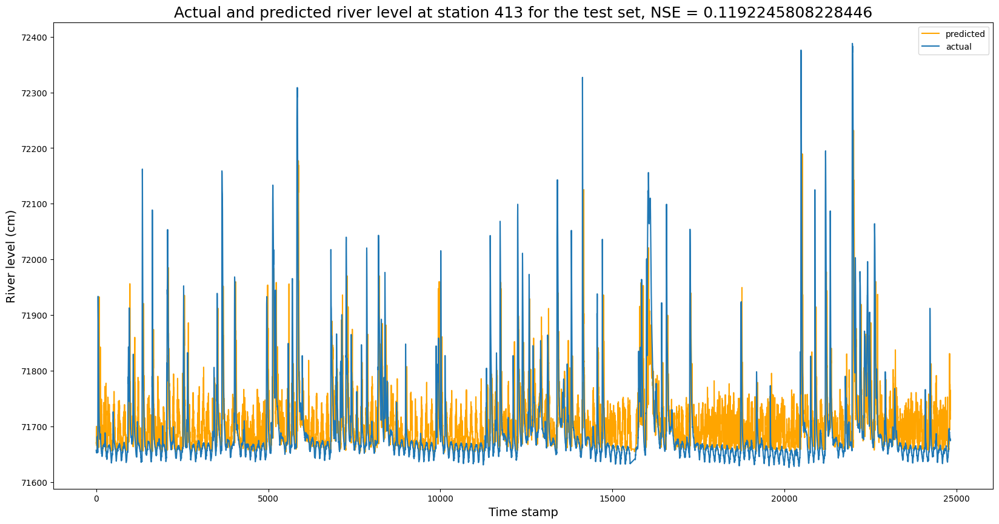

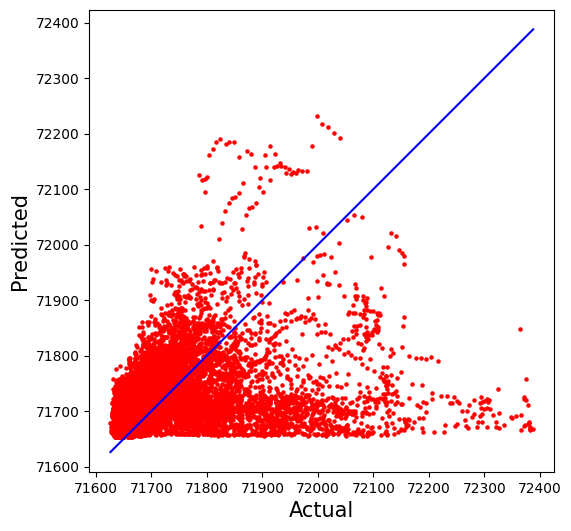

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019,df_2020], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023], horizon = 36)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df, horizon = 36)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_6_test, nse_train_list_6_test, rmse_list_6_test, nse_list_6_test, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

## Experimento para horizonte de 7 horas (Exp. 5: Nível exutório e todos os pluviômetros da bacia)

### Com treino em 2018/2019 e validação em 2020

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023], horizon = 42)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df, horizon = 42)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

N_estimators: 50, max_depth: 18, min_samples_split: 5, min_samples_leaf: 20
The average of the root mean squared error (RMSE) on train set: 75.4203
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.40645833213659566
The average of the root mean squared error (RMSE) on test set: 87.1045
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.27527691300529056


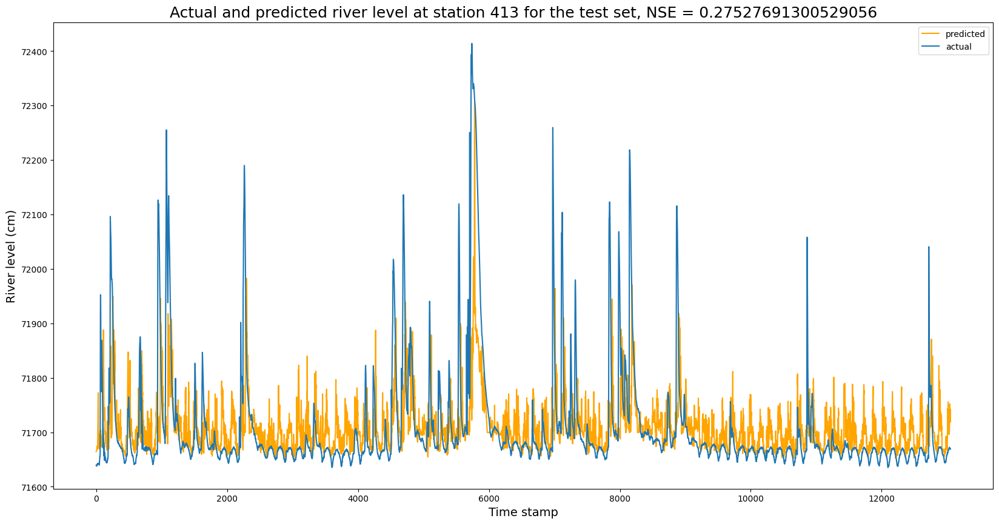

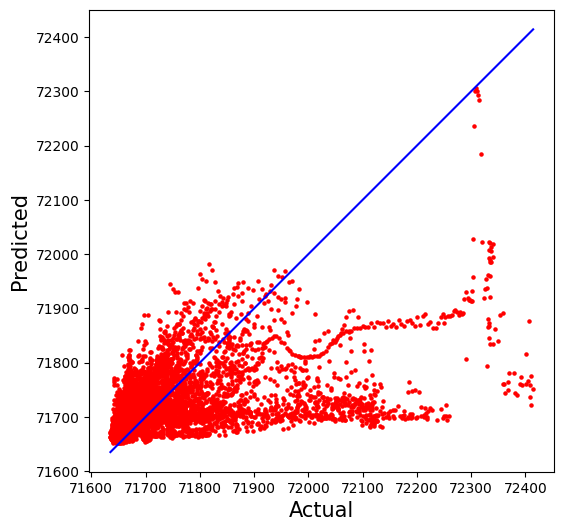

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")
rmse_train_list_7_val_opt, nse_train_list_7_val_opt, rmse_list_7_val_opt, nse_list_7_val_opt, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

N_estimators: 50, max_depth: 18, min_samples_split: 5, min_samples_leaf: 20

In [ ]:
n_estimators = 50
max_depth = 18
min_samples_split = 5
min_samples_leaf = 20

### Com treino em 2018/2019/2020 e teste em 2021+2022

The average of the root mean squared error (RMSE) on train set: 74.4767
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.43864237683003426
The average of the root mean squared error (RMSE) on test set: 82.7188
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.045737574600225206


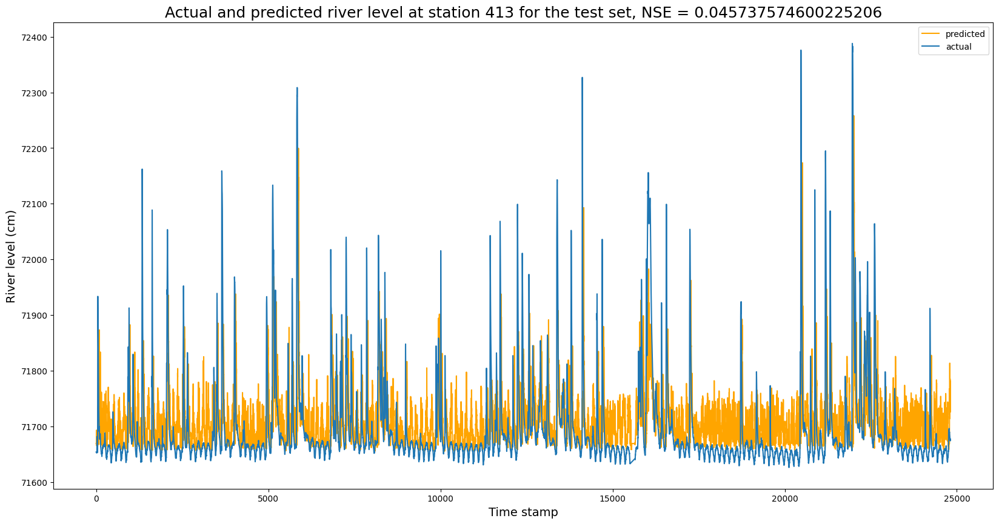

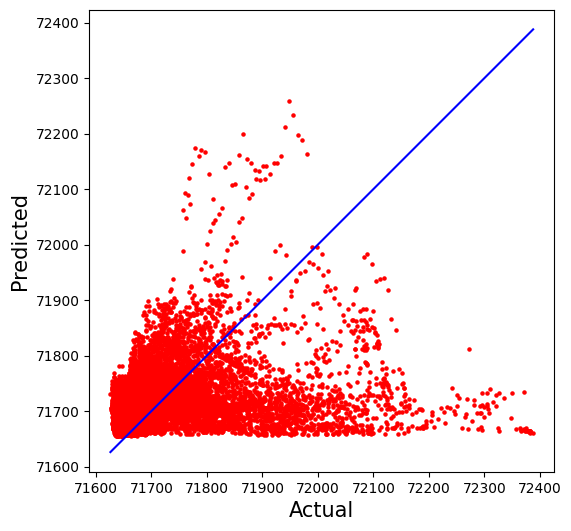

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019,df_2020], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023], horizon = 42)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df, horizon = 42)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_7_test, nse_train_list_7_test, rmse_list_7_test, nse_list_7_test, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

## Experimento para horizonte de 8 horas (Exp. 5: Nível exutório e todos os pluviômetros da bacia)

### Com treino em 2018/2019 e validação em 2020

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023], horizon = 48)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df, horizon = 48)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

N_estimators: 50, max_depth: 19, min_samples_split: 20, min_samples_leaf: 20
The average of the root mean squared error (RMSE) on train set: 78.2905
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.36061400608012173
The average of the root mean squared error (RMSE) on test set: 90.8449
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: 0.21189196551744993


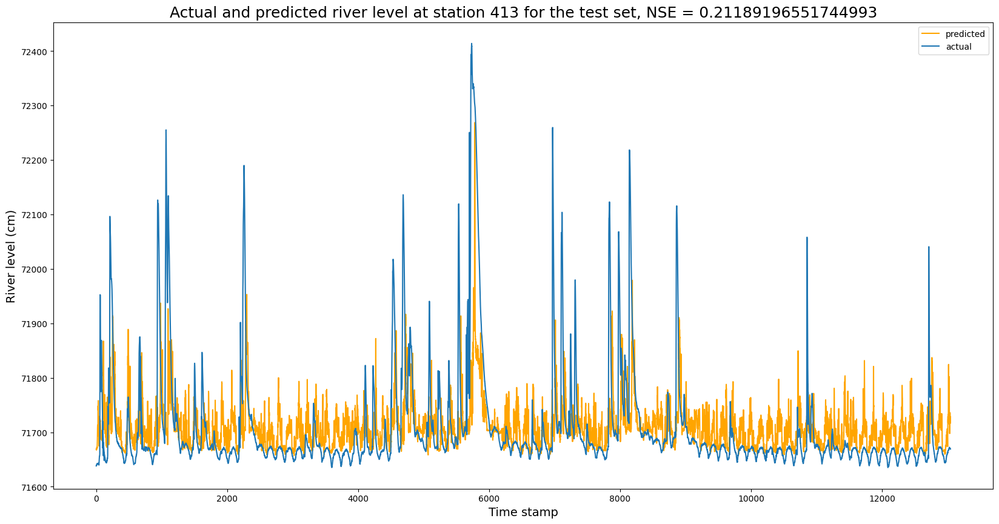

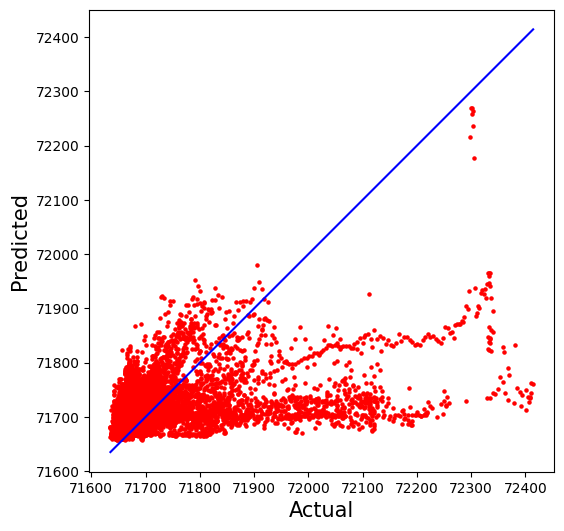

In [ ]:
# Otimizando com Optuna
trial, n_estimators, max_depth, min_samples_split, min_samples_leaf = run_optuna(n_trials=50)
print(f"N_estimators: {n_estimators}, max_depth: {max_depth}, min_samples_split: {min_samples_split}, min_samples_leaf: {min_samples_leaf}")
rmse_train_list_8_val_opt, nse_train_list_8_val_opt, rmse_list_8_val_opt, nse_list_8_val_opt, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

N_estimators: 50, max_depth: 19, min_samples_split: 20, min_samples_leaf: 20

In [ ]:
n_estimators = 50
max_depth = 19
min_samples_split = 20
min_samples_leaf = 20

### Com treino em 2018/2019/2020 e teste em 2021+2022

The average of the root mean squared error (RMSE) on train set: 77.2712
The average of the Nash-Sutcliffe-Efficience (NSE) on train set in 30 repetitions is: 0.39589445989925764
The average of the root mean squared error (RMSE) on test set: 84.9917
The average of the Nash-Sutcliffe-Efficience (NSE) on test set in 30 repetitions is: -0.0070209678489800975


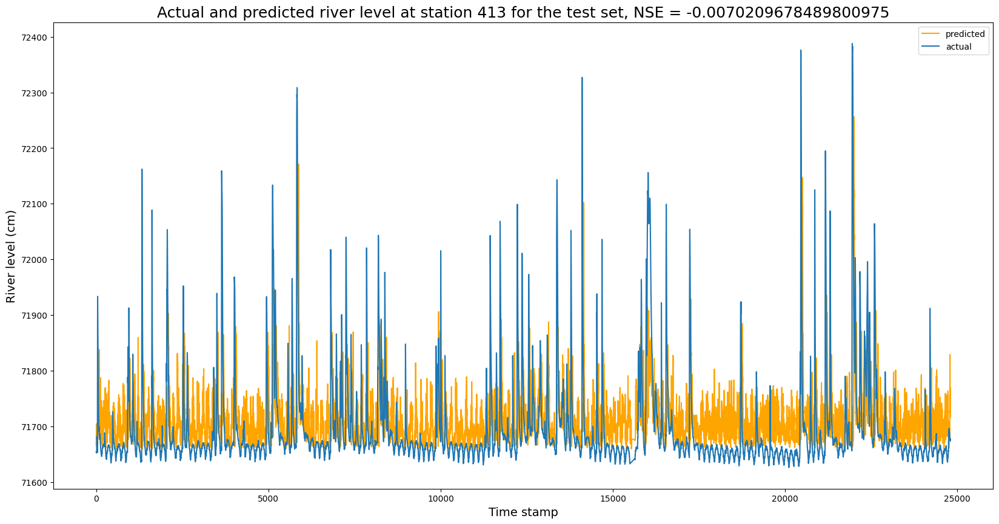

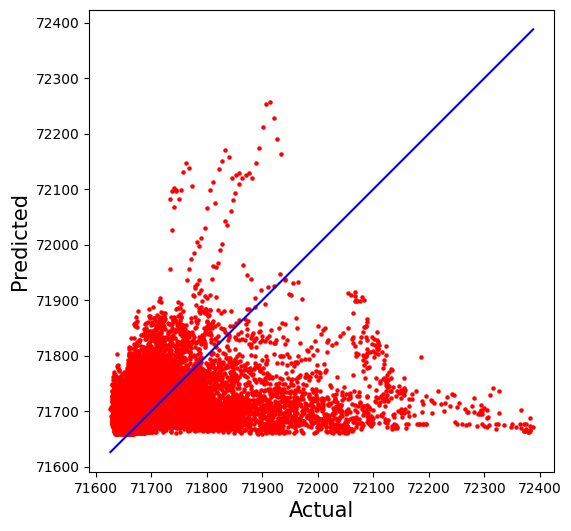

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019,df_2020], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023], horizon = 48)
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df, horizon = 48)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

rmse_train_list_8_test, nse_train_list_8_test, rmse_list_8_test, nse_list_8_test, importances = fit_and_evaluate_random_forest(X_train,y_train,X_val,y_val, X_test,y_test,n_estimators = n_estimators, max_depth = max_depth, min_samples_split = min_samples_split, min_samples_leaf = min_samples_leaf)

## Comparação da performance

NSE

In [ ]:
nse_list_1_test = 0.9182107450799932
nse_list_2_test = 0.7571951835878873
nse_list_3_test = 0.5716253813296095
nse_list_4_test = 0.38925714616300267
nse_list_5_test = 0.23700215372356315
nse_list_6_test = 0.1192245808228446
nse_list_7_test = 0.045737574600225206
nse_list_8_test = -0.0070209678489800975

NSE

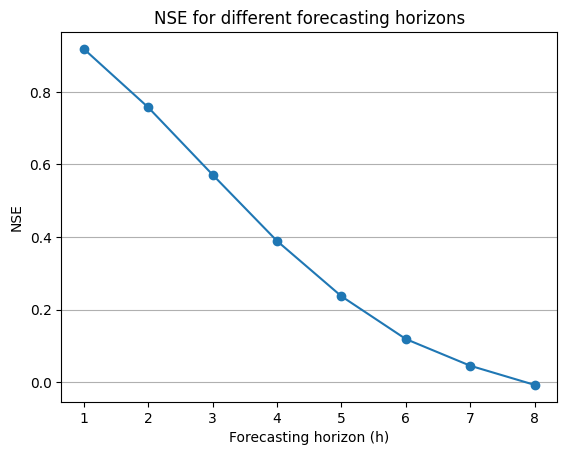

In [ ]:
#nse = [nse_list_1_val_opt,nse_list_2_val_opt,nse_list_3_val_opt,nse_list_4_val_opt,nse_list_5_val_opt,nse_list_6_val_opt,nse_list_7_val_opt,nse_list_8_val_opt]
#horizon = [1,2,3,4,5,6,7,8]
#plt.plot(horizon, nse,marker='o',label='val')
nse = [nse_list_1_test,nse_list_2_test,nse_list_3_test,nse_list_4_test,nse_list_5_test,nse_list_6_test,nse_list_7_test,nse_list_8_test]
horizon = [1,2,3,4,5,6,7,8]
plt.grid(axis='y')
plt.plot(horizon, nse,marker='o',label='test')

#plt.xlabel('Horizonte de previsão (h)')
plt.xlabel('Forecasting horizon (h)')
plt.ylabel('NSE')
#plt.legend()

plt.title('NSE for different forecasting horizons')
plt.show()

RMSE

In [ ]:
rmse_list_1_test = 24.1848
rmse_list_2_test = 41.6798
rmse_list_3_test = 55.3745
rmse_list_4_test = 66.1340
rmse_list_5_test = 73.9354
rmse_list_6_test = 79.4539
rmse_list_7_test = 82.7188
rmse_list_8_test = 84.9917

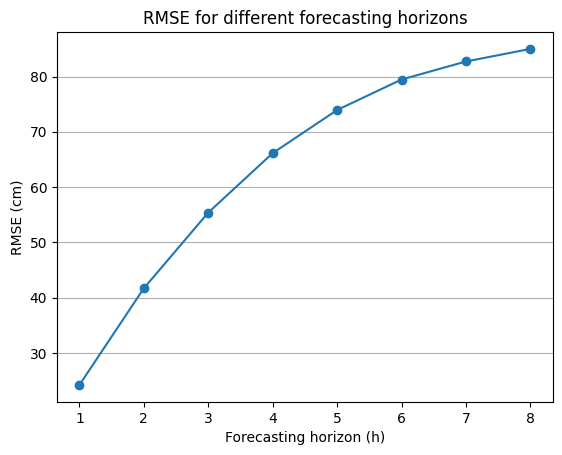

In [ ]:
#rmse = [rmse_list_1_val_opt,rmse_list_2_val_opt,rmse_list_3_val_opt,rmse_list_4_val_opt,rmse_list_5_val_opt,rmse_list_6_val_opt,rmse_list_7_val_opt,rmse_list_8_val_opt]
#horizon = [1,2,3,4,5,6,7,8]
#plt.plot(horizon, rmse,marker='o',label='val')
rmse = [rmse_list_1_test,rmse_list_2_test,rmse_list_3_test,rmse_list_4_test,rmse_list_5_test,rmse_list_6_test,rmse_list_7_test,rmse_list_8_test]
horizon = [1,2,3,4,5,6,7,8]
plt.grid(axis='y')
plt.plot(horizon, rmse,marker='o',label='test')

plt.xlabel('Forecasting horizon (h)')
#plt.xlabel('Horizonte de previsão (h)')
plt.ylabel('RMSE (cm)')
#plt.legend()

plt.title('RMSE for different forecasting horizons')
#plt.title('RMSE para diferentes horizontes de predição')
plt.show()

# Parte 6: Análise Exploratória dos Dados

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019, df_2020], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023])
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

In [ ]:
!pip install mplcursors --quiet # from PyPI

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.0/89.0 kB 714.4 kB/s eta 0:00:00
  Preparing metadata (setup.py) ... done


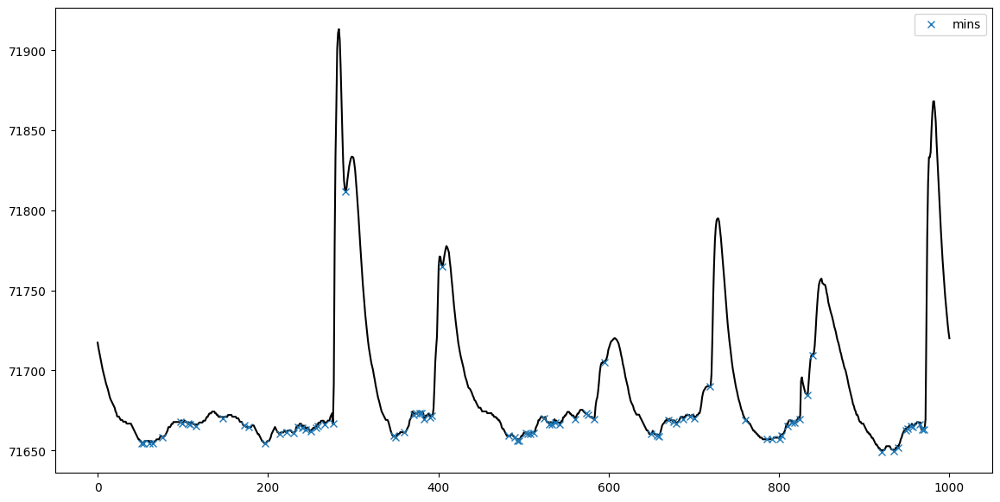

In [ ]:
# Código retirado de https://stackoverflow.com/questions/59163774/python-how-to-find-and-visually-mark-the-local-minima-of-a-sequence
from scipy.signal import find_peaks
fig, ax = plt.subplots(figsize=(14,7))
series = X_train_general['valor_leitura_flu_413(t-0)'].values[2000:3000]
peaks, _ = find_peaks(series)
mins, _ = find_peaks(series*-1)
x = np.linspace(0, len(series), len(series))
plt.plot(x, series, color='black');
plt.plot(x[mins], series[mins], 'x', label='mins')
#plt.plot(x[peaks], series[peaks], '*', label='peaks')
plt.legend()
plt.show()

In [ ]:
mins

array([ 52,  54,  61,  65,  76,  97,  99, 106, 108, 115, 147, 172, 177,
       196, 214, 222, 230, 235, 240, 244, 250, 256, 258, 266, 276, 291,
       347, 349, 360, 371, 374, 378, 380, 383, 390, 392, 404, 482, 489,
       492, 494, 502, 504, 507, 511, 524, 530, 533, 537, 542, 560, 573,
       575, 582, 594, 649, 656, 658, 669, 675, 679, 687, 695, 700, 718,
       760, 785, 791, 800, 802, 809, 814, 817, 823, 832, 839, 920, 934,
       939, 948, 950, 954, 956, 964, 967, 969])

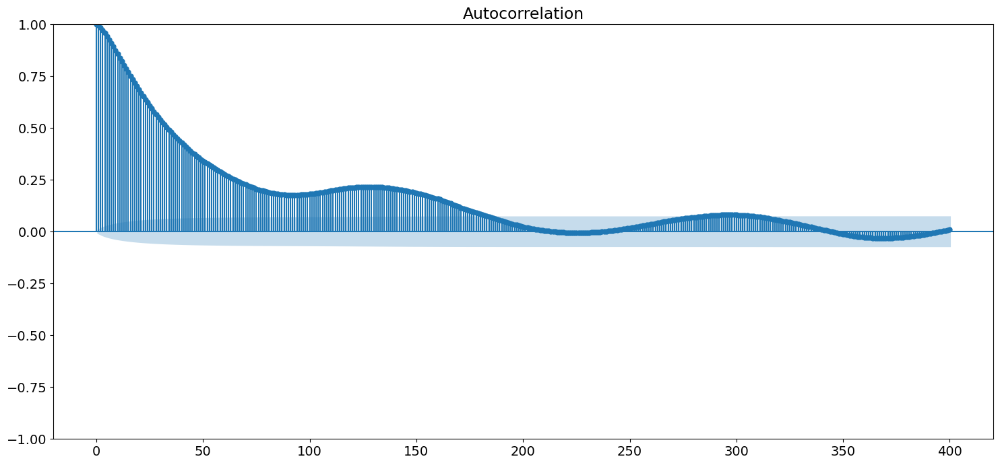

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf
plt.rcParams['font.size'] = 14
fig, ax = plt.subplots(figsize=(18,8))
plot_acf(X_train_general['valor_leitura_flu_413(t-0)'].values, lags=400,ax=ax,title='Autocorrelation', use_vlines=True);
#lags = list(range(101))
#ax.set_xticks(lags);
#ax.set_xticklabels(lags);

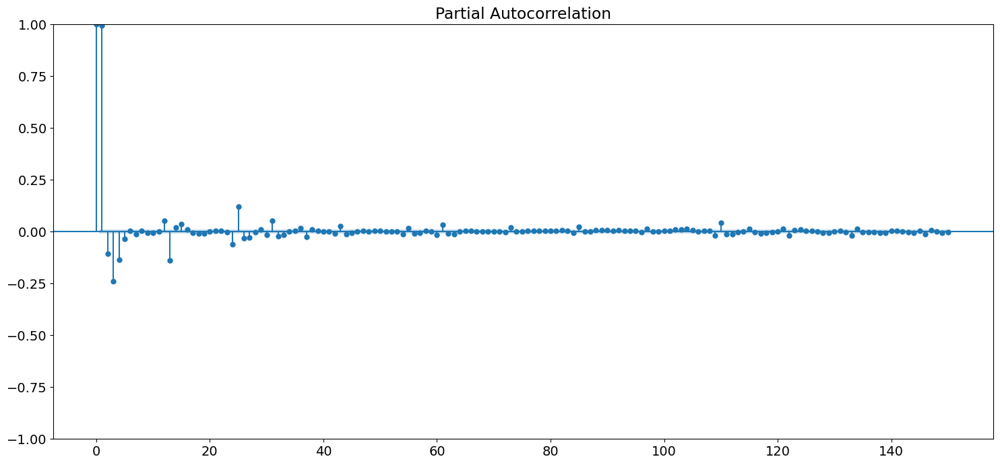

In [ ]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
fig, ax = plt.subplots(figsize=(18,8))
plot_pacf(X_train_general['valor_leitura_flu_413(t-0)'].values, lags=150,ax=ax,title='Partial Autocorrelation', use_vlines=True);
#lags = list(range(101))
#ax.set_xticks(lags);
#ax.set_xticklabels(lags);

The period of the time series is 143.74538745387454
The second period of the time series is 38955.0
The third period of the time series is 9738.75
The fourth period of the time series is 1256.6129032258066


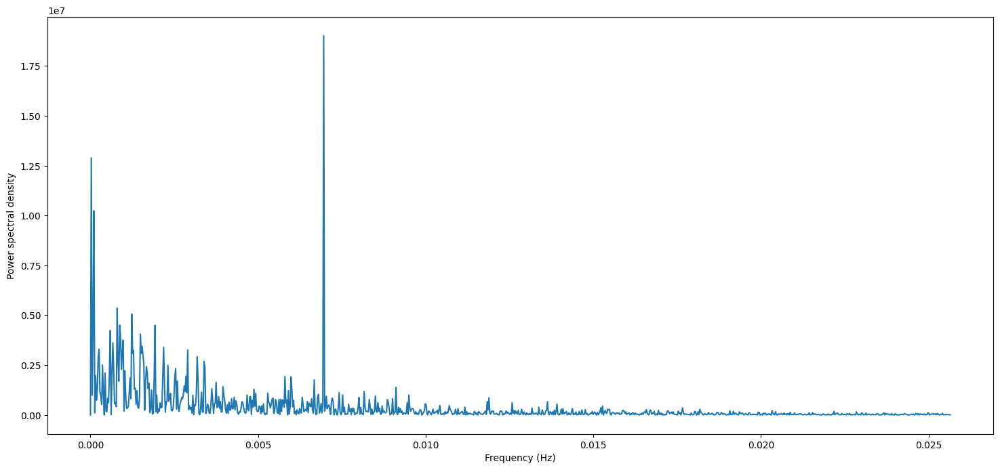

In [ ]:
# Código retirado de https://medium.com/mlearning-ai/three-ways-to-find-the-period-of-a-timeseries-251a6c8c4a3e
plt.figure(figsize=(18,8))
from scipy.signal import periodogram

freq, power = periodogram(X_train_general['valor_leitura_flu_413(t-0)'].values)
period = 1/freq[np.argmax(power)]
second_period = 1/freq[np.argsort(power)[-2]]
third_period = 1/freq[np.argsort(power)[-3]]
fourth_period = 1/freq[np.argsort(power)[-4]]
print(f"The period of the time series is {period}")
print(f"The second period of the time series is {second_period}")
print(f"The third period of the time series is {third_period}")
print(f"The fourth period of the time series is {fourth_period}")
plt.plot(freq[0:1000], power[0:1000])
plt.xlabel('Frequency (Hz)')
plt.ylabel('Power spectral density')
plt.show()

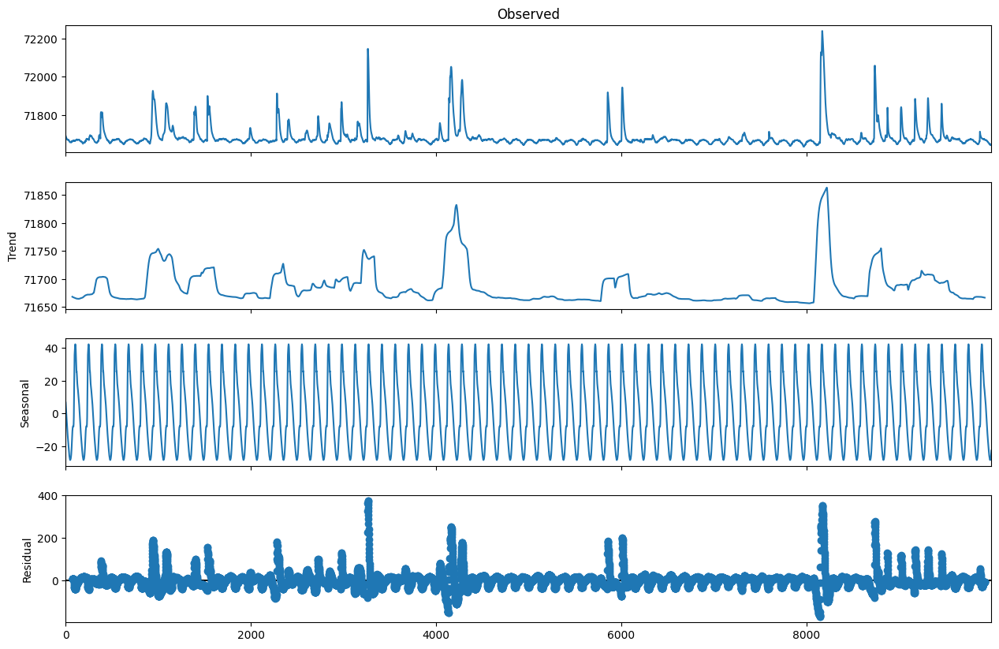

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose
series = X_train_general['valor_leitura_flu_413(t-0)'].values[0:10000]
result = seasonal_decompose(series, model='additive',period=144)
fig = result.plot()
fig.set_size_inches((14, 9))
plt.show()

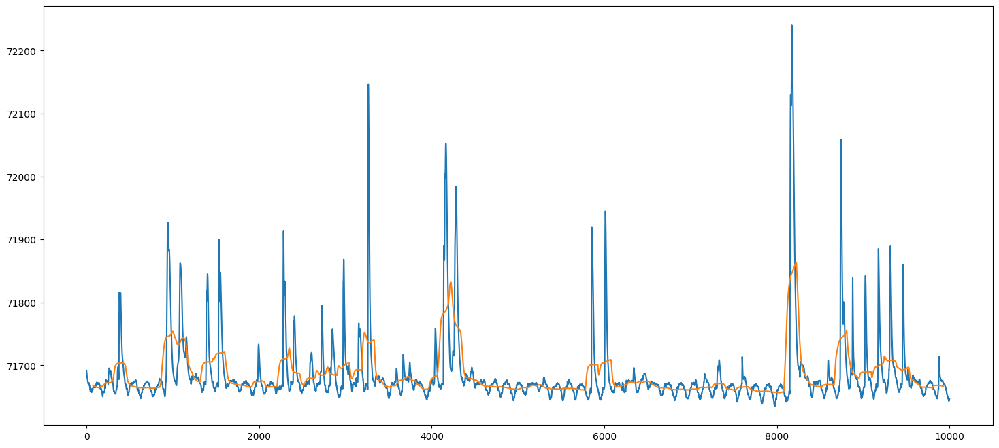

In [ ]:
plt.figure(figsize=(18,8))
plt.plot(series)
plt.plot(result.trend)

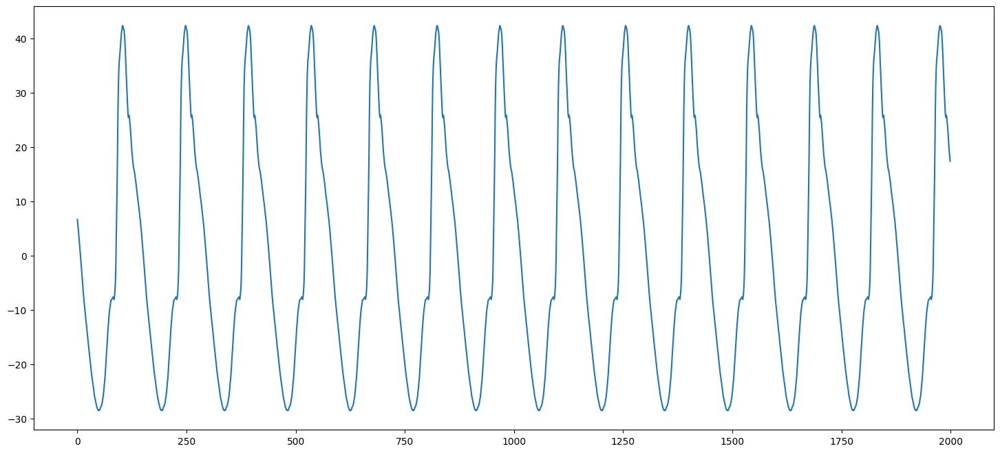

In [ ]:
plt.figure(figsize=(18,8))
plt.plot(result.seasonal[0:2000])

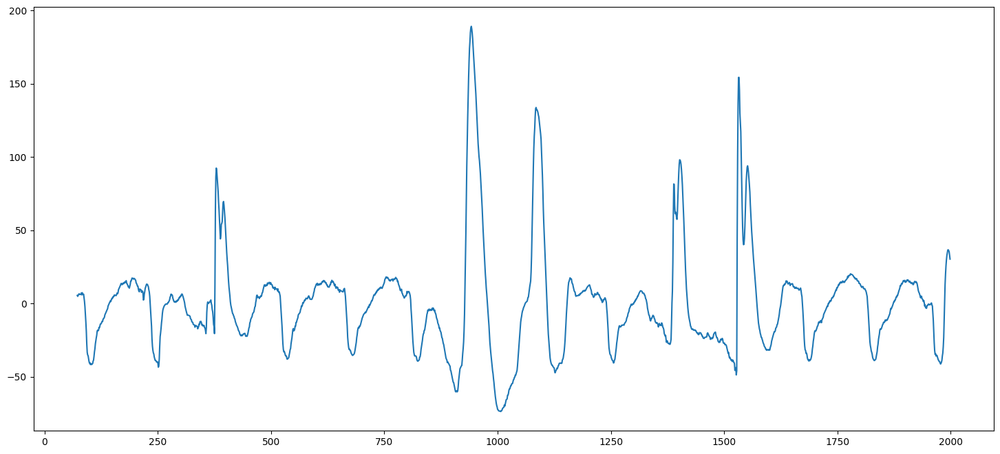

In [ ]:
plt.figure(figsize=(18,8))
plt.plot(result.resid[0:2000])

In [ ]:
series = X_train_general['valor_leitura_flu_413(t-0)']

In [ ]:
series.index = pd.to_datetime(series.index)

In [ ]:
df_2018['valor_leitura_flu_413'].describe()

count    12960.000000
mean     71690.783604
std         70.100866
min      71635.195000
25%      71662.500000
50%      71671.000000
75%      71683.100000
max      72240.100000
Name: valor_leitura_flu_413, dtype: float64

In [ ]:
df_2019['valor_leitura_flu_413'].describe()

count    12960.000000
mean     71724.751290
std        116.677361
min      71637.300000
25%      71668.000000
50%      71681.600000
75%      71719.600000
max      72451.000000
Name: valor_leitura_flu_413, dtype: float64

In [ ]:
df_2020['valor_leitura_flu_413'].describe()

count    13104.000000
mean     71708.343311
std        102.176335
min      71635.305000
25%      71662.410000
50%      71672.400000
75%      71702.680000
max      72414.100000
Name: valor_leitura_flu_413, dtype: float64

In [ ]:
series_2018 = df_2018['valor_leitura_flu_413']
series_2018.index = df_2018['intervalo']
series_2018.index = pd.to_datetime(series_2018.index)

series_2019 = df_2019['valor_leitura_flu_413']
series_2019.index = df_2019['intervalo']
series_2019.index = pd.to_datetime(series_2019.index)

series_2020 = df_2020['valor_leitura_flu_413']
series_2020.index = df_2020['intervalo']
series_2020.index = pd.to_datetime(series_2020.index)

series = pd.concat([series_2018,series_2019,series_2020])

[Text(0.5, 0, 'Year'), Text(0, 0.5, 'River level (cm)')]

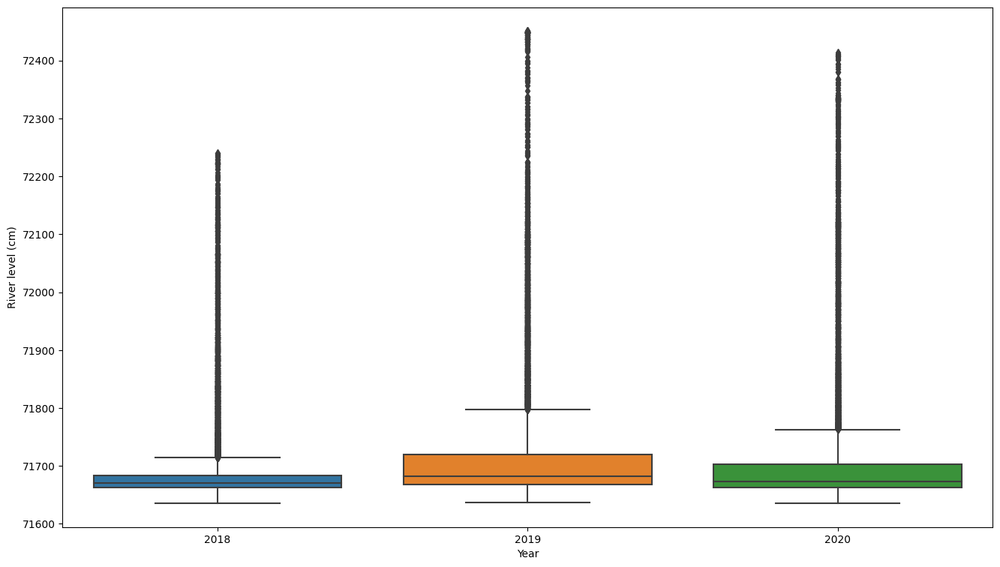

In [ ]:
fig, ax = plt.subplots(figsize=(16,9))
seaborn.boxplot(x = series.index.year,y = series, ax = ax).set(xlabel='Year', ylabel='River level (cm)')

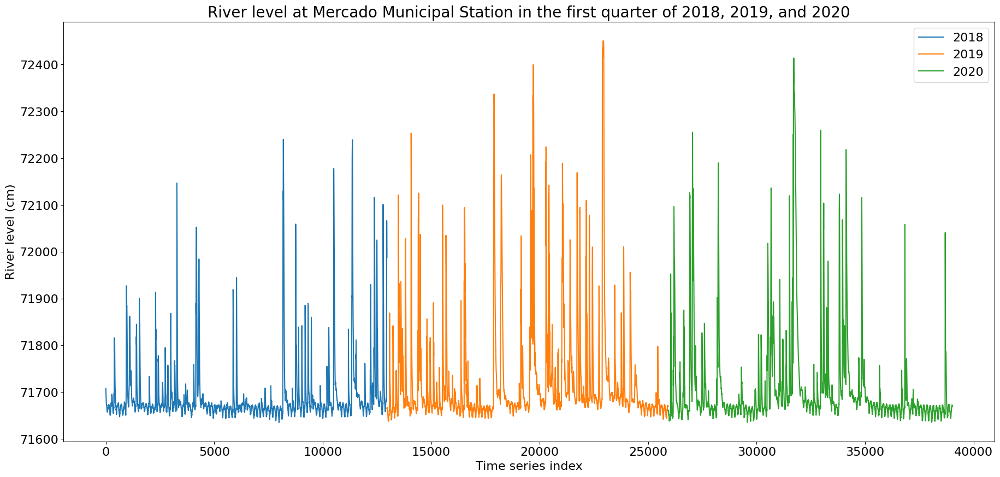

In [ ]:
plt.figure(figsize=(22,10))
plt.plot(range(12960),series[0:12960].values,label='2018')
plt.plot(range(12960,25920),series[12960:25920].values,label='2019')
plt.plot(range(25920,39024),series[25920:].values,label='2020')
plt.xlabel('Time series index',fontsize=16)
plt.ylabel("River level (cm)",fontsize=16)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.title("River level at Mercado Municipal Station in the first quarter of 2018, 2019, and 2020", fontsize=20)
plt.legend(fontsize=16)

In [ ]:
len(series)

39024

In [ ]:
df_181920 = series.to_frame()
df_181920['year'] = series.index.year
df_181920.rename(columns={"valor_leitura_flu_413": "River level (cm)"},inplace=True)

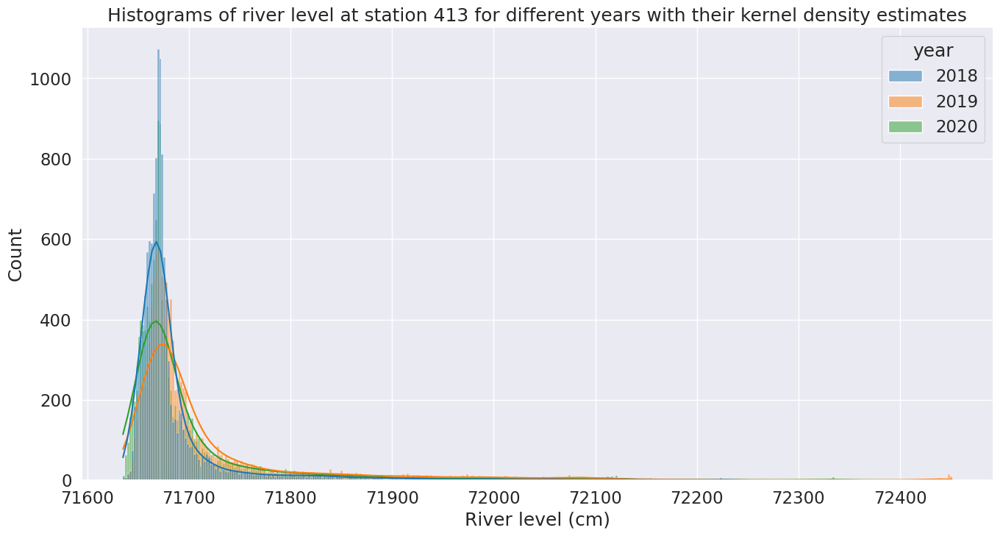

In [ ]:
plt.figure(figsize = (16,8))
seaborn.set(font_scale=1.5)
histplot = seaborn.histplot(data=df_181920,x='River level (cm)', palette = 'tab10', hue = 'year', kde=True).set(title = 'Histograms of river level at station 413 for different years with their kernel density estimates')

[Text(0.5, 1.0, 'Distributions of river level at station 413 for different years')]

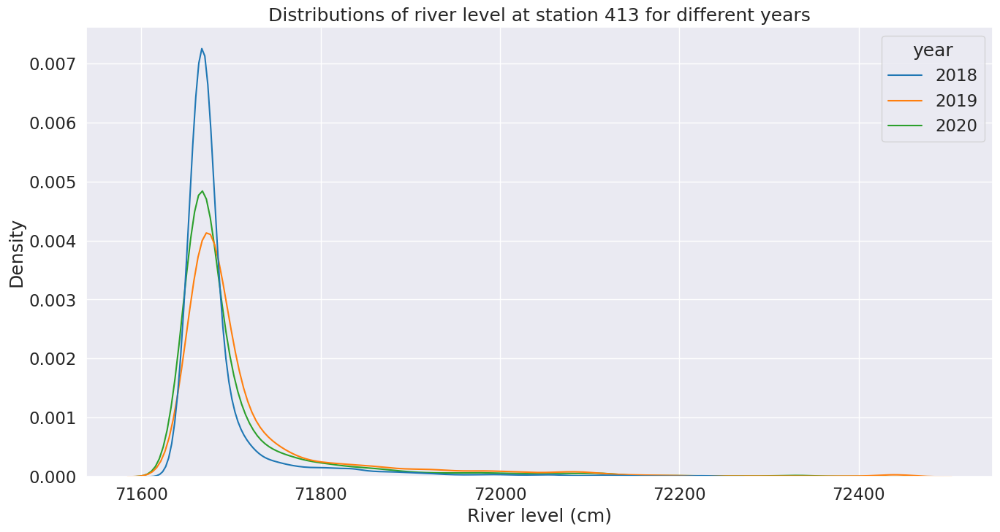

In [ ]:
plt.figure(figsize = (16,8))
seaborn.set(font_scale=1.5)
seaborn.kdeplot(data=df_181920,x='River level (cm)',palette = 'tab10', hue = 'year').set(title = 'Distributions of river level at station 413 for different years')

<Axes: xlabel='valor_leitura_flu_413', ylabel='Count'>

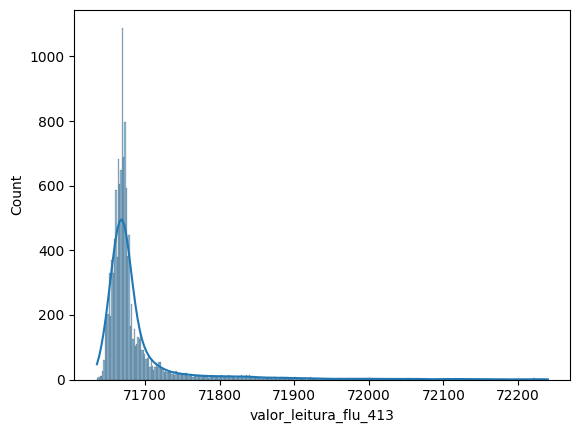

In [ ]:
seaborn.histplot(data=df_2018, x="valor_leitura_flu_413", kde=True)

Test for normality

In [ ]:
#perform Kolmogorov-Smirnov test
from scipy.stats import kstest
statistic, p_value = kstest(series_2018, 'norm')
if(p_value<0.05):
  print(f'Há evidência para rejeitar a hipótese nula, pois o p-value é {p_value}, ou seja, a distribuição não é normal')
else:
  print(f'Não há evidência para rejeitar a hipótese nula, pois o p-value é {p_value}, ou seja, a distribuição é normal')

Há evidência para rejeitar a hipótese nula, pois o p-value é 0.0, ou seja, a distribuição não é normal


In [ ]:
#perform Kolmogorov-Smirnov test
from scipy.stats import kstest
statistic, p_value = kstest(series_2019, 'norm')
if(p_value<0.05):
  print(f'Há evidência para rejeitar a hipótese nula, pois o p-value é {p_value}, ou seja, a distribuição não é normal')
else:
  print(f'Não há evidência para rejeitar a hipótese nula, pois o p-value é {p_value}, ou seja, a distribuição é normal')

Há evidência para rejeitar a hipótese nula, pois o p-value é 0.0, ou seja, a distribuição não é normal


In [ ]:
#perform Kolmogorov-Smirnov test
from scipy.stats import kstest
statistic, p_value = kstest(series_2020, 'norm')
if(p_value<0.05):
  print(f'Há evidência para rejeitar a hipótese nula, pois o p-value é {p_value}, ou seja, a distribuição não é normal')
else:
  print(f'Não há evidência para rejeitar a hipótese nula, pois o p-value é {p_value}, ou seja, a distribuição é normal')

Há evidência para rejeitar a hipótese nula, pois o p-value é 0.0, ou seja, a distribuição não é normal


In [ ]:
from scipy.stats import ks_2samp
statistic, p_value = kstest(series_2018, series_2019)

if(p_value<0.05):
  print(f'Há evidência para rejeitar a hipótese nula, pois o p-value é {p_value}, ou seja, os dados não vieram da mesma distribuição')
else:
  print(f'Não há evidência para rejeitar a hipótese nula, pois o p-value é {p_value}, ou seja, os dados vieram da mesma distribuição')

Há evidência para rejeitar a hipótese nula, pois o p-value é 0.0, ou seja, os dados vieram da mesma distribuição


In [ ]:
from scipy.stats import ks_2samp
statistic, p_value = kstest(series_2019, series_2020)

if(p_value<0.05):
  print(f'Há evidência para rejeitar a hipótese nula, pois o p-value é {p_value}, ou seja, os dados não vieram da mesma distribuição')
else:
  print(f'Não há evidência para rejeitar a hipótese nula, pois o p-value é {p_value}, ou seja, os dados vieram da mesma distribuição')

Há evidência para rejeitar a hipótese nula, pois o p-value é 8.818799956889947e-163, ou seja, os dados vieram da mesma distribuição


In [ ]:
from scipy.stats import ks_2samp
statistic, p_value = kstest(series_2018, series_2020)

if(p_value<0.05):
  print(f'Há evidência para rejeitar a hipótese nula, pois o p-value é {p_value}, ou seja, os dados não vieram da mesma distribuição')
else:
  print(f'Não há evidência para rejeitar a hipótese nula, pois o p-value é {p_value}, ou seja, os dados vieram da mesma distribuição')

Há evidência para rejeitar a hipótese nula, pois o p-value é 7.487556401499536e-74, ou seja, os dados vieram da mesma distribuição


In [ ]:
lags = X_train_general[['valor_leitura_flu_413(t-0)','valor_leitura_flu_413(t-1)','valor_leitura_flu_413(t-2)','valor_leitura_flu_413(t-3)','valor_leitura_flu_413(t-4)','valor_leitura_flu_413(t-5)','valor_leitura_flu_413(t-6)','valor_leitura_flu_413(t-7)','valor_leitura_flu_413(t-8)','valor_leitura_flu_413(t-9)','valor_leitura_flu_413(t-10)','valor_leitura_flu_413(t-11)']]
lags.columns = ['lag_0', 'lag_1','lag_2','lag_3','lag_4','lag_5','lag_6','lag_7','lag_8','lag_9','lag_10','lag_11']
lags

,lag_0,lag_1,lag_2,lag_3,lag_4,lag_5,lag_6,lag_7,lag_8,lag_9,lag_10,lag_11
intervalo,,,,,,,,,,,,
2018-01-01 04:00:00 UTC,71691.600,71692.600,71693.700,71695.400,71695.900,71697.600,71699.200,71700.300,71702.0,71703.695,71705.200,71707.500
2018-01-01 04:10:00 UTC,71690.400,71691.600,71692.600,71693.700,71695.400,71695.900,71697.600,71699.200,71700.3,71702.000,71703.695,71705.200
2018-01-01 04:20:00 UTC,71688.800,71690.400,71691.600,71692.600,71693.700,71695.400,71695.900,71697.600,71699.2,71700.300,71702.000,71703.695
2018-01-01 04:30:00 UTC,71687.200,71688.800,71690.400,71691.600,71692.600,71693.700,71695.400,71695.900,71697.6,71699.200,71700.300,71702.000
2018-01-01 04:40:00 UTC,71685.500,71687.200,71688.800,71690.400,71691.600,71692.600,71693.700,71695.400,71695.9,71697.600,71699.200,71700.300
...,...,...,...,...,...,...,...,...,...,...,...,...
2020-04-01 00:20:00 UTC,71672.400,71670.100,71671.195,71671.195,71670.100,71670.100,71669.000,71669.000,71669.0,71669.000,71667.900,71667.900
2020-04-01 00:30:00 UTC,71671.195,71672.400,71670.100,71671.195,71671.195,71670.100,71670.100,71669.000,71669.0,71669.000,71669.000,71667.900
2020-04-01 00:40:00 UTC,71671.195,71671.195,71672.400,71670.100,71671.195,71671.195,71670.100,71670.100,71669.0,71669.000,71669.000,71669.000


Text(0.5, 1.0, 'Correlation matrix for 12 lags of river level time series at station 413')

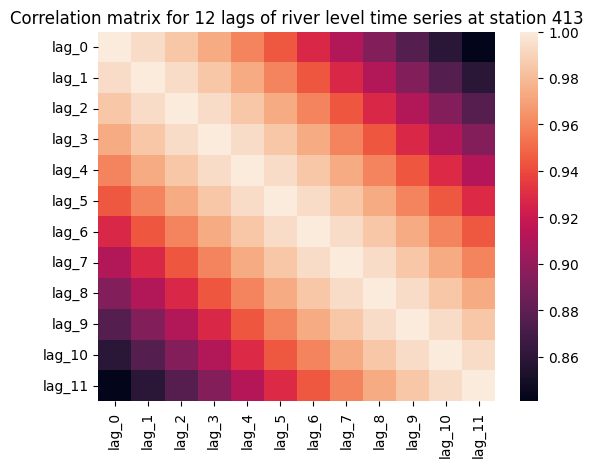

In [ ]:
#correlation_matrix = X_train_general[['valor_leitura_flu_413(t-0)','valor_leitura_flu_413(t-1)','valor_leitura_flu_413(t-2)','valor_leitura_flu_413(t-3)','valor_leitura_flu_413(t-4)','valor_leitura_flu_413(t-5)','valor_leitura_flu_413(t-6)','valor_leitura_flu_413(t-7)','valor_leitura_flu_413(t-8)','valor_leitura_flu_413(t-9)','valor_leitura_flu_413(t-10)','valor_leitura_flu_413(t-11)']].corr(method='pearson')
#correlation_matrix = lags.corr(method='pearson')
plt.rcParams['font.size'] = 10
seaborn.heatmap(lags.corr(method='pearson')).set_title('Correlation matrix for 12 lags of river level time series at station 413')

In [ ]:
X_train_general

,valor_leitura_flu_413(t-11),valor_leitura_flu_413(t-10),valor_leitura_flu_413(t-9),valor_leitura_flu_413(t-8),valor_leitura_flu_413(t-7),valor_leitura_flu_413(t-6),valor_leitura_flu_413(t-5),valor_leitura_flu_413(t-4),valor_leitura_flu_413(t-3),valor_leitura_flu_413(t-2),...,valor_leitura_plu_1000868(t-9),valor_leitura_plu_1000868(t-8),valor_leitura_plu_1000868(t-7),valor_leitura_plu_1000868(t-6),valor_leitura_plu_1000868(t-5),valor_leitura_plu_1000868(t-4),valor_leitura_plu_1000868(t-3),valor_leitura_plu_1000868(t-2),valor_leitura_plu_1000868(t-1),valor_leitura_plu_1000868(t-0)
intervalo,,,,,,,,,,,,,,,,,,,,,
2018-01-01 04:00:00 UTC,71707.500,71705.200,71703.695,71702.0,71700.300,71699.200,71697.600,71695.900,71695.400,71693.700,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2018-01-01 04:10:00 UTC,71705.200,71703.695,71702.000,71700.3,71699.200,71697.600,71695.900,71695.400,71693.700,71692.600,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2018-01-01 04:20:00 UTC,71703.695,71702.000,71700.300,71699.2,71697.600,71695.900,71695.400,71693.700,71692.600,71691.600,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2018-01-01 04:30:00 UTC,71702.000,71700.300,71699.200,71697.6,71695.900,71695.400,71693.700,71692.600,71691.600,71690.400,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2018-01-01 04:40:00 UTC,71700.300,71699.200,71697.600,71695.9,71695.400,71693.700,71692.600,71691.600,71690.400,71688.800,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-04-01 00:20:00 UTC,71667.900,71667.900,71669.000,71669.0,71669.000,71669.000,71670.100,71670.100,71671.195,71671.195,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2020-04-01 00:30:00 UTC,71667.900,71669.000,71669.000,71669.0,71669.000,71670.100,71670.100,71671.195,71671.195,71670.100,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2020-04-01 00:40:00 UTC,71669.000,71669.000,71669.000,71669.0,71670.100,71670.100,71671.195,71671.195,71670.100,71672.400,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


# Parte 7: Baselines

## Experimentos Markovianos (Validando em 2020)

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023])
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df)

### Exp. 5

In [ ]:
entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)


X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values)
y_val = np.array(y_val_general.values)
y_test = np.array(y_test_general.values)

#### Persistência

In [ ]:
from sklearn.metrics import mean_squared_error as mse
predictions = X_val[:,0].reshape(-1,1)
mse = mse(predictions, y_val)
rmse = np.sqrt(mse)
nse = he.evaluator(he.nse, predictions, y_val)
nse[0]

0.6888115542677542

#### Multiple Linear Regression

In [ ]:
from sklearn import linear_model
regr = linear_model.LinearRegression()
regr.fit(X_train, y_train)
from sklearn.metrics import mean_squared_error as mse
predictions = regr.predict(X_val)
mse = mse(predictions, y_val)
rmse = np.sqrt(mse)
nse = he.evaluator(he.nse, predictions, y_val)
nse[0]

0.8088533214310435

## Experimentos Markovianos (Testando em 21/22)

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019,df_2020], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023])
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df)

### Exp. 5

In [ ]:
entradas = []
entradas.append('valor_leitura_flu_413(t-0)')
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome and '-0' in nome):
    entradas.append(nome)


X_train = np.array(X_train_general[entradas])
X_val = np.array(X_val_general[entradas])
X_test = np.array(X_test_general[entradas])
y_train = np.array(y_train_general.values)
y_val = np.array(y_val_general.values)
y_test = np.array(y_test_general.values)


#### Persistência

In [ ]:
from sklearn.metrics import mean_squared_error as mse
predictions = X_val[:,0].reshape(-1,1)
mse = mse(predictions, y_val)
rmse = np.sqrt(mse)
nse = he.evaluator(he.nse, predictions, y_val)
nse[0]

0.5095202095744662

#### Multiple Linear Regression

In [ ]:
from sklearn import linear_model
regr = linear_model.LinearRegression()
regr.fit(X_train, y_train)
from sklearn.metrics import mean_squared_error as mse
predictions = regr.predict(X_val)
mse = mse(predictions, y_val)
rmse = np.sqrt(mse)
nse = he.evaluator(he.nse, predictions, y_val)
nse[0]

0.6847315661903922

## Experimentos com Lags (Validando em 2020)

### Exp. 5

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019], dataframes_validacao = [df_2020], dataframes_teste = [df_2023])
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

#### Multiple Linear Regression

In [ ]:
from sklearn import linear_model
regr = linear_model.LinearRegression()
regr.fit(X_train, y_train)
from sklearn.metrics import mean_squared_error as mse
predictions = regr.predict(X_val)
mse = mse(predictions, y_val)
rmse = np.sqrt(mse)
nse = he.evaluator(he.nse, predictions, y_val)
nse[0]

0.8328751896170701

## Experimentos com lags (Testando em 21/22)

In [ ]:
train_df, val_df, test_df = preparar_dataframes(dataframes_treinamento = [df_2018, df_2019,df_2020], dataframes_validacao = [df_2021.drop(df_2021.index[3000:4000]), df_2022], dataframes_teste = [df_2023])
X_train_general,y_train_general,X_val_general,y_val_general,X_test_general,y_test_general = gerar_conjuntos(train_df,val_df,test_df)

entradas = []
X_train_general.columns
for nome in X_train_general.columns:
  if ('plu' in nome) or ('valor_leitura_flu_413' in nome):
    entradas.append(nome)

X_train_general = X_train_general[entradas]
X_val_general = X_val_general[entradas]
X_test_general = X_test_general[entradas]

X_train = np.array(X_train_general)
X_val = np.array(X_val_general)
X_test = np.array(X_test_general)
y_train = np.array(y_train_general.values).ravel()
y_val = np.array(y_val_general.values).ravel()
y_test = np.array(y_test_general.values).ravel()

#### Multiple Linear Regression

In [ ]:
from sklearn import linear_model
regr = linear_model.LinearRegression()
regr.fit(X_train, y_train)
from sklearn.metrics import mean_squared_error as mse
predictions = regr.predict(X_val)
mse = mse(predictions, y_val)
rmse = np.sqrt(mse)
nse = he.evaluator(he.nse, predictions, y_val)
nse[0]

0.7313867105937069